# Model Definitions

In [2]:
import os
import time
import math
import pickle 
import warnings
warnings.filterwarnings('ignore')

try: import cupy as np; _ = np.array([0]);
except: import numpy as np
import pandas as pd
import multiprocessing as mp

import matplotlib
from matplotlib import cm
from matplotlib import pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import ListedColormap, Normalize
from matplotlib.patches import FancyArrow, RegularPolygon, Polygon
from matplotlib.animation import FuncAnimation
from matplotlib.collections import LineCollection,PatchCollection
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

from glob import glob
from copy import deepcopy
from scipy.stats import pearsonr, linregress, iqr, ranksums
from scipy.stats import ttest_ind as ttest
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture as GMM
from tqdm.notebook import tqdm
from datetime import datetime

species_dict = {
    'V_total' : ['Xf V', 'Xb iV', 'Zb CF_CV', 'Zb CF_CVP'],
    'Vp_total' : ['Xf Vp', 'Xb iVp', 'Zb CF_CVp', 'Zb CF_CVpP'],
    'V_Vp_total' : ['Xf V', 'Xb iV', 'Zb CF_CV', 'Zb CF_CVP'] + ['Xf Vp', 'Xb iVp', 'Zb CF_CVp', 'Zb CF_CVpP'],
    
    'D_total' : ['Xf D', 'Xf FD', 'Xb cF_D'],
    'Dp_total' : ['Xf Dp', 'Xf FDpDp', 'Xf FDpDp', 'Xb cF_Dp', 'Xb cF_DpDp', 'Xb cF_DpDp'],
    'D_Dp_total' : ['Xf D', 'Xf FD', 'Xb cF_D'] + ['Xf Dp', 'Xf DpDp', 'Xf FDpDp', 'Xb cF_Dp','Xb cF_DpDp', 'Xb cF_DpDp'],

    'F_total' : ['Xf F','Xf FD', 'Xf FDp', 'Xf FDpDp', 'Xb CF_C', 'Xb CF_CV', 'Xb CF_CVP', 'Xb CF_CVp', 'Xb CF_CVpP'],
    'P_total' : ['Xf P', 'Xf VP', 'Xf VpP', 'Xf DP', 'Xf FDP', 'Xb cD_P', 'Zb CF_CVP', 'Zb CF_CVpP'],
    'A_total' : ['Xf A', 'Xf fDp_A', 'Xf DA', 'Xf FDA', 'Xf bDp_A', 'Xb cD_A', 'Xb cDp_A'],

    'V_Vp_complex' : ['Xb iV', 'Zb CF_CV', 'Zb CF_CVP', 'Xb iVp', 'Zb CF_CVp', 'Zb CF_CVpP'],
    'D_Dp_complex' : ['Xb cF_D', 'Xb cF_Dp','Xb cF_DpDp', 'Xb cF_DpDp'],

    'F_complex' : ['Xb CF_CV', 'Xb CF_CVP', 'Xb CF_CVp', 'Xb CF_CVpP'],
    'P_complex' : ['Xb cD_P', 'Zb CF_CVP', 'Zb CF_CVpP'],
    'A_complex' : ['Xf bDp_A', 'Xb cD_A', 'Xb cDp_A']}

########################
### SHARED FUNCTIONS ###
########################
def establish_global_variables():
    #############################
    ### SPECIES-LAYER ALIASES ###
    #############################
    global Xc_species, Xf_species, Xb_species, Xp_params
    Xc_species = ['P','A','D','Dp'] #Cytoplasmic species
    Xf_species = ['P','A','D','Dp','DpDp','fDp_A','C','F','V','VP','Vp','VpP','DA','DP','FD','FDA','FDP','FDp','FDpDp','bDp_A'] #Free membrane species
    Xb_species = ['iV','iVp','C_C','CF_C','CF_CV','CF_CVP','CF_CVp','CF_CVpP','cF_D','cF_Dp','cF_DpDp','cD_A','cD_P','cDp_A'] #Bound membrane species

    global P,A,D,Dp,DpDp,fDp_A,C,F,V,VP,Vp,VpP,DA,DP,FD,FDA,FDP,FDp,FDpDp,bDp_A
    P,A,D,Dp,DpDp,fDp_A,C,F,V,VP,Vp,VpP,DA,DP,FD,FDA,FDP,FDp,FDpDp,bDp_A = range(0,20) #20

    global iV, iVp, C_C, CF_C, CF_CV, CF_CVP, CF_CVp, CF_CVpP, cF_D, cF_Dp, cF_DpDp, cD_A, cD_P, cDp_A
    iV, iVp, C_C, CF_C, CF_CV, CF_CVP, CF_CVp, CF_CVpP, cF_D, cF_Dp, cF_DpDp, cD_A, cD_P, cDp_A = range(0,14) #14

    ###########################
    ### PARAM-LAYER ALIASES ###
    ###########################

    #Synthesis rates
    global sD,sA,sP,sV,sF,sC
    Xp_params = ['sD','sA','sP','sV','sF','sC']
    sD,sA,sP,sV,sF,sC = range(0,6) #6

    #Degredation rates
    global dD,dA,dP,dC,dV,dVP,dVp,dVpP,dF,dFDP,k9a,k9b,k9c
    Xp_params += ['dD','dA','dP','dC','dV','dVP','dVp','dVpP','dF','dFDP','k9a','k9b','k9c']
    dD,dA,dP,dC,dV,dVP,dVp,dVpP,dF,dFDP,k9a,k9b,k9c = range(6,19) #13

    #Membrane association and dissociation for cytoplasmic species
    global D_on,D_off,DP_off,Dp_on,Dp_off,DpDp_off,A_on,A_off,P_on,P_off,PV_on,DV_on
    Xp_params += ['D_on','D_off','DP_off','Dp_on','Dp_off','DpDp_off','A_on','A_off','P_on','P_off','PV_on','DV_on']
    D_on,D_off,DP_off,Dp_on,Dp_off,DpDp_off,A_on,A_off,P_on,P_off,PV_on,DV_on = range(19,31) #12

    #Core complex (C_C and CF_C) formation
    global k1,k2,k3,k4a,k4b,k4c,k4d
    Xp_params += ['k1','k2','k3','k4a','k4b','k4c','k4d']
    k1,k2,k3,k4a,k4b,k4c,k4d = range(31,38) #7

    #VANGL association and dissociation from CELSR/FZD
    global k5,k6,k7min,k7m,k7max,k8min,k8m,k8max
    Xp_params += ['k5','k6','k7min','k7m','k7max','k8min','k8m','k8max']
    k5,k6,k7min,k7m,k7max,k8min,k8m,k8max = range(38,46) #8

    #ANKRD association and dissociation from DVL
    global k10,k11,k12,k13
    Xp_params += ['k10','k11','k12','k13']
    k10,k11,k12,k13 = range(46,50) #4

    #PK association and dissociation rates from DVL and VANGL
    global k14,k15,k16,k17,k18,k19
    Xp_params += ['k14','k15','k16','k17','k18','k19']
    k14,k15,k16,k17,k18,k19 = range(50,56) #6

    #DVL phosphorylation and dimerization
    global k20,k21,k22a,k22b,kcat_Dp,kcat_VDp,km_VDp
    Xp_params += ['k20','k21','k22a','k22b','kcat_Dp','kcat_VDp','km_VDp']
    k20,k21,k22a,k22b,kcat_Dp,kcat_VDp,km_VDp = range(56,63) #7

    #VANGL phosphorylation and immobilization rates
    global k23,k24a,k24b,k27a,k27b,kcat_Vp,km_Vp
    Xp_params += ['k23','k24a','k24b','k27a','k27b','kcat_Vp','km_Vp']
    k23,k24a,k24b,k27a,k27b,kcat_Vp,km_Vp = range(63,70) #7

    #DVL association and dissociation from FZD
    global k25a,k25b,k25c,k26a,k26b,k26c
    Xp_params += ['k25a','k25b','k25c','k26a','k26b','k26c']
    k25a,k25b,k25c,k26a,k26b,k26c = range(70,76) #6

def datestring():
    today = datetime.now()
    month = f"0{today.month}" if today.month < 10 else f"{today.month}"
    day = f"0{today.day}" if today.day < 10 else f"{today.day}"
    hour = f"0{today.hour}" if today.hour < 10 else f"{today.hour}"
    minute = f"0{today.minute}" if today.minute < 10 else f"{today.minute}"
    second = f"0{today.second}" if today.second < 10 else f"{today.second}"
    datestring = f"{today.year}-{month}-{day} {hour}:{minute}:{second}"
    return datestring

def plen(obj):   print(len(obj))
def pshape(obj): print(obj.shape)
def ptype(obj):  print(type(obj))
    
def ode_v8(clss):
    def ode_step(self):
        '''
        Iterates the model forward one step using the Euler method.
        Takes no parameters, obtains parameters and species concentrations from object properties of self. 
        '''    
        #Build empty output arrays
        dXc  = np.zeros(self.Xc.shape)
        dXf = np.zeros(self.Xf.shape)
        dXb = np.zeros(self.Xb.shape)

        #Make soft references to all current species concentrations and parameters
        Xc = self.Xc
        Xf = self.Xf
        Xb = self.Xb
        Xp = self.Xp

        #Get concentrations of free species on the opposing membrane
        Zf,Zb,Zp = self._get_opposing_membranes()

        
        #################################
        ### INTERMEDIATE CALCULATIONS ###
        #################################
        fDp_total = Xf[Dp] + (2*Xf[DpDp]) # Total membrane-associated Dp not bound to FZD
        fDp_x = fDp_total - Xf[fDp_A] # Free-Dp binding-nothing
        r_fDp_A = Xf[fDp_A] / fDp_total # Ratio free-Dp binding-A
        r_fDp_x = fDp_x / fDp_total # Ratio free-Dp binding-nothing
        
        bDp_total = Xf[FDp] + (2*Xf[FDpDp]) # Total membrane-associated Dp bound to free FZD
        bDp_x = bDp_total - Xf[bDp_A] # FZD-bound-Dp binding-nothing
        r_bDp_A = Xf[bDp_A] / bDp_total # Ratio bound-Dp binding-A
        r_bDp_x = bDp_x / bDp_total # Ratio bound-Dp binding-nothing

        cDp_total = Xb[cF_Dp] + (2*Xb[cF_DpDp])# Total complexed Dp
        cDp_x = cDp_total - Xb[cDp_A] # CELSR-complexed-Dp binding-nothing
        r_cDp_A = Xb[cDp_A] / cDp_total # Ratio of complexed-pDVL binding-A
        r_cDp_x = cDp_x / cDp_total # Ratio of complexed-pDVL binding-nothing
        
        fD_total = Xf[D] + Xf[DP] + Xf[DA] # Total membrane-associated DVL not bound to FZD
        bFD_total = Xf[FD] + Xf[FDP] + Xf[FDA] # Total FZD with bound DVL not in complex
        cVP_total = Zb[CF_CVP] + Zb[CF_CVpP] #Total PK bound to complexed VANGL
        iV_total = Xb[iV] + Xb[iVp]
        Z_iV_total = Zb[iV] + Zb[iVp]
        
        cD_x = Xb[cF_D] - Xb[cD_A] - Xb[cD_P] # Complexed-DVL binding-nothing       
        r_cD_x = cD_x / Xb[cF_D] # Ratio of complexed-DVL binding-nothing
        r_cD_A = Xb[cD_A] / Xb[cF_D] # Ratio of complexed-DVL binding-A
        r_cD_P = Xb[cD_P] / Xb[cF_D] # Ratio of complexed-DVL binding-P
        
        fV_total = Xf[V] + Xf[Vp] #NEW - total free VANGL capable of recruiting cytoplasmic species
        fF_total = Xf[F] + Xf[FD] + Xf[FDP] + Xf[FDA] + Xf[FDp] + Xf[FDpDp] # Total non-complexed FZD in cell X
        cF_total = Xb[CF_C] + Xb[CF_CV] + Xb[CF_CVp] + Xb[CF_CVP] + Xb[CF_CVpP] # Total FZD in complex with CELSR in cell X
        
        cF_x = cF_total - Xb[cF_D] - Xb[cF_Dp] - Xb[cF_DpDp] #Total complexed-FZD without DVL bound in cell X     
        r_cF_x = cF_x / cF_total # Ratio of complexed-FZD without DVL bound in cell X
        r_cF_D = Xb[cF_D] / cF_total # Ratio of complexed-FZD with DVL bound in cell X
        r_cF_Dp = Xb[cF_Dp] / cF_total # Ratio of complexed-FZD with pDVL bound in cell X
        r_cF_DpDp   = Xb[cF_DpDp] / cF_total # Ratio of complexed-FZD with DpDp bound in cell X
        
        Z_fF_total = Zf[F] + Zf[FD] + Zf[FDP] + Zf[FDA] + Zf[FDp] + Zf[FDpDp] # Total non-complexed FZD in cell Z
        Z_cF_total = Zb[CF_C] + Zb[CF_CV] + Zb[CF_CVp] + Zb[CF_CVP] + Zb[CF_CVpP] # Total FZD in complex with CELSR in cell Z
        Z_cF_x = Z_cF_total - Zb[cF_D] - Zb[cF_Dp] - Zb[cF_DpDp] # Total complexed-FZD without DVL bound in cell Z
        Zr_cF_x = np.where(Z_cF_total==0, 0, np.divide(Z_cF_x, Z_cF_total, out=np.zeros_like(Z_cF_total))) # Ratio of complexed-FZD without DVL bound in cell Z
        Zr_cF_D = np.where(Z_cF_total==0, 0, np.divide(Zb[cF_D], Z_cF_total, out=np.zeros_like(Z_cF_total))) # Ratio of complexed-FZD with DVL bound in cell Z
        Zr_cF_Dp = np.where(Z_cF_total==0, 0, np.divide(Zb[cF_Dp], Z_cF_total, out=np.zeros_like(Z_cF_total))) # Ratio of complexed-FZD with pDVL bound in cell Z
        Zr_cF_DpDp = np.where(Z_cF_total==0, 0, np.divide(Zb[cF_DpDp], Z_cF_total, out=np.zeros_like(Z_cF_total))) # Ratio of complexed-FZD with DpDp bound in cell Z
        
        
        ##############################
        ### DIFFERENTIAL EQUATIONS ###
        ##############################
        ### Cytoplasmic Species (species, cell, model) ###
        dXc[D] = Xp[sD,:,0] - (Xc[D]*Xp[dD,:,0]) - (Xc[D,:,None,:]*Xp[D_on]).sum(axis=1) + (Xf[D]*Xp[D_off]).sum(axis=1) + (Xc[Dp]*Xp[k22a,:,0])+ (Xf[DA]*Xp[D_off]).sum(axis=1)  + (Xf[DP]*Xp[DP_off]).sum(axis=1)  + (Xf[FD]*Xp[dF]).sum(axis=1)  + (Xf[FDA]*Xp[dF]).sum(axis=1)  + (Xf[FDP]*Xp[dFDP]).sum(axis=1) - (Xc[D,:,None,:]*fV_total*Xp[DV_on]).sum(axis=1)
        dXc[A] = Xp[sA,:,0] - (Xc[A]*Xp[dA,:,0]) - (Xc[A,:,None,:]*Xp[A_on]).sum(axis=1) + (Xf[A]*Xp[A_off]).sum(axis=1) + ((Xf[Dp]*r_fDp_A)*Xp[Dp_off]).sum(axis=1)  + ((2*Xf[DpDp]*r_fDp_A)*(Xp[DpDp_off]/2)).sum(axis=1)  + (Xf[DA]*Xp[D_off]).sum(axis=1)  + (Xf[FDA]*Xp[dF]).sum(axis=1)  + ((Xf[FDp]*r_bDp_A)*Xp[dF]).sum(axis=1)  + ((2*Xf[FDpDp]*r_bDp_A)*Xp[dF]).sum(axis=1)  
        dXc[P] = Xp[sP,:,0] - (Xc[P]*Xp[dP,:,0]) - (Xc[P,:,None,:]*Xp[P_on]).sum(axis=1) + (Xf[P]*Xp[P_off]).sum(axis=1) + (Xf[DP]*Xp[DP_off]).sum(axis=1)  + (Xf[VP]*Xp[dVP]).sum(axis=1)  + (Xf[VpP]*Xp[dVpP]).sum(axis=1)  + (Xf[FDP]*Xp[dFDP]).sum(axis=1) - (Xc[P,:,None,:]*fV_total*Xp[PV_on]).sum(axis=1)
        dXc[Dp] = (Xf[Dp]*Xp[Dp_off]).sum(axis=1) - (Xc[Dp,:,None,:]*Xp[Dp_on]).sum(axis=1) - (Xc[Dp]*Xp[k22a,:,0]) + (2*Xf[DpDp]*(Xp[DpDp_off]/2)).sum(axis=1)  + (Xf[FDp]*Xp[dF]).sum(axis=1)  + (2*Xf[FDpDp]*Xp[dF]).sum(axis=1) - (Xc[Dp,:,None,:]*fV_total*Xp[DV_on]).sum(axis=1)
        
        ### Membrane-associated cytoplasmic species (species, cell, membrane, model) ###
        dXf[D] = (Xc[D,:,None,:]*Xp[D_on]) - (Xf[D]*Xp[dD]) - (Xf[D]*Xp[D_off]) - (Xf[D]*Xf[A]*Xp[k10]) + (Xf[DA]*Xp[k11]) - (Xf[D]*Xf[P]*Xp[k14]) + (Xf[DP]*Xp[k15]) + ((Xf[Dp]*r_fDp_x)*Xp[k22b]) - (Xf[F]*Xf[D]*Xp[k25a]) + (Xf[FD]*Xp[k26a]) - (cF_x*Xf[D]*Xp[k25a]) + (cD_x*Xp[k26a]) + (Xc[D,:,None,:]*fV_total*Xp[DV_on])
        dXf[A] = (Xc[A,:,None,:]*Xp[A_on]) - (Xf[A]*Xp[A_off]) - (Xf[D]*Xf[A]*Xp[k10]) + (Xf[DA]*Xp[k11]) + ((fDp_total*r_fDp_A)*Xp[k13]) - ((fDp_total*r_fDp_x)*Xf[A]*Xp[k12]) - ((bDp_total*r_bDp_x)*Xf[A]*Xp[k12]) + ((bDp_total*r_bDp_A)*Xp[k13]) + (Xf[FDA]*Xp[k11]) - (Xf[FD]*Xf[A]*Xp[k10]) - (cD_x*Xf[A]*Xp[k10]) + (Xb[cD_A]*Xp[k11]) - (cDp_x*Xf[A]*Xp[k12]) + (Xb[cDp_A]*Xp[k13])
        dXf[P] = (Xc[P,:,None,:]*Xp[P_on]) - (Xf[P]*Xp[P_off]) - (Xf[D]*Xf[P]*Xp[k14]) + (Xf[DP]*Xp[k15]) - (Xf[V]*Xf[P]*Xp[k16]) + (Xf[VP]*Xp[k17]) - (Xf[Vp]*Xf[P]*Xp[k18]) + (Xf[VpP]*Xp[k19]) - (Zb[CF_CV]*Xf[P]*Xp[k16]) + (Zb[CF_CVP]*Xp[k17]) - (Zb[CF_CVp]*Xf[P]*Xp[k18]) + (Zb[CF_CVpP]*Xp[k19]) + (Xf[FDP]*Xp[k15]) - (Xf[FD]*Xf[P]*Xp[k14]) - (cD_x*Xf[P]*Xp[k14]) + (Xb[cD_P]*Xp[k15]) - (Xf[P]*Xf[Dp]*Xp[k9c]) + (Xc[P,:,None,:]*fV_total*Xp[PV_on])
        dXf[Dp] = (Xc[Dp,:,None,:]*Xp[Dp_on]) - (Xf[Dp]*Xp[Dp_off]) - (2*Xf[Dp]*Xf[Dp]*Xp[k20]) + (2*Xf[DpDp]*Xp[k21]) - (Xf[Dp]*Xp[k22b]) - (Xf[F]*Xf[Dp]*Xp[k25b]) + (Xf[FDp]*Xp[k26b]) - (Xf[FDp]*Xf[Dp]*Xp[k20]) + (Xf[FDpDp]*Xp[k21]) - (cF_x*Xf[Dp]*Xp[k25b]) + (Xb[cF_Dp]*Xp[k26b]) - (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) + (Xb[cF_DpDp]*Xp[k21]) + ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA])) + (Xc[Dp,:,None,:]*fV_total*Xp[DV_on])
        dXf[DpDp] = (Xf[Dp]*Xf[Dp]*Xp[k20]) - (Xf[DpDp]*Xp[k21]) - (Xf[F]*Xf[DpDp]*Xp[k25c]) + (Xf[FDpDp]*Xp[k26c]) - (cF_x*Xf[DpDp]*Xp[k25c]) + (Xb[cF_DpDp]*Xp[k26c]) - (Xf[DpDp]*(Xp[DpDp_off]/2))
        dXf[fDp_A] = ((fDp_total*r_fDp_x)*Xf[A]*Xp[k12]) - ((fDp_total*r_fDp_A)*Xp[k13]) - ((Xf[Dp]*r_fDp_A)*Xp[k22b]) - ((Xf[Dp]*r_fDp_A)*Xf[F]*Xp[k25b]) - ((2*Xf[DpDp]*r_fDp_A)*Xf[F]*Xp[k25c]) + ((Xf[FDp]*r_bDp_A)*Xp[k26b]) + ((2*Xf[FDpDp]*r_bDp_A)*Xp[k26c]) - (cF_x*(Xf[Dp]*r_fDp_A)*Xp[k25b]) + ((Xb[cF_Dp]*r_cDp_A)*Xp[k26b]) - (cF_x*(2*Xf[DpDp]*r_fDp_A)*Xp[k25c]) + ((2*Xb[cF_DpDp]*r_cDp_A)*Xp[k26c]) + ((Xf[FDpDp]*r_bDp_A)*Xp[k21]) + ((Xb[cF_DpDp]*r_cDp_A)*Xp[k21]) - (Xf[FDp]*(Xf[Dp]*r_fDp_A)*Xp[k20]) - (Xb[cF_Dp]*(Xf[Dp]*r_fDp_A)*Xp[k20]) - ((Xf[Dp]*r_fDp_A)*Xp[Dp_off]) - ((2*Xf[DpDp]*r_fDp_A)*(Xp[DpDp_off]/2)) + ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA]))
        
        ### Freely-diffusive integral membrane species (species, cell, membrane, model) ###
        dXf[C] = Xp[sC] - (Xf[C]*Xp[dC]) - (Xp[k1]*Xf[C]*Zf[C]) + (Xb[C_C]*Xp[k2]) 
        dXf[F] = Xp[sF] - (Xf[F]*Xp[dF]) - (Xf[F]*Xb[C_C]*Xp[k3]) + ((Xb[CF_C]*r_cF_x)*Xp[k4a]) - (Xf[F]*Xf[D]*Xp[k25a]) + (Xf[FD]*Xp[k26a]) - (Xf[F]*Xf[DA]*Xp[k25a]) + (Xf[FDA]*Xp[k26a]) - (Xf[F]*Xf[DP]*Xp[k25a]) + (Xf[FDP]*Xp[k26a]) - (Xf[F]*Xf[Dp]*Xp[k25b]) + (Xf[FDp]*Xp[k26b]) - (Xf[F]*Xf[DpDp]*Xp[k25c]) + (Xf[FDpDp]*Xp[k26c])
        dXf[V] = Xp[sV] - (Xf[V]*Xp[dV]) - (Xf[V]*Xf[P]*Xp[k16]) + (Xf[VP]*Xp[k17]) + (Xf[Vp]*Xp[k23]) - (Zb[CF_C]*Xf[V]*Xp[k5]) + (((Zb[CF_CV]*Xp[k7max])/(1+((iV_total/Xp[k7m])**2)))+(Zb[CF_CV]*Xp[k7min])) - (cVP_total*Xf[V]*Xp[k27a]) + (Xb[iV]*Xp[k24a]) - ((cF_total*Xp[kcat_Vp]*Xf[V])/(Xp[km_Vp]+Xf[V])) + (Xf[VP]*Xp[k9a]) 
        dXf[Vp] = (Xf[VpP]*Xp[k19]) - (Xf[Vp]*Xp[dVp]) - (Xf[Vp]*Xf[P]*Xp[k18]) - (Xf[Vp]*Xp[k23]) - (Zb[CF_C]*Xf[Vp]*Xp[k6]) + (((Zb[CF_CVp]*Xp[k8max])/(1+((iV_total/Xp[k8m])**2)))+(Zb[CF_CVp]*Xp[k8min])) - (cVP_total*Xf[Vp]*Xp[k27b]) + (Xb[iVp]*Xp[k24b]) + ((cF_total*Xp[kcat_Vp]*Xf[V])/(Xp[km_Vp]+Xf[V])) + (Xf[VpP]*Xp[k9b])
   
        dXf[DA] = (Xf[D]*Xf[A]*Xp[k10]) - (Xf[DA]*Xp[k11]) + ((Xf[Dp]*r_fDp_A)*Xp[k22b]) - (Xf[F]*Xf[DA]*Xp[k25a]) + (Xf[FDA]*Xp[k26a]) - (cF_x*Xf[DA]*Xp[k25a]) + (Xb[cD_A]*Xp[k26a]) - (cF_x*Xf[DA]*Xp[k25a]) + (Xb[cD_A]*Xp[k26a]) - (Xf[DA]*Xp[D_off]) - ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA]))
        dXf[DP] = (Xf[D]*Xf[P]*Xp[k14]) - (Xf[DP]*Xp[k15]) - (Xf[F]*Xf[DP]*Xp[k25a]) + (Xf[FDP]*Xp[k26a]) - (cF_x*Xf[DP]*Xp[k25a]) + (Xb[cD_P]*Xp[k26a]) - (Xf[DP]*Xp[DP_off])
        
        dXf[VP] = (Xf[V]*Xf[P]*Xp[k16]) - (Xf[VP]*Xp[k17]) + (Xf[VpP]*Xp[k23]) - (Zb[CF_C]*Xf[VP]*Xp[k5]) + (((Zb[CF_CVP]*Xp[k7max])/(1+((iV_total/Xp[k7m])**2)))+(Zb[CF_CVP]*Xp[k7min])) - ((cF_total*Xp[kcat_Vp]*Xf[VP])/(Xp[km_Vp]+Xf[VP])) - (Xf[VP]*Xp[dVP]) - (Xf[VP]*Xp[k9a]) 
        dXf[VpP] = (Xf[Vp]*Xf[P]*Xp[k18]) - (Xf[VpP]*Xp[k19]) - (Xf[VpP]*Xp[k23]) - (Zb[CF_C]*Xf[VpP]*Xp[k6]) + (((Zb[CF_CVpP]*Xp[k8max])/(1+((iV_total/Xp[k8m])**2)))+(Zb[CF_CVpP]*Xp[k8min])) + ((cF_total*Xp[kcat_Vp]*Xf[VP])/(Xp[km_Vp]+Xf[VP])) - (Xf[VpP]*Xp[dVpP]) - (Xf[VpP]*Xp[k9b]) 
        
        dXf[FD] = (Xf[F]*Xf[D]*Xp[k25a]) - (Xf[FD]*Xp[k26a]) + (Xf[FDA]*Xp[k11]) - (Xf[FD]*Xf[A]*Xp[k10]) + (Xf[FDP]*Xp[k15]) - (Xf[FD]*Xf[P]*Xp[k14]) - (Xb[C_C]*Xf[FD]*Xp[k3]) + ((Xb[CF_C]*r_cF_D*r_cD_x)*Xp[k4b]) - (Xf[FD]*Xp[dF])
        dXf[FDA] = (Xf[F]*Xf[DA]*Xp[k25a]) - (Xf[FDA]*Xp[k26a]) - (Xf[FDA]*Xp[k11]) + (Xf[FD]*Xf[A]*Xp[k10]) - (Xb[C_C]*Xf[FDA]*Xp[k3]) + ((Xb[CF_C]*r_cF_D*r_cD_A)*Xp[k4b]) - (Xf[FDA]*Xp[dF])
        dXf[FDP] = (Xf[F]*Xf[DP]*Xp[k25a]) - (Xf[FDP]*Xp[k26a]) - (Xf[FDP]*Xp[k15]) + (Xf[FD]*Xf[P]*Xp[k14]) - (Xb[C_C]*Xf[FDP]*Xp[k3]) + ((Xb[CF_C]*r_cF_D*r_cD_P)*Xp[k4b]) - (Xf[FDP]*Xp[dFDP])
        
        dXf[FDp] = (Xf[F]*Xf[Dp]*Xp[k25b]) - (Xf[FDp]*Xp[k26b]) - (Xf[FDp]*Xf[Dp]*Xp[k20]) + (Xf[FDpDp]*Xp[k21]) - (Xb[C_C]*Xf[FDp]*Xp[k3]) + ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) - (Xf[FDp]*Xp[dF])
        dXf[FDpDp] = (Xf[F]*Xf[DpDp]*Xp[k25c]) - (Xf[FDpDp]*Xp[k26c]) + (Xf[FDp]*Xf[Dp]*Xp[k20]) - (Xf[FDpDp]*Xp[k21]) - (Xb[C_C]*Xf[FDpDp]*Xp[k3]) + ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d])
        dXf[bDp_A] = ((bDp_total*r_bDp_x)*Xf[A]*Xp[k12]) - ((bDp_total*r_bDp_A)*Xp[k13]) + ((Xf[Dp]*r_fDp_A)*Xf[F]*Xp[k25b]) + ((2*Xf[DpDp]*r_fDp_A)*Xf[F]*Xp[k25c]) - ((Xf[FDp]*r_bDp_A)*Xp[k26b]) - ((2*Xf[FDpDp]*r_bDp_A)*Xp[k26c]) - (Xb[C_C]*(Xf[FDp]*r_bDp_A)*Xp[k3]) + ((Xb[CF_C]*r_cF_Dp*r_cDp_A)*Xp[k4c]) - (Xb[C_C]*(2*Xf[FDpDp]*r_bDp_A)*Xp[k3]) + ((2*Xb[CF_C]*r_cF_DpDp*r_cDp_A)*Xp[k4d]) - ((Xf[FDpDp]*r_bDp_A)*Xp[k21]) + (Xf[FDp]*(Xf[Dp]*r_fDp_A)*Xp[k20]) - ((Xf[FDp]*r_bDp_A)*Xp[dF]) - ((2*Xf[FDpDp]*r_bDp_A)*Xp[dF])
        
        ### Complex-bound membrane species (species, cell, membrane, model) ###
        dXb[iV] = (cVP_total*Xf[V]*Xp[k27a]) - (Xb[iV]*Xp[k24a])
        dXb[iVp] = (cVP_total*Xf[Vp]*Xp[k27b]) - (Xb[iVp]*Xp[k24b])
        
        dXb[C_C] = (Xf[C]*Zf[C]*Xp[k1]) - (Xb[C_C]*Xp[k2]) - (fF_total*Xb[C_C]*Xp[k3]) - (Z_fF_total*Zb[C_C]*Zp[k3]) + ((Xb[CF_C]*r_cF_x)*Xp[k4a]) + ((Xb[CF_C]*r_cF_D)*Xp[k4b]) + ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) + ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d]) + ((Zb[CF_C]*Zr_cF_x)*Zp[k4a]) + ((Zb[CF_C]*Zr_cF_D)*Zp[k4b]) + ((Zb[CF_C]*Zr_cF_Dp)*Zp[k4c]) + ((Zb[CF_C]*Zr_cF_DpDp)*Zp[k4d])
        dXb[CF_C] = (fF_total*Xb[C_C]*Xp[k3]) - (Zf[V]*Xb[CF_C]*Zp[k5]) + (((Xb[CF_CV]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CV]*Zp[k7min])) - (Zf[Vp]*Xb[CF_C]*Zp[k6]) + (((Xb[CF_CVp]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVp]*Zp[k8min])) - (Xb[CF_C]*Zf[VP]*Zp[k5]) + (((Xb[CF_CVP]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CVP]*Zp[k7min])) - (Xb[CF_C]*Zf[VpP]*Zp[k6]) + (((Xb[CF_CVpP]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVpP]*Zp[k8min])) - ((Xb[CF_C]*r_cF_x)*Xp[k4a]) - ((Xb[CF_C]*r_cF_D)*Xp[k4b]) - ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) - ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d])
        dXb[CF_CV] = (Zf[V]*Xb[CF_C]*Zp[k5]) - (((Xb[CF_CV]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CV]*Zp[k7min])) - (Xb[CF_CV]*Zf[P]*Zp[k16]) + (Xb[CF_CVP]*Zp[k17])
        dXb[CF_CVp] = (Zf[Vp]*Xb[CF_C]*Zp[k6]) - (((Xb[CF_CVp]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVp]*Zp[k8min])) - (Xb[CF_CVp]*Zf[P]*Zp[k18]) + (Xb[CF_CVpP]*Zp[k19])

        dXb[CF_CVP] = (Xb[CF_C]*Zf[VP]*Zp[k5]) + (Xb[CF_CV]*Zf[P]*Zp[k16]) - (((Xb[CF_CVP]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CVP]*Zp[k7min])) - (Xb[CF_CVP]*Zp[k17])
        dXb[CF_CVpP] = (Xb[CF_C]*Zf[VpP]*Zp[k6]) + (Xb[CF_CVp]*Zf[P]*Zp[k18]) - (((Xb[CF_CVpP]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVpP]*Zp[k8min])) - (Xb[CF_CVpP]*Zp[k19])
         
        dXb[cF_D] = (cF_x*fD_total*Xp[k25a]) - (Xb[cF_D]*Xp[k26a]) + (Xb[C_C]*bFD_total*Xp[k3]) - ((Xb[CF_C]*r_cF_D)*Xp[k4b]) - (Xb[cD_A]*Xp[kcat_Dp])
        dXb[cF_Dp] = (cF_x*Xf[Dp]*Xp[k25b]) - (Xb[cF_Dp]*Xp[k26b]) + (Xb[C_C]*Xf[FDp]*Xp[k3]) - ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) - (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) + (Xb[cF_DpDp]*Xp[k21]) + (Xb[cD_A]*Xp[kcat_Dp])
        dXb[cF_DpDp] = (cF_x*Xf[DpDp]*Xp[k25c]) - (Xb[cF_DpDp]*Xp[k26c]) + (Xb[C_C]*Xf[FDpDp]*Xp[k3]) - ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d]) + (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) - (Xb[cF_DpDp]*Xp[k21])

        dXb[cD_A] = (cD_x*Xf[A]*Xp[k10]) - (Xb[cD_A]*Xp[k11]) + (cF_x*Xf[DA]*Xp[k25a]) - (Xb[cD_A]*Xp[k26a]) + (Xb[C_C]*Xf[FDA]*Xp[k3]) - ((Xb[CF_C]*r_cF_D*r_cD_A)*Xp[k4b]) - (Xb[cD_A]*Xp[kcat_Dp])
        dXb[cD_P] = (cD_x*Xf[P]*Xp[k14]) - (Xb[cD_P]*Xp[k15]) + (cF_x*Xf[DP]*Xp[k25a]) - (Xb[cD_P]*Xp[k26a]) + (Xb[C_C]*Xf[FDP]*Xp[k3]) - ((Xb[CF_C]*r_cF_D*r_cD_P)*Xp[k4b])
        dXb[cDp_A] = (cDp_x*Xf[A]*Xp[k12]) - (Xb[cDp_A]*Xp[k13]) + (cF_x*(Xf[Dp]*r_fDp_A)*Xp[k25b]) - ((Xb[cF_Dp]*r_cDp_A)*Xp[k26b]) + (cF_x*(2*Xf[DpDp]*r_fDp_A)*Xp[k25c]) - ((2*Xb[cF_DpDp]*r_cDp_A)*Xp[k26c]) + (Xb[C_C]*(Xf[FDp]*r_bDp_A)*Xp[k3]) - ((Xb[CF_C]*r_cF_Dp*r_cDp_A)*Xp[k4c]) + (Xb[C_C]*(2*Xf[FDpDp]*r_bDp_A)*Xp[k3]) - ((2*Xb[CF_C]*r_cF_DpDp*r_cDp_A)*Xp[k4d]) - ((Xb[cF_DpDp]*r_cDp_A)*Xp[k21]) +  (Xb[cF_Dp]*(Xf[Dp]*r_fDp_A)*Xp[k20]) + (Xb[cD_A]*Xp[kcat_Dp])
        
        return (dXc, dXf, dXb)
        
    clss.ode_step = ode_step
    return clss


############################
### 1D MODEL DEFINITIONS ###
############################
@ode_v8
class Model_1d:
    def __init__(self, param_space=None, constraints=None, param_file=None, rng_seed=0, n_models=1, dt=0.001):
        establish_global_variables()
        self.rng_seed = rng_seed
        self.rng = np.random.default_rng(seed=rng_seed)
        self.n_models = n_models
        self.n_runs = 0
        self.t_elapsed = 0
        self.dt = dt
        self.mask = np.full(n_models, True)
        
        #Generate empty species matrices
        self.Xc = np.zeros((len(Xc_species), 2, n_models)) + 0.0001 #Species, cell, model
        self.Xf = np.zeros((len(Xf_species), 2, 1, n_models)) + 0.0001 #Species, cell, membrane, model
        self.Xb = np.zeros((len(Xb_species), 2, 1, n_models)) + 0.0001 #Species, cell, membrane, model
        
        #Seed one cell with a small amount of complex to break symmetry
        self.Xb[CF_CVP,0,0,:] = 0.2
        
        #Correct starting concentration to account for the contraint that (cD_A + cD_P) must be <= cF_D
        self.Xb[cD_A] = self.Xb[cD_A] / 4
        self.Xb[cD_P] = self.Xb[cD_P] / 4
        
        self.Xp = np.zeros((len(Xp_params), 2, 1, n_models)) #Param, cell, membrane, model
        if param_file:
            load_path = os.path.join('/home/wolfram/modeling_results/saved_psets', param_file)
            with open(load_path, 'r') as file:
                param_list = [line.strip() for line in file.readlines()]
                param_dict = {line.split(' - ')[0]:float(line.split(' - ')[1]) for line in param_list}
            for i,param in enumerate(Xp_params):
                self.Xp[i] = param_dict[param]
        else:
            if param_space: self._randomize_params(param_space)
            if constraints: self._constrain_params(constraints)
    
    ##########################
    ### EXTERNAL FUNCTIONS ###
    ##########################        
    def run(self, n_iterations, save_path=None, save_every=None, save=True, pbar=True, verbose=True, child=False, run=0, **kwargs):
        if save and not save_path: raise Exception('Please specify an expt_path for the results files.')
        if child: global queue
        
        if pbar: iterator = tqdm(range(n_iterations))
        else: iterator = range(n_iterations)
            
        self.n_runs = run
        if run > 0:
            #Load in the final state of previous run
            results = ModelResults_1d(save_path, fname=f'{self.rng_seed}_{run-1}.npz', compiled=False)

            #Update all species
            self.Xc = results.Xc[:,:,:,-1]
            self.Xf = results.Xf[:,:,:,:,-1]
            self.Xb = results.Xb[:,:,:,:,-1]
            self.Xp = results.Xp[:,:,:,:]
            self.t_elapsed = results.t[-1]
        
        #If saving results
        if save:
            if save_every==None: save_every = int(n_iterations/100)
            #Create container arrays for results
            n_saved_frames = math.ceil(n_iterations / save_every) + 1
            t_results = np.zeros(n_saved_frames)
            Xc_results = np.zeros((len(Xc_species), 2, self.n_models, n_saved_frames))
            Xf_results = np.zeros((len(Xf_species), 2, 1, self.n_models, n_saved_frames))
            Xb_results = np.zeros((len(Xb_species), 2, 1, self.n_models, n_saved_frames))
            
            #Iterate with saving
            for i in iterator:
                if i%save_every==0:
                    j = int(i/save_every)
                    t_results[j] = self.t_elapsed
                    Xc_results[:,:,:,j] = self.Xc
                    Xf_results[:,:,:,:,j] = self.Xf
                    Xb_results[:,:,:,:,j] = self.Xb
                    if child: queue.put((mp.current_process().name, i/n_iterations))
                self._update(i, **kwargs)
                
            #Save final species concentrations
            t_results[-1] = self.t_elapsed
            Xc_results[:,:,:,-1] = self.Xc
            Xf_results[:,:,:,:,-1] = self.Xf
            Xb_results[:,:,:,:,-1] = self.Xb
            
            #Save the results matrix
            if not os.path.exists(save_path): os.makedirs(save_path)
            save_path = os.path.join(save_path, f'{self.rng_seed}_{self.n_runs}.npz')
            if verbose: print(f'Saving results to {save_path}. ')
            np.savez_compressed(save_path, t=t_results, Xc=Xc_results, Xf=Xf_results, Xb=Xb_results, Xp=self.Xp, mask=self.mask)  
            if child: 
                queue.put((mp.current_process().name, 1.0))
                queue.put((mp.current_process().name, 0.0))
        
        #If not saving results
        else:
            for i in iterator:
                self._update(i)
        
        #Increment run counter
        self.n_runs += 1
      
    def replicate(self, n):
        model = Model_1d(rng_seed=0, n_models=len(self)*n)
        for i in range(n):
            model.Xc[:,:,i*len(self):(i+1)*len(self)]   = self.Xc[:,:,:]
            model.Xf[:,:,:,i*len(self):(i+1)*len(self)] = self.Xf[:,:,:,:]
            model.Xb[:,:,:,i*len(self):(i+1)*len(self)] = self.Xb[:,:,:,:]
            model.Xp[:,:,:,i*len(self):(i+1)*len(self)] = self.Xp[:,:,:,:]
        return model 
            
    ##########################
    ### INTERNAL FUNCTIONS ###
    ##########################
    def _update(self, i, white_noise=None):
        dXc, dXf, dXb = self.ode_step()
        
        #Update species concentrations
        if white_noise is None:
            self.Xc = self.Xc + (dXc * self.dt * self.mask[None,None,:])
            self.Xf = self.Xf + (dXf * self.dt * self.mask[None,None,None,:])
            self.Xb = self.Xb + (dXb * self.dt * self.mask[None,None,None,:])
        
        else:
            dXc = dXc * self.dt
            dXf = dXf * self.dt
            dXb = dXb * self.dt
            
            #Add white noise to selected species
            dXc[[P,A,D]] = dXc[[P,A,D]] + np.sqrt(2*white_noise*self.dt) * self.rng.standard_normal((3, 2, self.n_models))
            dXf[[C,F,V]] = dXf[[C,F,V]] + np.sqrt(2*white_noise*self.dt) * self.rng.standard_normal((3, 2, 1, self.n_models))
            
            #Update species concentrations
            self.Xc = self.Xc + (dXc  * self.mask[None,None,:])
            self.Xf = self.Xf + (dXf  * self.mask[None,None,None,:])
            self.Xb = self.Xb + (dXb * self.mask[None,None,None,:])            

            #Check for <0 values after adding noise
            self.Xc[[P,A,D]] = np.where(self.Xc[[P,A,D]]>0, self.Xc[[P,A,D]], 0)
            self.Xf[[C,F,V]] = np.where(self.Xf[[C,F,V]]>0, self.Xf[[C,F,V]], 0) 
        
        #Check for negative values in the species matrix
        self._error_check(i)
        
        #Increment the time elapsed
        self.t_elapsed += self.dt
        
    def _randomize_params(self, params):
        for param,value in params.items():
            i = Xp_params.index(param)
            if type(value)==float: self.Xp[i] = value
            elif type(value)==tuple: self.Xp[i] = np.tile((self.rng.random(self.n_models) * (value[1]-value[0]) + value[0]), (2,1,1))
    
    def _constrain_params(self, constraints):
        for ctype,params in constraints:
            indices = [Xp_params.index(param) for param in params]
            if ctype=='equal': self.Xp[indices] = self.Xp[indices[0]][None,:,:,:]
            elif ctype=='ascending': self.Xp[indices] = np.sort(self.Xp[indices], axis=0)
            elif ctype=='descending': self.Xp[indices] = np.sort(self.Xp[indices], axis=0)[::-1]
            else: raise Exception(f'Invalid contraint type: {ctype}')
        
    def _get_opposing_membranes(self):
        Zf = np.zeros(self.Xf.shape)
        Zb = np.zeros(self.Xb.shape)
        Zp = np.zeros(self.Xp.shape)
        
        Zf[:,0,0,:] = self.Xf[:,1,0,:]
        Zf[:,1,0,:] = self.Xf[:,0,0,:]
        
        Zb[:,0,0,:] = self.Xb[:,1,0,:]
        Zb[:,1,0,:] = self.Xb[:,0,0,:]
        
        Zp[:,0,0,:] = self.Xp[:,1,0,:]
        Zp[:,1,0,:] = self.Xp[:,0,0,:]
        
        return (Zf,Zb,Zp)
    
    def _error_check(self, iteration):
        errors = []
        
        #Cytoplasmic species check
        species,cells,models = np.where((self.Xc<-0.0001)*self.mask)
        for i in range(len(models)): print(f'({iteration}) Xc<0 error encountered in model {models[i]}, cell {cells[i]}, species {Xc_species[species[i]]}')
        errors = [model for model in models]
        
        #Free membrane species check
        species,cells,membranes,models = np.where((self.Xf<-0.0001)*self.mask)
        for i in range(len(models)): print(f'({iteration}) Xf<0 error encountered in model {models[i]}, cell {cells[i]}, mem {membranes[i]}, species {Xf_species[species[i]]}')
        errors = errors + [model for model in models if model not in errors]

        #Bound membrane species check
        species,cells,membranes,models = np.where((self.Xb<-0.0001)*self.mask)
        for i in range(len(models)): print(f'({iteration}) Xb<0 error encountered in model {models[i]}, cell {cells[i]}, mem {membranes[i]}, species {Xb_species[species[i]]}')
        errors = errors + [model for model in models if model not in errors]
        
        #Update the mask
        self.mask[errors] = False

    def __len__(self):
        return self.n_models

class ModelResults_1d:
    def __init__(self, expt_path, fname=None, compiled=True, runs='all'):
        establish_global_variables()
        if fname:
            load_path = os.path.join(expt_path,fname)
            if not os.path.exists(load_path): raise Exception('Specified file does not exist!')
            self._load(load_path, compiled=compiled, runs=runs)
            
        elif not compiled: self._load(expt_path, compiled=compiled, runs=runs)
            
        else:
            results_path = os.path.join(expt_path,'results')
            if os.path.exists(results_path): expt_path = results_path
            
            compiled_path = os.path.join(expt_path,'compiled.npz')
            if os.path.exists(compiled_path): self._load(compiled_path, runs=runs)
            else: self._compile_results(expt_path)
            
        self.len = self.__len__()
        self.shape = self._shape()
    
    ##########################
    ### EXTERNAL FUNCTIONS ###
    ##########################
    def plot_timeseries(self, matrix_species, *args, model_id=0, cell='both', mem=0, axis=None, t_final=-1, t_initial=0, show=True, **kwargs):
        if cell=='both': 
            self.plot_timeseries(matrix_species, *args, model_id=model_id, cell=0, mem=mem, axis=axis, t_final=t_final, t_initial=t_initial, show=False, **kwargs)
            self.plot_timeseries(matrix_species, *args, model_id=model_id, cell=1, mem=mem, axis=axis, t_final=t_final, t_initial=t_initial, show=False, **kwargs)
            if show: plt.show()

        else:
            matrix,species = matrix_species.split(" ")
            if matrix=='Xc': data = self.Xc[Xc_species.index(species), cell, model_id]
            if matrix=='Xf': data = self.Xf[Xf_species.index(species), cell, mem, model_id]
            if matrix=='Xb': data = self.Xb[Xb_species.index(species), cell, mem, model_id]
            if axis: axis.plot(self.t[t_initial:t_final], data[t_initial:t_final], *args, **kwargs)
            else: plt.plot(self.t[t_initial:t_final], data[t_initial:t_final], *args, **kwargs)
            if show: plt.show()

    def plotall_timeseries(self, model_id, t_initial=0, t_final=-1):
        sp_to_plot = [f'Xc {sp}' for sp in Xc_species] + [f'Xf {sp}' for sp in Xf_species] + [f'Xb {sp}' for sp in Xb_species]
        colors = ['r-','b-','g-','m-','y','k-']
        n_plots = math.ceil(len(sp_to_plot)/6)

        for i in range(n_plots):
            sp_subset = [sp for sp in sp_to_plot[i*6:(i*6)+6]]

            fig,axes = plt.subplots(1,2,sharey=True, figsize=(10,4))

            axes[0].set_title('Cell A')
            for j,sp in enumerate(sp_subset): self.plot_timeseries(sp, colors[j], cell=0, model_id=model_id, axis=axes[0], t_final=t_final, t_initial=t_initial)
            axes[0].legend(sp_subset)

            axes[1].set_title('Cell B')
            for j,sp in enumerate(sp_subset): self.plot_timeseries(sp, colors[j], cell=1, model_id=model_id, axis=axes[1], t_final=t_final, t_initial=t_initial)
            axes[1].legend(sp_subset)

            plt.show()
            
    def plot_params(self, params, **kwargs):
        param_values = self.Xp[params,0,0,:].transpose()
        labels = np.array(Xp_params)[params]
        plt.boxplot(param_values, tick_labels=labels, flierprops={'marker':'.','markersize':7})
        plt.show()

    def plotall_params(self, **kwargs):
        plots = {
            'Synthesis Rates':[sA,sP,sV,sF,sC,sD],
            'Degredation Rates':[dD,dA,dP,dC,dV,dVP,dVp,dVpP,dF,dFDP],
            'Membrane On Rates':[D_on,Dp_on,A_on,P_on,PV_on,DV_on],
            'Core Complex Rates':[k1,k2,k3,k4a,k4b,k4c,k4d],
            'Membrane Off Rates':[D_off,Dp_off,DpDp_off,DP_off,A_off,P_off],
            'DVL-specific Rates':[k20,k21,kcat_Dp,k22a,k22b,k25a,k25b,k25c,k26a,k26b,k26c],
            'VANGL Clustering Rates':[k27a,k27b,k24a,k24b],
            'VANGL Core Rates':[k5,k6,k7min,k8min,k7m,k8m,k7max,k8max,km_Vp,kcat_Vp,k23,kcat_VDp,km_VDp],
            'ANKRD6-specific Rates':[k10,k12,k11,k13],
            'PRICKLE-specific Rates':[k9a,k9b,k9c,k14,k16,k18,k15,k17,k19]}

        fig,axes =plt.subplots(nrows=5, ncols=2, figsize=(15,10), layout='tight', width_ratios=[1,2])
        x,y = 0,0
        for title,params in plots.items():
            param_values = self.Xp[params,0,0,:].transpose()
            labels = np.array(Xp_params)[params]
            axes[x,y].boxplot(param_values, tick_labels=labels, flierprops={'marker':'.','markersize':7})
            axes[x,y].set_title(title)
            x = x+1 if y==1 else x
            y = 1 if y==0 else 0   
        plt.show()
    
    def print_params(self, model_id, params):
        for param in params:
            print(Xp_params[param], ' - ', self.Xp[param,0,0,model_id])
        
    def printall_params(self, model_id, **kwargs):
        for i,param in enumerate(Xp_params):
            print(param, ' - ', self.Xp[i,0,0,model_id])
        
    def to_model_1d(self, run=0, time=0, rng_seed=0):
        model = Model_1d(rng_seed=rng_seed, n_models=self.len)
        model.Xc = self.Xc[:,:,:,time]
        model.Xf = self.Xf[:,:,:,:,time]
        model.Xb = self.Xb[:,:,:,:,time]
        model.Xp = self.Xp[:,:,:,:]
        return model

    def to_model_2d(self, **kwargs):
        #Update cytoplasmic synthesis rates to account for 6x membranes per cell
        params_2d = self.Xp[:,0,0,:]
        params_2d[[sD,sA,sP],:] = params_2d[[sD,sA,sP],:]*6
        
        return Model_2d(params=params_2d, **kwargs)
    
    def evolve_pspace(self, param_space, n_children, df=1, parents_per_child=2, rng_seed=0, log_t=False, alpha=1):
        '''
        Params
        param_space       : Dict of {'param name : (min_value, max_value)'} or {'param name' : static_value}; Defines the parameter space bounds
        n_children        : Int; Number of new parameter sets to generate
        df                : Int; degrees of freedom on the t distribution
        parents_per_child : Int; For each child parameter set, randomly select this many parents to draw parameter values from
        rng_seed          : Int; A random value used to seed a random number generator.
        log_t             : Boolean; Whther or not to use a log-t distribution
        alpha             : Float; Scaling factor for t distribution. A bigger value leads to a wider distribution.
        
        Description:
        Randomly mates parent parameter sets, generating n_children new parameter sets. Each child parameter 
        is obtained by sampling a t-distribution centered around a randomly selected parent's parameter value.
        
        If parents_per_child == 0, inherited parameter values are selected from the entire pool of parents indepenently with replacement.
        If parents_per_child == 1, inherited parameters all come from a single parent.
        If parents_per_child >= 2, the specified number of parents are randomly selected for each child.
        '''
        establish_global_variables()
        
        #Start up a random number generator
        rng = np.random.default_rng(seed=rng_seed)
        
        #Fix for when chosen parents_per_child is more than the currently available number of parents
        if parents_per_child > len(self): parents_per_child = len(self) 
        if parents_per_child == 0: parents_per_child = len(self) 
        
        #For each child pset, choose the parent psets params will be selected from
        #Results in a list with length n_chilren, where each list item is a numpy array of parent index positions 
        #For example, for 3 children with 2 parents_per_child, output might look like: [[0,3], [4,6], [9,1]]
        matings = np.array([rng.choice(len(self), size=parents_per_child, replace=False) for i in range(n_children)]) 
        
        #Create empty mean and bounding arrays for centering the t-distributions
        parent_means = np.zeros((len(param_space),n_children))
        upper_bounds = np.zeros((len(param_space),n_children))
        lower_bounds = np.zeros((len(param_space),n_children))
        
        #Fill in mean array and bounding arrays for each parameter
        #Each parameter is a step in the for loop
        for i, param in enumerate(Xp_params):
            #Skip static parameters
            if type(param_space[param])==float: continue
            
            #Choose a distribution mean from a randomly selected parent
            #Self.Xp is the array of parent parameter values
            #A randomly chosen parent is selected from the matings array for every child at the same time
            parent_means[i] = self.Xp[i,0,0,rng.choice(matings, size=1, axis=1).flatten()]
           
            #Set upper and lower bounds based on the input parameter space
            lower_bounds[i] = np.full(n_children, param_space[param][0])
            upper_bounds[i] = np.full(n_children, param_space[param][1])
    
        #Draw an initial sample from a t distribution, multiple by alpha, and add the mean values
        if log_t: x = (np.log(rng.standard_t(df=df, size=parent_means.shape))*alpha) + parent_means
        else: x = (rng.standard_t(df=df, size=parent_means.shape)*alpha) + parent_means
        
        #Correct the matrix for values that should remain static
        x = np.where(parent_means==0, 0, x)
        
        #Draw new samples for values outside of bounds
        while np.any(x<lower_bounds) or np.any(x>upper_bounds): 
            if log_t: x = np.where(np.logical_or(x<lower_bounds, x>upper_bounds), (np.log(rng.standard_t(df=df, size=parent_means.shape))*alpha)+parent_means, x)
            else: x = np.where(np.logical_or(x<lower_bounds, x>upper_bounds), (rng.standard_t(df=df, size=parent_means.shape)*alpha)+parent_means, x)
        
        #Fill static values into the final array
        for i, param in enumerate(Xp_params): 
            if type(param_space[param])==float: x[i] = np.full(n_children, param_space[param])
        
        #Use the generated parameter set matrix to create a new model object for running the ODEs
        model = Model_1d(rng_seed=rng_seed, n_models=n_children)
        model.Xp = np.moveaxis(np.tile(x, (2,1,1,1)), 2,0)
        
        return model
    
    def save(self, expt_path, fname):
        if not os.path.exists(expt_path): os.makedirs(expt_path)
        save_path = os.path.join(expt_path,fname)
        print(f'Saving data to {save_path}')
        np.savez_compressed(save_path, t=self.t, Xc=self.Xc, Xf=self.Xf, Xb=self.Xb, Xp=self.Xp, seed=self.seed, index=self.index, run=self.run, mask=self.mask)  

    def subset(self, bool_array, inplace=False, compiled=True):
        if inplace:
            self.Xc = self.Xc[:,:,bool_array,:]
            self.Xf = self.Xf[:,:,:,bool_array,:]
            self.Xb = self.Xb[:,:,:,bool_array,:]
            self.Xp = self.Xp[:,:,:,bool_array]
            self.seed = self.seed[bool_array] ###
            self.index = self.index[bool_array] ###
            self.mask = self.mask[bool_array]
            self.len = self.__len__()
            self.shape = self._shape()
            self.params = self.Xp[:,0,0]
            return self
        else:
            new_subset = self._copy()
            new_subset.Xc = new_subset.Xc[:,:,bool_array,:]
            new_subset.Xf = new_subset.Xf[:,:,:,bool_array,:]
            new_subset.Xb = new_subset.Xb[:,:,:,bool_array,:]
            new_subset.Xp = new_subset.Xp[:,:,:,bool_array]
            new_subset.seed = new_subset.seed[bool_array] ###
            new_subset.index = new_subset.index[bool_array] ###
            new_subset.mask = new_subset.mask[bool_array]
            new_subset.len = new_subset.__len__()
            new_subset.shape = new_subset._shape()
            new_subset.params = new_subset.Xp[:,0,0]
            return new_subset
    
    def score(self, function='polarity', t=-1, species='Xb CF_CVP', absolute=True):
        if t is None: t = np.arange(1,len(self.t))
        #What is the polarity at a given time(s)
        if function == 'polarity':
            mtx,sp = species.split(' ')
            if mtx not in ['Xc','Xf','Xb']: raise Exception(f'Invalid matrix: {mtx}')
            
            if mtx=='Xc': 
                if sp not in Xc_species: raise Exception(f'Invalid species for matrix Xc: {sp}')
                index = Xc_species.index(sp)
                score = np.log2((self.Xc[index,0,:,t] / self.Xc[index,1,:,t]))
                if absolute: score = np.absolute(score)
                
            elif mtx=='Xf': 
                if sp not in Xf_species: raise Exception(f'Invalid species for matrix Xf: {sp}')
                index = Xf_species.index(sp)
                score = np.log2((self.Xf[index,0,0,:,t] / self.Xf[index,1,0,:,t]))
                if absolute: score = np.absolute(score)
                
            elif mtx=='Xb': 
                if sp not in Xb_species: raise Exception(f'Invalid species for matrix Xb: {sp}')
                index = Xb_species.index(sp)
                score = np.log2((self.Xb[index,0,0,:,t] / self.Xb[index,1,0,:,t]))
                if absolute: score = np.absolute(score)
                
            return score

        if function == 'steady-state':
            if type(t)==int:
                model = self.to_model_1d(time=t)
                dXc, dXf, dXb = model.ode_step()
                scores = np.abs(( dXc.mean(axis=(0,1)) + dXf.mean(axis=(0,1,2)) + dXb.mean(axis=(0,1,2)) ) / 3)
                return scores
                
            elif t=='all':
                score_matrix = np.zeros(self.shape)
                for i in range(len(self.t)):
                    score_matrix[i] = self.score(function='steady-state', t=i)
                return score_matrix
                
            Xc,Xf,Xb = np.zeros(self.Xc.shape[:3]), np.zeros(self.Xf.shape[:4]), np.zeros(self.Xb.shape[:4])
            for tp in t:
                model = self.to_model_1d(time=tp)
                dXc, dXf, dXb = model.ode_step()
                Xc += dXc
                Xf += dXf
                Xb += dXb
            scores = np.abs((Xc.mean(axis=(0,1)) + Xf.mean(axis=(0,1,2)) + Xb.mean(axis=(0,1,2))) / (3*len(t)))
            return scores

        #What is the rate of change in polarity at the given time(s)
        if function == 'd-polarity':
            score1 = self.score(function='polarity', t=t-1, species=species, absolute=absolute)
            score2 = self.score(function='polarity', t=t, species=species, absolute=absolute)
            return score2 - score1
        
        #What is the second derivative of polarity at the given time(s)
        if function == 'dd-polarity':
            score1 = self.score(function='d-polarity', t=t-1, species=species, absolute=absolute)
            score2 = self.score(function='d-polarity', t=t, species=species, absolute=absolute)
            return score2 - score1
        
        #At what time point was polarity changing the fastest
        if function == 'd-polarity-max':
            d_polarity = self.score(function='d-polarity', t=np.arange(1,len(self.t)), species=species, absolute=absolute)
            return d_polarity.argmax(axis=0)
        
        #Return a bool mask of whether the model is dynamic at the given time(s)
        if function=='dynamic':
            d_polarity = self.score(function='d-polarity', t=t, species=species, absolute=absolute)
            return np.absolute(d_polarity) > 0.01
        
        #Return a bool mask of whether the model is static at the given time(s)
        if function=='static':
            return ~self.score(function='dynamic', t=t, species=species, absolute=absolute)
        
        #Divide the results timecourse into periods of static/dynamic polarity
        if function=='periods':
            dynamic_map = self.score(function='dynamic', t=None, species=species, absolute=absolute)
            periods = np.zeros(dynamic_map.shape)
            for i in range(1, len(self.t)-1):
                periods[i] = np.where(dynamic_map[i]==dynamic_map[i-1], periods[i-1], periods[i-1]+1)
            return periods
        
        #How many static/dynamic periods did the model go through? (3 is expected, static-->dynamic-->static)
        if function == 'num-periods':
            return self.score(function='periods', species=species, absolute=absolute).max(axis=0)+1
        
        if function=='increasing':
            d_polarity = self.score(function='d-polarity', t=t, species=species, absolute=absolute)
            return d_polarity > 0.01
        
        if function=='decreasing':
            d_polarity = self.score(function='d-polarity', t=t, species=species, absolute=absolute)
            return d_polarity < -0.01
        
        if function=='period-lengths':
            periods = self.score(function='periods')
            num_periods = int(periods.max()+1)
            x = np.zeros((num_periods, len(self)))
            for i in range(num_periods):
                x[i] = (periods==i).sum(axis=0)
            return x
        
        if function=='period-starts':
            periods = self.score(function='periods')
            num_periods = int(periods.max()+1)
            x = np.zeros((num_periods, len(self)))
            for i in range(num_periods):
                # x[i] = 
                pass
            return x
        
        if function=='period-ends':
            periods = self.score(function='periods')
            num_periods = int(periods.max()+1)
            x = np.zeros((num_periods, len(self)))
            for i in range(num_periods):
                # x[i] = 
                pass
            return x
            
    def concat(self, results_objs):
        combined_results = self._copy()
        #Determine the final length of the combined data
        total_length = len(self)
        for results_obj in results_objs: 
            total_length += len(results_obj)
            if len(results_obj.t) != len(self.t): raise Exception('Models must all have the same time length')
            
        #Combine all seeds into a single data matrix
        combined_results.t = np.stack([self.t]+[results_obj.t for results_obj in results_objs],axis=0)[0]
        combined_results.Xc = np.concatenate([self.Xc]+[results_obj.Xc for results_obj in results_objs], axis=-2)
        combined_results.Xf = np.concatenate([self.Xf]+[results_obj.Xf for results_obj in results_objs], axis=-2)
        combined_results.Xb = np.concatenate([self.Xb]+[results_obj.Xb for results_obj in results_objs], axis=-2)
        combined_results.Xp = np.concatenate([self.Xp]+[results_obj.Xp for results_obj in results_objs], axis=-1)
        combined_results.seed = np.concatenate([self.seed]+[results_obj.seed for results_obj in results_objs])
        combined_results.index = np.concatenate([self.index]+[results_obj.index for results_obj in results_objs])
        combined_results.run = np.stack([self.run]+[results_obj.run for results_obj in results_objs],axis=0)[0]
        combined_results.mask = np.concatenate([self.mask]+[results_obj.mask for results_obj in results_objs])
        combined_results.params = combined_results.Xp[:,0,0]
        combined_results.len = len(combined_results)
        
        return combined_results
    
    def compare_t_distributions(self, dfs=[1,1], alphas=[1,1]):
        df1,df2 = dfs
        alpha1,alpha2 = alphas

        ### RUN ###
        rng = np.random.default_rng(5647635)
        means = np.full(30000, 5)
        bounds = (0.1, 10.0)

        x = (rng.standard_t(df1, size=len(means))*alpha1) + means
        while np.any(x<bounds[0]) or np.any(x>bounds[1]): 
            x = np.where(np.logical_or(x<bounds[0], x>bounds[1]), (rng.standard_t(df1, size=len(means))*alpha1)+means, x)

        x2 = (rng.standard_t(df2, size=len(means))*alpha2) + means
        while np.any(x2<bounds[0]) or np.any(x2>bounds[1]): 
            x2 = np.where(np.logical_or(x2<bounds[0], x2>bounds[1]), (rng.standard_t(df2, size=len(means))*alpha2)+means, x2)

        ### PLOT ###
        fig, ax = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(10,4))
        ax[0].hist(x, bins=np.linspace(-1.0,11.0,100), density=True)
        ax[0].set_xlim(-1,11)
        ax[0].set_ylim(0,1.0)
        ax[0].set_title(f'df={df1}, alpha={alpha1}')

        ax[1].hist(x2, bins=np.linspace(-1.0,11.0,100), density=True)
        ax[1].set_xlim(-1,11)
        ax[1].set_ylim(0,1.0)
        ax[1].set_title(f'df={df2}, alpha={alpha2}')

        plt.show()
        
    def correlate_params(self, x, include_ratios=True):
        static_params = ['sA','sP','sV','sF','sC','sD','dA','dP','dV','dF','dC','dD','dVp','k1','k2']
        comparisons = []
        rvals = []
        pvals = []
        
        #Calculate correlations with parameters
        for i,param in enumerate(Xp_params):
            if param in static_params: continue
            y = self.params[i]
            rval,pval = pearsonr(x, y)
            comparisons.append(param)
            rvals.append(rval)
            pvals.append(pval)
            
            #Calculate correlation with ratios of two parameters
            if not include_ratios: continue #Skip if include_ratios is false
            for j,param2 in enumerate(Xp_params):
                if i==j: continue
                if param2 in static_params: continue
                y = self.params[i] / self.params[j]
                rval,pval = pearsonr(x, y)
                comparisons.append(f'{param} / {param2}')
                rvals.append(rval)
                pvals.append(pval)
                      
        return pd.DataFrame({'rval':rvals, 'pval':pvals}, index=comparisons).sort_values('pval', ascending=True) 
  
    def save_pset(self, fname):
        save_path = os.path.join('/home/wolfram/modeling/Model-5/saved_psets', fname)
        param_list = [f'{param} - {self.Xp[i,0,0,0]}\n' for i,param in enumerate(Xp_params)]
        with open(save_path, 'w') as file:
            file.writelines(param_list)          

    ##########################
    ### INTERNAL FUNCTIONS ###
    ##########################
    def _compile_results(self, expt_path):
        print(f'Compiling all run data stored in {expt_path}')
        #Create a dictionary of {'seed':['run-0','run-1']}
        files_dict = {}
        files = glob(os.path.join(expt_path,'*_0.npz'))
        for file in files:
            seed = os.path.split(file)[1].split('_')[0]
            files_dict[seed] = glob(os.path.join(expt_path,f'{seed}_*.npz'))

        #Concatenate all runs from each individual seed
        data_dict = {}
        for seed,path_list in files_dict.items():
            results_list = []
            for run_num in range(len(path_list)):
                fpath = os.path.join(expt_path,f'{seed}_{run_num}.npz')
                with np.load(fpath, allow_pickle=True) as results_file:
                    results_list.append([results_file['t'],results_file['Xc'],results_file['Xf'],results_file['Xb'],results_file['Xp'],results_file['mask']])
           
            #Concatenate all matrixes for this particular seed
            t_data = np.concatenate([matrix_list[0] for matrix_list in results_list], axis=-1)
            Xc_data = np.concatenate([matrix_list[1] for matrix_list in results_list], axis=-1)
            Xf_data = np.concatenate([matrix_list[2] for matrix_list in results_list], axis=-1)
            Xb_data = np.concatenate([matrix_list[3] for matrix_list in results_list], axis=-1)
            Xp_data = np.concatenate([matrix_list[4] for matrix_list in results_list], axis=-1)
            mask_data = np.concatenate([matrix_list[5] for matrix_list in results_list], axis=-1)
            
            #Generate some metadata for the final compiled matrix
            seed_data = np.full(Xc_data.shape[-2],seed) #Which seed did this model come from
            index_data = np.array([i for i in range(len(seed_data))]) #What is this model's index within that seed
            run_data = np.concatenate([np.full(matrix_list[0].shape,i) for i,matrix_list in enumerate(results_list)]) #What run # did this time point come from
            data_dict[seed] = [t_data, Xc_data, Xf_data, Xb_data, Xp_data, seed_data, index_data, run_data, mask_data] 

        #Combine all seeds into a single data matrix
        self.t = np.stack([matrix_list[0] for seed,matrix_list in data_dict.items()],axis=0)[0]
        self.Xc = np.concatenate([matrix_list[1] for seed,matrix_list in data_dict.items()], axis=-2)
        self.Xf = np.concatenate([matrix_list[2] for seed,matrix_list in data_dict.items()], axis=-2)
        self.Xb = np.concatenate([matrix_list[3] for seed,matrix_list in data_dict.items()], axis=-2)
        self.Xp = np.concatenate([matrix_list[4] for seed,matrix_list in data_dict.items()], axis=-1)
        self.seed = np.concatenate([matrix_list[5] for seed,matrix_list in data_dict.items()])
        self.index = np.concatenate([matrix_list[6] for seed,matrix_list in data_dict.items()])
        self.run = np.stack([matrix_list[7] for seed,matrix_list in data_dict.items()],axis=0)[0]
        self.mask = np.concatenate([matrix_list[8] for seed,matrix_list in data_dict.items()])
        self.params = self.Xp[:,0,0]

        #Save the compiled data as a single file
        self.save(expt_path,'compiled.npz')
    
    def _load(self, load_path, compiled=True, runs='all'):
        print(f'Loading data from {load_path}')
        with np.load(load_path, allow_pickle=True) as results_file:
            self.t = results_file['t']
            self.Xc = results_file['Xc']
            self.Xf = results_file['Xf']
            self.Xb = results_file['Xb']
            self.Xp = results_file['Xp']
            self.mask = results_file['mask'] 
            self.params = self.Xp[:,0,0]
            
            if compiled: 
                self.seed = results_file['seed']
                self.index = results_file['index']
                self.run = results_file['run']
            else: 
                self.seed = np.full(len(self), int(os.path.split(load_path)[-1][:-6]))
                self.index = np.array(range(len(self)))
                self.run = np.full(len(self.t), int(load_path[-5]))

            if runs=='all':
                run = 1
                load_path = f'{load_path[:-5]}{run}.npz'
                while os.path.exists(load_path):
                    with np.load(load_path, allow_pickle=True) as results_file:
                        self.t = np.concat((self.t, results_file['t']), axis=0)
                        self.Xc = np.concat((self.Xc, results_file['Xc']), axis=-1)
                        self.Xf = np.concat((self.Xf, results_file['Xf']), axis=-1)
                        self.Xb = np.concat((self.Xb, results_file['Xb']), axis=-1)
                        self.mask = results_file['mask'] 
                        self.run = np.concat((self.run, np.full(len(results_file['t']), int(load_path[-5]))), axis=0)
                        
                        run += 1
                        load_path = f'{load_path[:-5]}{run}.npz'
                    
    def _copy(self):
        return deepcopy(self)
    
    def __len__(self):
        return len(self.mask)
    
    def _shape(self):
        return (len(self.t), len(self.mask))

class ModelSpawner_1d:
    def __init__(self, params, constraints, run_kwargs, master_seed=0, n_workers=12, n_tasks=1000, psets_per_task=1000):
        establish_global_variables()
        self.params = params
        self.constraints = constraints
        self.run_kwargs = run_kwargs
        self.master_seed = master_seed
        self.n_workers = n_workers
        self.n_tasks = n_tasks
        self.psets_per_task = psets_per_task
        if not os.path.exists(run_kwargs['save_path']): os.makedirs(run_kwargs['save_path'])
    
    def run(self, update_every=60, log_fpath=None):
        global queue
        queue = mp.SimpleQueue()
        pct_per_model = 100/self.n_tasks
        master_rng = np.random.default_rng(self.master_seed)
        seeds = master_rng.choice(1000000, size=self.n_tasks, replace=False)
    
        #Generate initial status message
        status_message = f'{datestring()}: Spawning {self.n_workers} workers for a queue of {self.n_tasks} tasks with {self.psets_per_task} models each.'
        if log_fpath: 
            with open(log_fpath, 'w') as file: 
                file.write(status_message+'\n')
        else: print(status_message)
        
        #Run main multiprocessing loop
        start_time = datetime.now()
        print(seeds)
        with mp.Pool(self.n_workers) as pool:
            results = pool.map_async(self._spawn_model, seeds, error_callback=print)
            print(results)
            
            #Print messages with progress updates every {update_every} seconds
            worker_status = {}
            last_message = start_time
            num_tasks_complete = 0
            while not results.ready():
                
                #Check the queue for worker status updates
                if not queue.empty(): 
                    status_update = queue.get()
                    worker_status[status_update[0]] = status_update[1]
                    if status_update[1]==1.0: num_tasks_complete += 1
                    
                #If no worker updates are ready, check if an overall status update should be printed to the console
                else:
                    current_time = datetime.now()
                    if (current_time-last_message).seconds > update_every: 
                        
                        #Calculate the current % complete
                        curr_tasks_pct_complete = 0
                        for worker,status in worker_status.items():
                            curr_tasks_pct_complete += (pct_per_model*status)
                        pct_models_complete = (num_tasks_complete / self.n_tasks)*100
                        total_pct_complete = round(pct_models_complete + curr_tasks_pct_complete, 1)
                        
                        #Generate a status update and update the time stamp
                        status_message = f'{datestring()}: {total_pct_complete}% complete with {num_tasks_complete}/{self.n_tasks} tasks completed.'
                        if log_fpath:
                            with open(log_fpath, 'a') as file:
                                file.write(status_message+'\n')
                        else: print(status_message)
                        last_message = current_time
                        
                    time.sleep(1)
                
        #Print a message when the run is complete and close the queue object
        queue.close()
        runtime = datetime.now()-start_time
        iterations_per_second = round((self.n_tasks * self.psets_per_task * self.run_kwargs['n_iterations'])/(runtime.seconds*1000), 0)
        print(f'{datestring()}: Run complete in {runtime}.')
        print(f'Performance Summary: {iterations_per_second} model*iterations/ms with {self.n_workers} workers running {self.psets_per_task} psets per task.\n')

    def _spawn_model(self, seed):
        model = Model_1d(self.params, self.constraints, n_models=self.psets_per_task, rng_seed=seed)
        model.run(pbar=False, verbose=False, child=True, **self.run_kwargs)

class ChunkedResults_1d:
    def __init__(self, expt_folder):
        self.chunks = glob(os.path.join(expt_folder, '*_0.npz'))
        
        results = ModelResults_1d(self.chunks[0], compiled=False)
        self.chunk_size = len(results)
        del results

    def score(self,**kwargs):
        chunk_scores = []
        for chunk_path in self.chunks:
            results = ModelResults_1d(chunk_path, compiled=False)
            chunk_scores.append(results.score(**kwargs))
            del results
        scores = np.concatenate(chunk_scores, axis=-1)
        return scores

    def subset_to_model_results(self, bool_array):
        results_objs = []
        for i,chunk_path in enumerate(self.chunks):
            bool_subset = bool_array[i*self.chunk_size: (i+1)*self.chunk_size]
            if bool_subset.sum()==0: continue
            results = ModelResults_1d(chunk_path, compiled=False)
            results_objs.append(results.subset(bool_subset))
            del results
        combined_results = results_objs[0].concat(results_objs[1:])
        return combined_results

    def __len__(self): return self.chunk_size * len(self.chunks)


############################
### 2D MODEL DEFINITIONS ###
############################
@ode_v8
class Model_2d:
    def __init__(self, params=None, param_file=None, rng_seed=0, periodic=True, arena_size=3, dt=0.001, dx=1, Dc=1.75, 
                 n_models=1, n_runs=0, set_params=None, set_gradients=None, add_param_noise=None, n_rows=None, n_cols=None):
        
        establish_global_variables()
        #Save model settings
        self.rng_seed = rng_seed
        self.rng = np.random.default_rng(seed=rng_seed)
        self.periodic = periodic
        self.n_runs = n_runs
        self.t_elapsed = 0.0
        self.error_flag = False
        
        #Save model meta-parameters
        self.dt = dt
        self.Dc = Dc
        self.dx = dx
        
        #Calculate arena size 
        self.arena_size = arena_size
        if n_rows is not None: self.n_rows = n_rows
        else: self.n_rows = 2 if arena_size==1 else 3*(arena_size-1)
        
        if n_cols is not None: self.n_cols = n_cols
        else: self.n_cols = 2 if arena_size==1 else 4*(arena_size-1)
        
        self.n_cells = self.n_rows * self.n_cols
        
        #Generate matrix of model parameters
        self.n_models = params.shape[1] if params is not None else n_models
        self.Xp = np.zeros((len(Xp_params), self.n_cells, 6, self.n_models))
        if params is not None: self.Xp[:,:,:,:] = params[:,None,None,:]
        elif param_file:
            load_path = os.path.join('/home/wolfram/modeling_results/saved_psets', param_file)
            with open(load_path, 'r') as file:
                param_list = [line.strip() for line in file.readlines()]
                param_dict = {line.split(' - ')[0]:float(line.split(' - ')[1]) for line in param_list}
            for i,param in enumerate(Xp_params):
                self.Xp[i] = param_dict[param]
        
        #Create a mask that indicates whether a cell has been removed (True = not removed)
        self.cell_mask = np.full(self.n_cells,True)
        
        #Create a mask that indicates whether a model has encountered an error (True = not errored)
        self.model_mask = np.full(self.n_models,True)
                
        #Generate empty species matrices
        self.Xc = self.rng.random((len(Xc_species), self.n_cells, self.n_models)) #Species, cell, model
        self.Xf = np.zeros((len(Xf_species), self.n_cells, 6, self.n_models)) + 0.01 #Species, cell, membrane, model
        self.Xb = np.zeros((len(Xb_species), self.n_cells, 6, self.n_models)) + 0.01 #Species, cell, membrane, model
        
        #Correct starting concentration to account for the constraint that (cD_A + cD_P) must be <= cF_D
        self.Xb[cD_A] = self.Xb[cD_A] / 4
        self.Xb[cD_P] = self.Xb[cD_P] / 4
        
        ### DETERMINE CELL POSITIONS ###
        #Distance to edge, 1/2 side length, distance to vertex
        a,b,c = 0.5, 0.5/np.sqrt(3), 1/np.sqrt(3) 

        #Calculate grid and xy positions
        self.cell_grid_positions = []
        self.cell_xy_positions = []
        for j in range(self.n_rows):
            for i in range(self.n_cols):
                #Calcualte cell's grid position
                x_grid = float(i/2)
                y_grid = float(j) if i%2==0 else float(j)+0.5
                self.cell_grid_positions.append((x_grid,y_grid))
                
                #Calculate cells' xy positions
                x_pos = float(i*(b+c))
                y_pos = j if i%2==0 else j+a
                self.cell_xy_positions.append((x_pos,y_pos))

        #Create a map that connects each cell to the six cells around it
        self.membrane_map = np.zeros(self.n_cells*6)
        for i,grid_pos in enumerate(self.cell_grid_positions):
            x_grid,y_grid = grid_pos
            j = i*6

            #Upper-left cell: Edge 0 -> Edge 3
            x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
            y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
            self.membrane_map[j] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+3

            #Upper cell: Edge 1 -> Edge 4
            x_grid2 = x_grid
            y_grid2 = y_grid+1 if y_grid+1 <= self.n_rows-0.5 else y_grid-(self.n_rows-1)
            self.membrane_map[j+1] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+4

            #Upper-right cell: Edge 2 -> Edge 5
            x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
            y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
            self.membrane_map[j+2] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+5

            #Bottom-right cell: Edge 3 -> Edge 0
            x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
            y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
            self.membrane_map[j+3] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)

            #Bottom cell: Edge 4 -> Edge 1
            x_grid2 = x_grid
            y_grid2 = y_grid-1 if y_grid-1 >=0 else y_grid+(self.n_rows-1)
            self.membrane_map[j+4] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+1

            #Bottom-left cell: Edge 5 -> Edge 2
            x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
            y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
            self.membrane_map[j+5] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+2  
        self.membrane_map = self.membrane_map.astype(int)
        
        #Create a membrane mapping where membranes at the edge are False, used if periodic==False
        self.edge_map = np.full(self.Xf.shape[1:], True)
        for i,grid_pos in enumerate(self.cell_grid_positions):
            x_grid,y_grid = grid_pos
            
            if x_grid==0: self.edge_map[i,[0,5]] = False
            elif x_grid==(self.n_cols/2)-0.5: self.edge_map[i,[2,3]] = False
            
            if y_grid==0: self.edge_map[i,[3,4,5]] = False
            elif y_grid==0.5: self.edge_map[i,4] = False
            elif y_grid==self.n_rows-1.0: self.edge_map[i,1] = False
            elif y_grid==self.n_rows-0.5: self.edge_map[i,[0,1,2]] = False
            
        #Add parameter noise if indicated
        if add_param_noise is not None: self._add_param_noise(add_noise)
        
        #Adjust params based on set_params variable
        self.highlighted_cells = []
        if set_params:
            if type(set_params)==dict:
                chosen_cells = self._generate_cell_patches(mode=set_params['mode'], patches=set_params['patches'], patch_size=set_params['patch_size'])
                self.highlighted_cells = self.highlighted_cells + chosen_cells
                pid = Xp_params.index(set_params['param'])
                self.set_param(pid, set_params['value'], cells=chosen_cells)
                
            elif type(set_params)==list or type(set_params==tuple):
                for param in set_params:
                    chosen_cells = self._generate_cell_patches(mode=param['mode'], patches=param['patches'], patch_size=param['patch_size'])
                    self.highlighted_cells = self.highlighted_cells + chosen_cells
                    pid = Xp_params.index(param['param'])
                    self.set_param(pid, param['value'], cells=chosen_cells)
                    
        if set_gradients:
            if type(set_gradients)==dict:
                self.add_gradients(set_gradients['param'], set_gradients['gradspecs'], plot_overlay=False, plot_membranes=False)
            elif type(set_gradients)==list or type(set_gradients==tuple):
                for gradient_setting in set_gradients:
                    self.add_gradients(gradient_setting['param'], gradient_setting['gradspecs'], plot_overlay=False, plot_membranes=False)
                    
        self.draw_kwargs = {
            'clip_boundary' : False,
            'label_cells' : False,
            'show_membranes' : True,
            'show_bodies' : True,
            'body_color' : None,
            'show_axes' : True,
            'mem_edge_color' : 'blue',
            'mem_edge_width' : 0.15,
            'mem_width' : 0.25,
            'mem_cmap': 'viridis',
            'fontsize' : 6,
            'figsize' : 10,
            'gap' : 0.08,
            'ylim' : None,
            'xlim' : None
        }

    ##########################
    ### EXTERNAL FUNCTIONS ###
    ##########################
    def run(self, n_iterations, save_path=None, save_every=None, save=True, pbar=True, child=False, child_id=None, **kwargs):
        if pbar: iterator = tqdm(range(n_iterations))
        else: iterator = range(n_iterations)
        if child: 
            global queue
            save_path = os.path.join(save_path, str(child_id))
        
        if save:
            if not save_path: raise Exception('save_path variable not set given, please indicate where to save the results.')
            if not save_every: save_every = int(n_iterations/100)
            
            #Save general info about the model setup
            if not os.path.exists(save_path): os.makedirs(save_path)
            self._save_model_info(save_path)
            
            #Set up the save folder for this run and save the run info
            run_path = os.path.join(save_path, f'r{self.n_runs}')
            if not os.path.exists(run_path): os.makedirs(run_path)            
            self._save_run_info(run_path)     
            
        for i in iterator:
            if save and i%save_every==0: 
                if i==0 and self.n_runs>0: pass
                else: self._save_current_timepoint(run_path)
                if child: queue.put((mp.current_process().name, i/n_iterations))
            self._update(i, **kwargs)
            if self.error_flag: print('All models have hit errors. Ending iteration.'); break
            
        if save: self._save_current_timepoint(run_path) #Save final time point   
        self.n_runs += 1 #Increment run counter
        if child: 
            queue.put((mp.current_process().name, 1.0))
            queue.put((mp.current_process().name, 0.0))

    def draw_arena(self, cyto_param=None, membrane_param=None, highlight=None, show=True, **kwargs):
        
        #Update draw kwargs
        for kwarg,value in kwargs.items():
            self.draw_kwargs[kwarg] = value
            
        #Distance to edge, 1/2 sie length, distance to vertex
        a,b,c = 0.5, 0.5/np.sqrt(3), 1/np.sqrt(3)
        
        #Set x and y bounds of the graph
        if self.draw_kwargs['xlim'] is not None: xlim = self.draw_kwargs['xlim']
        elif self.draw_kwargs['clip_boundary']: xlim = (0, (self.n_cols-1)*(b+c))
        else: xlim = (0-c, (self.n_cols*(b+c))-b)
            
        if self.draw_kwargs['ylim'] is not None: ylim = self.draw_kwargs['ylim']
        elif self.draw_kwargs['clip_boundary']: ylim = (0, self.n_rows-a)  
        else: ylim = (0-a, self.n_rows) 

        #Build the figure and boundaries
        fig,axis = plt.subplots(figsize=(self.draw_kwargs['figsize'], self.draw_kwargs['figsize']))
        axis.set_aspect(1)
        axis.set_xlim(xlim)
        axis.set_ylim(ylim)

        # #Label the X axis using cell grid positioning
        # x_labels = [i/2 for i in range(int(self.n_cols))]
        # axis.set_xticks([i*(b+c)*2 for i in x_labels])
        # axis.set_xticklabels(x_labels)

        #Caculate dimensions of outer hexagon
        a1 = (1-self.draw_kwargs['gap'])/2 #Distance to edge
        b1 = a1/np.sqrt(3) #Half side length
        c1 = (2*a1)/np.sqrt(3)#Distance to vertex

        #Caculate dimensions of inner hexagon
        a2 = (1-self.draw_kwargs['gap']-self.draw_kwargs['mem_width'])/2 #Distance to edge
        b2 = a2/np.sqrt(3) #Half side length
        c2 = (2*a2)/np.sqrt(3) #Distance to vertex

        #Build collections of all individual pieces of cells
        mask_map = {}
        cell_bodies = []
        cell_membranes = []

        curr_map_pos = 0
        for n,cell in enumerate(self.cell_xy_positions):
            if not self.cell_mask[n]: mask_map[n] = None; continue;
            else: mask_map[n] = curr_map_pos; curr_map_pos +=1;
            x_pos,y_pos = cell

            #Calculate euclidian x and y positions for vertices for outer hexagon
            x1 = (x_pos-c1, x_pos-b1, x_pos+b1, x_pos+c1)
            y1 = (y_pos-a1, y_pos, y_pos+a1)

            #Define outer hexagon vertex xy positions
            ov = [(x1[0],y1[1]), (x1[1],y1[2]), (x1[2],y1[2]), (x1[3],y1[1]), (x1[2],y1[0]), (x1[1],y1[0])]

            #Calculate euclidian x and y positions for vertices for inner hexagon
            x2 = (x_pos-c2, x_pos-b2, x_pos+b2, x_pos+c2)
            y2 = (y_pos-a2, y_pos, y_pos+a2)

            #Define outer hexagon vertex xy positions
            iv = [(x2[0],y2[1]), (x2[1],y2[2]), (x2[2],y2[2]), (x2[3],y2[1]), (x2[2],y2[0]), (x2[1],y2[0])]

            #Create a regular hexagon for the cytoplasm
            if self.draw_kwargs['show_bodies']: 
                cell_bodies.append(RegularPolygon((x_pos,y_pos), 6, radius=c1, orientation=0.5246, joinstyle='miter'))
                # TODO - Add ability to set cell body color

            #Create individual patches for each membrane section
            if self.draw_kwargs['show_membranes']:
                membranes = []
                for i in range(6):
                    j = i+1 if i<5 else 0
                    cell_membranes.append(Polygon([ov[i],ov[j],iv[j],iv[i]], joinstyle='miter'))
                
            if self.draw_kwargs['label_cells']: 
                text = axis.text(x_pos,y_pos,f'{n}', ha='center',va='center', clip_box=axis.bbox, clip_on=True, fontsize=self.draw_kwargs['fontsize'])

        #Create cell body collections and draw it to the field
        if self.draw_kwargs['show_bodies']:
            self.cell_body_collection = PatchCollection(cell_bodies)
            axis.add_collection(self.cell_body_collection)
            if highlight is not None:
                highlight = [mask_map[cell] for cell in highlight if mask_map[cell] is not None]
                color_array = np.full(self.cell_mask.sum(), 0.38)
                if type(highlight)==list: color_array[highlight] = 0.95
                else: color_array[self.highlighted_cells] = 0.95
                self.cell_body_collection.set_array(color_array)
                self.cell_body_collection.set_norm(Normalize(0,1))
            elif self.draw_kwargs['body_color'] is not None: self.cell_body_collection.set_facecolor(self.draw_kwargs['body_color'])
        
        #Create cell membrane collections and draw it to the field
        if self.draw_kwargs['show_membranes']:
            self.cell_membrane_collection = PatchCollection(cell_membranes, cmap=self.draw_kwargs['mem_cmap'], norm=Normalize(0,1.))
            axis.add_collection(self.cell_membrane_collection)

            #Set membrane coloration
            if membrane_param is not None: 
                mem_norm = plt.Normalize(self.Xp[membrane_param].min(), self.Xp[membrane_param].max())
                self.cell_membrane_collection.set_array(self.Xp[membrane_param, self.cell_mask].reshape(len(cell_membranes)))
                self.cell_membrane_collection.set_clim(0.0, self.Xp[membrane_param].max())
                plt.colorbar(ScalarMappable(norm=mem_norm, cmap=self.draw_kwargs['mem_cmap']), ax=axis, shrink=0.7)
                axis.set_title(f'Modified rate - {Xp_params[membrane_param]}')
            else: 
                self.cell_membrane_collection.set_array(np.full(len(cell_membranes), 0.01))
            self.cell_membrane_collection.set(edgecolor=self.draw_kwargs['mem_edge_color'], linewidth=self.draw_kwargs['mem_edge_width'])
        
        if not self.draw_kwargs['show_axes']: 
            axis.set_xticks([])
            axis.set_yticks([])
        
        if show: plt.show()
        else: return (fig,axis)

    def set_param(self, param, value, cells=None, models=None):
        if type(param)==str: param = Xp_params.index(param)
        if cells is None:
            if models is None: self.Xp[param,:,:,:] = value
            else: self.Xp[param,:,:,models] = value
        else:
            if models is None: self.Xp[param,cells,:,:] = value
            else: self.Xp[param,cells,:,models] = value

    def add_gradients(self, param, gradspecs, plot_overlay=True, overlay_resolution=2000, plot_membranes=True, overlay_cmap='viridis',
                      overlay_kwargs={}, memplot_kwargs={}):
        if type(gradspecs)==dict: gradspecs = [gradspecs]
        if type(param)==str: param = Xp_params.index(param)
    
        mem_pos = np.tile(np.array(self.cell_xy_positions).swapaxes(0,1)[:,:,None], 6) #axis, cell, mem
        mem_pos[0] += np.array([[-0.25*math.sqrt(3), 0, 0.25*math.sqrt(3), 0.25*math.sqrt(3), 0, -0.25*math.sqrt(3)]])
        mem_pos[1] += np.array([[0.25, 0.5, 0.25, -0.25, -0.5, -0.25]])
    
        X = np.ones(mem_pos.shape[1:])
        for grad in gradspecs:
            mem_distance = np.sqrt((mem_pos[0] - grad['center'][0])**2 + (mem_pos[1] - grad['center'][1])**2) - grad['radius']
            mem_distance = np.where(mem_distance>0, mem_distance, 0)
            X = X + (grad['alpha'] * ((1 - grad['beta'])**mem_distance))
        self.Xp[param] = self.Xp[param] * X[:,:,None]
        
        if plot_overlay:
            fig, axis = self.draw_arena(show_membranes=False, gap=0.02, show=False, **overlay_kwargs)
    
            for patch in axis.get_children():
                if type(patch)==matplotlib.collections.PatchCollection:
                    patch.set_alpha(0.6)
                    patch.set_facecolor('grey')
                
            x0,x1 = axis.get_xlim()
            y0,y1 = axis.get_ylim()
            
            px_width = (x1-x0) / overlay_resolution
            px_height = (y1-y0) / overlay_resolution
            
            px_xpos,px_ypos = np.meshgrid(np.linspace(x0+(px_width/2), x1-(px_width/2), overlay_resolution), 
                                  np.linspace(y0+(px_height/2), y1-(px_height/2), overlay_resolution))
    
            Y = np.ones((overlay_resolution, overlay_resolution))
            for grad in gradspecs:
                px_distance = np.sqrt((px_xpos - grad['center'][0])**2 + (px_ypos - grad['center'][1])**2) - grad['radius']
                px_distance = np.where(px_distance>0, px_distance, 0)
                Y = Y + (grad['alpha'] * ((1 - grad['beta'])**px_distance))
        
            img = axis.imshow(Y, extent=(x0,x1,y0,y1), vmin=1, vmax=Y.max(), origin='lower', cmap=overlay_cmap)
            plt.colorbar(img, shrink=0.7)
            plt.show()

        if plot_membranes: 
            self.draw_arena(membrane_param=param, show_membranes=True, gap=0.1, **memplot_kwargs)

    def add_wound(self, xlim, ylim, show=True):
        #Determine which cells to remove
        cells_to_remove = []
        for cell_id in range(self.n_cells):
            xpos,ypos = self.cell_xy_positions[cell_id]
            if (xpos > xlim[0]) and (xpos < xlim[1]) and (ypos > ylim[0]) and (ypos < ylim[1]): cells_to_remove.append(cell_id)

        # Determine which membranes are adjacent to the removed cells
        wound_edge_map = np.full((self.n_cells,6,self.n_models), False)
        for cell_id in range(self.n_cells):
            if cell_id in cells_to_remove: continue #Skip cells already being removed
            x_grid,y_grid = self.cell_grid_positions[cell_id]
            
            #Upper-left cell: Edge 0 -> Edge 3
            x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
            y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,0] = True

            #Upper cell: Edge 1 -> Edge 4
            x_grid2 = x_grid
            y_grid2 = y_grid+1 if y_grid+1 <= self.n_rows-0.5 else y_grid-(self.n_rows-1)
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,1] = True

            #Upper-right cell: Edge 2 -> Edge 5
            x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
            y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,2] = True

            #Bottom-right cell: Edge 3 -> Edge 0
            x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
            y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,3] = True

            #Bottom cell: Edge 4 -> Edge 1
            x_grid2 = x_grid
            y_grid2 = y_grid-1 if y_grid-1 >=0 else y_grid+(self.n_rows-1)
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,4] = True

            #Bottom-left cell: Edge 5 -> Edge 2
            x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
            y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
            if self.cell_grid_positions.index((x_grid2,y_grid2)) in cells_to_remove: wound_edge_map[cell_id,5] = True

        # Determine change in species concentrations due to complex de-assembly
        Xb = self.Xb
        Zf,Zb,Zp = self._get_opposing_membranes()
        dXf = np.zeros((len(Xf_species), self.n_cells, 6, self.n_models))

        dXf[C] = Xb[C_C] + Xb[CF_C] + Xb[CF_CV] + Xb[CF_CVP] + Xb[CF_CVp] + Xb[CF_CVpP] + Zb[CF_C] + Zb[CF_CV] + Zb[CF_CVP] + Zb[CF_CVp] + Zb[CF_CVpP] 
        dXf[V] = Zb[CF_CV]
        dXf[Vp] = Zb[CF_CVp]
        dXf[VP] =  Zb[CF_CVP]
        dXf[VpP] = Zb[CF_CVpP]

        dXf[F] = Xb[CF_C] + Xb[CF_CV] + Xb[CF_CVP] + Xb[CF_CVp] + Xb[CF_CVpP] - Xb[cF_D] - Xb[cF_Dp] - Xb[cF_DpDp]
        dXf[FD] = Xb[cF_D] - Xb[cD_A] - Xb[cD_P]
        dXf[FDA] = Xb[cD_A]
        dXf[FDP] = Xb[cD_P]
        dXf[FDp] = Xb[cF_Dp]
        dXf[FDpDp] = Xb[cF_DpDp]
        dXf[bDp_A] = Xb[cDp_A]

        # Update species concentrations and cell mask
        self.cell_mask[[cells_to_remove]] = False
        self.Xf = np.where(wound_edge_map, self.Xf+dXf, self.Xf)
        self.Xb = np.where(wound_edge_map, 0, self.Xb)

        #Set species for removed cells to 0
        self.Xc[:,cells_to_remove] = 0
        self.Xf[:,cells_to_remove] = 0
        self.Xb[:,cells_to_remove] = 0
        
        if show: self.draw_arena()
        
    ##########################
    ### INTERNAL FUNCTIONS ###
    ##########################
    def _update(self, i, react=True, diffuse=True, white_noise=False):
        # Calculate changes in species concentrations
        if react: dXc,dXf,dXb = self.ode_step()
        else: dXc,dXf,dXb = (np.zeros(self.Xc.shape), np.zeros(self.Xf.shape), np.zeros(self.Xb.shape))
        if diffuse: dXf += (np.roll(self.Xf,1,axis=2) + np.roll(self.Xf,-1,axis=2) - (2*self.Xf)) * (self.Dc / self.dx**2)
        
        
        #Update species concentrations
        if white_noise is None:
            self.Xc = self.Xc + (dXc * self.dt * self.model_mask[None,None,:] * self.cell_mask[None,:,None])
            self.Xf = self.Xf + (dXf * self.dt * self.model_mask[None,None,None,:] * self.cell_mask[None,:,None,None])
            self.Xb = self.Xb + (dXb * self.dt * self.model_mask[None,None,None,:] * self.cell_mask[None,:,None,None])
        
        else:
            dXc = dXc * self.dt
            dXf = dXf * self.dt
            dXb = dXb * self.dt
            
            #Add white noise to selected species
            dXc[[P,A,D]] = dXc[[P,A,D]] + np.sqrt(2*white_noise*self.dt) * self.rng.standard_normal((3, self.n_cells, self.n_models))
            dXf[[C,F,V]] = dXf[[C,F,V]] + np.sqrt(2*white_noise*self.dt) * self.rng.standard_normal((3, self.n_cells, 6, self.n_models))
            
            #Update species concentrations
            self.Xc = self.Xc + (dXc  * self.model_mask[None,None,:] * self.cell_mask[None,:,None])
            self.Xf = self.Xf + (dXf  * self.model_mask[None,None,None,:] * self.cell_mask[None,:,None,None])
            self.Xb = self.Xb + (dXb * self.model_mask[None,None,None,:] * self.cell_mask[None,:,None,None])            

            #Check for <0 values after adding noise
            self.Xc[[P,A,D]] = np.where(self.Xc[[P,A,D]]>0, self.Xc[[P,A,D]], 0)
            self.Xf[[C,F,V]] = np.where(self.Xf[[C,F,V]]>0, self.Xf[[C,F,V]], 0)                    
        
        #Check for negative values in the species matrix
        self._error_check(i)  
        
        #Increment the time elapsed
        self.t_elapsed += self.dt

    def _get_opposing_membranes(self):
        '''
        Returns matrices (Zf, Zb), where Z[:,0,0] represents the species on the membrane opposite to X[:,0,0]
        '''
        Xf = self.Xf.reshape((len(Xf_species), self.n_cells*6, self.n_models))
        Xb = self.Xb.reshape((len(Xb_species), self.n_cells*6, self.n_models))
        Xp = self.Xp.reshape((len(Xp_params), self.n_cells*6, self.n_models))
        
        Zf = Xf[:,self.membrane_map].reshape((len(Xf_species), self.n_cells, 6, self.n_models))
        Zb = Xb[:,self.membrane_map].reshape((len(Xb_species), self.n_cells, 6, self.n_models))
        Zp = Xp[:,self.membrane_map].reshape((len(Xp_params), self.n_cells, 6, self.n_models))
        
        if not self.periodic:
            Zf = Zf * self.edge_map[None,:,:,:]
            Zb = Zb * self.edge_map[None,:,:,:]
            
        return (Zf,Zb,Zp) 

    def _error_check(self, i):
        #Check Xc for new 'species<0' errors
        Xc_errors = (self.Xc<0) * self.model_mask[None,None,:]
        if np.any(Xc_errors): 
            species,cells,models = np.where(Xc_errors)
            for j,model in enumerate(models):
                print(f'Error: Xc {Xc_species[species[j]]}<0 in model {model}, cell {cells[j]}')
                self.model_mask[model] = False
            if self.model_mask.sum()==0: self.error_flag = True
        
        #Check Xf for new 'species<0' errors        
        Xf_errors = (self.Xf<0) * self.model_mask[None,None,None,:]
        if np.any(Xf_errors): 
            species,cells,membranes,models = np.where(Xf_errors)
            for j,model in enumerate(models):
                print(f'Error: Xf {Xf_species[species[j]]}<0 in model {model}, cell {cells[j]}, membrane {membranes[j]}')
                self.model_mask[model] = False
            if self.model_mask.sum()==0: self.error_flag = True
        
        #Check Xb for new 'species<0' errors  
        Xb_errors = (self.Xb<0) * self.model_mask[None,None,None,:]
        if np.any(Xb_errors): 
            species,cells,membranes,models = np.where(Xb_errors)
            for j,model in enumerate(models):
                print(f'Error: Xb {Xb_species[species[j]]}<0 in model {model}, cell {cells[j]}, membrane {membranes[j]}')
                self.model_mask[model] = False
            if self.model_mask.sum()==0: self.error_flag = True

    def _save_model_info(self, save_path):
        model_info_fpath = os.path.join(save_path, f'model_info.pickle')
        model_info = {
            'n_runs'     : self.n_runs+1,
            'periodic'   : self.periodic,
            'rng_seed'   : self.rng_seed,
            'arena_size' : self.arena_size,
            'dt' : self.dt,
            'dx' : self.dx,
            'Dc' : self.Dc}
        with open(model_info_fpath,'wb') as info_file: pickle.dump(model_info, info_file)    

    def _save_run_info(self, run_path):
        run_info_fpath = os.path.join(run_path, f'run_info.npz')
        np.savez_compressed(run_info_fpath, Xp=self.Xp, cell_mask=self.cell_mask)

    def _save_current_timepoint(self, run_path):
        time_point_fpath = os.path.join(run_path, f't_{round(self.t_elapsed,3)}.npz')
        np.savez_compressed(time_point_fpath, Xc=self.Xc, Xf=self.Xf, Xb=self.Xb, model_mask=self.model_mask)  

    def _generate_cell_patches(self, mode='random', patches=1, patch_size=1, draw=False):
        if mode=='random':
            chosen_cells = list(self.rng.choice(self.n_cells, size=patches, replace=False))
        
        elif mode=='select':
            chosen_cells = patches
        
        if patch_size>1: 
            for i in range(patch_size-1):
                new_cells = []
                for cell_id in chosen_cells:
                    x_grid,y_grid = self.cell_grid_positions[cell_id]

                    #Upper-left cell: Edge 0 -> Edge 3
                    x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                    y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))

                    #Upper cell: Edge 1 -> Edge 4
                    x_grid2 = x_grid
                    y_grid2 = y_grid+1 if y_grid+1 <= self.n_rows-0.5 else y_grid-(self.n_rows-1)
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))

                    #Upper-right cell: Edge 2 -> Edge 5
                    x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                    y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))

                    #Bottom-right cell: Edge 3 -> Edge 0
                    x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                    y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))

                    #Bottom cell: Edge 4 -> Edge 1
                    x_grid2 = x_grid
                    y_grid2 = y_grid-1 if y_grid-1 >=0 else y_grid+(self.n_rows-1)
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))

                    #Bottom-left cell: Edge 5 -> Edge 2
                    x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                    y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                    new_cells.append(self.cell_grid_positions.index((x_grid2,y_grid2)))
                chosen_cells = chosen_cells + [cell for cell in new_cells if cell not in chosen_cells]
                
        if draw: self.draw_arena(highlight=chosen_cells)        
        return chosen_cells

    def _add_param_noise(self, noise_settings):
        for param,alpha in noise_settings.items():
            index = Xp_params.index(param)
            noise = self.rng.standard_normal(self.n_cells)*alpha
            self.Xp[index] = self.Xp[index] + noise[:,None,None] 

class ModelResults_2d:
    def __init__(self, results_path, n_rows=None, n_cols=None, membrane_map=None, edge_map=None, psets_per_model=None, **draw_kwargs):
        establish_global_variables()
        self.results_path = results_path
        
        #Load model information from file
        model_info_fpath = os.path.join(results_path, f'model_info.pickle')
        with open(model_info_fpath,'rb') as info_file: 
            #Retrieve pickled data from the file
            model_info = pickle.load(info_file) 
            
            #Load model info
            self.n_runs = model_info['n_runs']
            self.periodic = model_info['periodic']
            self.arena_size = model_info['arena_size']
            
            #Load meta-parameter info
            self.dt = model_info['dt']
            self.dx = model_info['dx']
            self.Dc = model_info['Dc']
        
        #Calculate arena shape metrics based on arena_size
        if n_rows is not None: self.n_rows = n_rows
        else: self.n_rows = 2 if self.arena_size==1 else 3*(self.arena_size-1)
            
        if n_cols is not None: self.n_cols = n_cols
        else: self.n_cols = 2 if self.arena_size==1 else 4*(self.arena_size-1)

        #Total number of cells INCLUDING masked cells
        self.n_cells = self.n_rows * self.n_cols

        #Distance to edge, 1/2 side length, distance to vertex
        a,b,c = 0.5, 0.5/np.sqrt(3), 1/np.sqrt(3) 
        
        #Calculate cells' xy and grid positions
        self.cell_xy_positions = []
        self.cell_grid_positions = []
        for j in range(self.n_rows):
            for i in range(self.n_cols):
                #Calcualte cell's grid position
                x_grid = float(i/2)
                y_grid = float(j) if i%2==0 else float(j)+0.5
                self.cell_grid_positions.append((x_grid,y_grid))
                
                x_pos = i*(b+c)
                y_pos = j if i%2==0 else j+a
                self.cell_xy_positions.append((x_pos,y_pos))
                
        #Build list of run paths and nested list of run-timepoint file paths
        self.runs = []
        self.timepoints = []
        for i in range(self.n_runs):
            #Save run path
            run_path = os.path.join(self.results_path, f'r{i}')
            if not os.path.exists(run_path): continue
            self.runs.append(os.path.join(run_path,'run_info.npz'))
            
            #Save a sorted list of time points for the run
            timepoints = [float(os.path.split(fpath)[1][2:-4]) for fpath in glob(os.path.join(run_path,'t_*.npz'))]
            timepoints.sort()
            timepoint_files = [os.path.join(run_path,f't_{timepoint}.npz') for timepoint in timepoints]
            self.timepoints.append(timepoint_files) 
            
        self.t = []
        for run in self.timepoints:
            self.t = self.t + [float(os.path.split(timepoint)[1][2:-4]) for timepoint in run]

        #Get number of psets in the matrix
        if psets_per_model is None:
            X = self.get_species('Xf D', model=None)
            if len(X.shape)<3: self.n_models = 1
            else: self.n_models = X.shape[2]
            del X
        else: self.n_models = psets_per_model
        
        #Create a map that connects each cell to the six cells around it
        if membrane_map is None:
            self.membrane_map = np.zeros(self.n_cells*6)
            for i,grid_pos in enumerate(self.cell_grid_positions):
                x_grid,y_grid = grid_pos
                j = i*6
    
                #Upper-left cell: Edge 0 -> Edge 3
                x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                self.membrane_map[j] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+3
    
                #Upper cell: Edge 1 -> Edge 4
                x_grid2 = x_grid
                y_grid2 = y_grid+1 if y_grid+1 <= self.n_rows-0.5 else y_grid-(self.n_rows-1)
                self.membrane_map[j+1] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+4
    
                #Upper-right cell: Edge 2 -> Edge 5
                x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                self.membrane_map[j+2] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+5
    
                #Bottom-right cell: Edge 3 -> Edge 0
                x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                self.membrane_map[j+3] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)
    
                #Bottom cell: Edge 4 -> Edge 1
                x_grid2 = x_grid
                y_grid2 = y_grid-1 if y_grid-1 >=0 else y_grid+(self.n_rows-1)
                self.membrane_map[j+4] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+1
    
                #Bottom-left cell: Edge 5 -> Edge 2
                x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                self.membrane_map[j+5] = (self.cell_grid_positions.index((x_grid2,y_grid2))*6)+2  
            self.membrane_map = self.membrane_map.astype(int)
        else: self.membrane_map = membrane_map
        
        #Create a membrane mapping where membranes at the edge are False, used if periodic==False
        if edge_map is None:
            self.edge_map = np.full((self.n_cells, 6), True)
            for i,grid_pos in enumerate(self.cell_grid_positions):
                x_grid,y_grid = grid_pos
                
                if x_grid==0: self.edge_map[i,[0,5]] = False
                elif x_grid==(self.n_cols/2)-0.5: self.edge_map[i,[2,3]] = False
                
                if y_grid==0: self.edge_map[i,[3,4,5]] = False
                elif y_grid==0.5: self.edge_map[i,4] = False
                elif y_grid==self.n_rows-1.0: self.edge_map[i,1] = False
                elif y_grid==self.n_rows-0.5: self.edge_map[i,[0,1,2]] = False
        else: self.edge_map = edge_map
                
        self.draw_kwargs = {
            'figsize' : 7,
            'cmap' : 'viridis',
            'cyto_cmap' : 'coolwarm',
            'clip_boundary' : True,
            'label_cells' : False,
            'highlight' : None,
            'highlight_color' : 0.6,
            'fontsize' : 6,
            'draw_arrows' : True,
            'arrow_scale' : 1,
            'arrow_width' : 0.02,
            'mem_width' : 0.25,
            'gap' : 0.08,
            'mem_edge_color' : 'blue',
            'mem_edge_width' : 0.15,
            'animation_speed' : 1,
            'hide_axes' : False,
            'xlim' : None,
            'ylim' : None,
            'colorbar': False,
            'cyto_colorbar': False,
            'dpi':100}
        for kw,arg in draw_kwargs.items(): self.draw_kwargs[kw] = arg

    ##########################
    ### EXTERNAL FUNCTIONS ###
    ##########################      
    def get_species(self, matrix_species, run=-1, t=-1, model=0):
        #Get the matrix and index position for the given species
        matrix,species = matrix_species.split(' ')
        if   matrix=='Xc': species_index = Xc_species.index(species)
        elif matrix=='Xf' or matrix=='Zf': species_index = Xf_species.index(species)
        elif matrix=='Xb' or matrix=='Zb': species_index = Xb_species.index(species)
        else: raise Exception(f'Invalid matrix - {matrix}')

        #Determine if we should get the opposing membrane
        if matrix=='Zf' or matrix=='Zb': 
            get_opposing = True
            matrix = f'X{matrix[1]}'
        else: get_opposing = False
            
        #Load the data matrix
        if t is not None:
            data_fpath = self.timepoints[run][t]
            with np.load(data_fpath, allow_pickle=True) as data_file:
                if model is None: data = data_file[matrix][species_index]
                elif type(model)==list: 
                    data = data_file[matrix][species_index]
                    if matrix=='Xc': data = data[:,model]
                    else: data = data[:,:,model]
                else: 
                    if matrix=='Xc': data = data_file[matrix][species_index,:,model]
                    else: data = data_file[matrix][species_index,:,:,model]
            if get_opposing: data = self._get_opposing_membranes(data)
            return data
        
        else:
            data_list = []
            for data_fpath in self.timepoints[run]:
                with np.load(data_fpath, allow_pickle=True) as data_file:
                    if model is None: data = data_file[matrix][species_index]
                    elif type(model)==list: 
                        data = data_file[matrix][species_index]
                        if matrix=='Xc': data = data[:,model]
                        else: data = data[:,:,model]
                    else: 
                        if matrix=='Xc': data = data_file[matrix][species_index,:,model]
                        else: data = data_file[matrix][species_index,:,:,model]
                data_list.append(data)
            data_array = np.stack(data_list, axis=-1)
            if get_opposing: data_array = self._get_opposing_membranes(data_array)
            return data_array

    def get_param(self, param, run=-1, model=0):
        #Get the parameter's index position and load the data
        param_index = Xp_params.index(param)
        with np.load(self.runs[run], allow_pickle=True) as data_file:
            data = data_file['Xp'][param_index,:,0,model]
        return data

    def get_all_params(self, cell=0, run=-1, model=0):
        with np.load(self.runs[run], allow_pickle=True) as data_file:
            if model: data = data_file['Xp'][:,cell,0,model]
            else: data = data_file['Xp'][:,cell,0,:]
        return data

    def get_cell_mask(self, run=-1, model=0):
        #Load the mask from file
        with np.load(self.runs[run], allow_pickle=True) as data_file:
            data = data_file['cell_mask']
        return data

    def get_model_mask(self, run=-1, t=-1, model=0):
            data_fpath = self.timepoints[run][t]
            with np.load(data_fpath, allow_pickle=True) as data_file:
                mask = data_file['model_mask']

            return mask
    
    def calculate_vector_offset(self, matrix_species1, matrix_species2, run=-1, t=-1, model=None):
        if type(matrix_species1)==str: data1 = self.get_species(matrix_species1, run=run, t=t, model=model)
        elif type(matrix_species1)==list: data1 = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species1]).sum(axis=0)

        if type(matrix_species2)==str: data2 = self.get_species(matrix_species2, run=run, t=t, model=model)
        elif type(matrix_species2)==list: data2 = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species2]).sum(axis=0)
            
        dx1,dy1 = self._calculate_vectors(data1)
        dx2,dy2 = self._calculate_vectors(data2)
        
        angle_diff = np.abs((np.arctan2(dy1, dx1) - np.arctan2(dy2,dx2)) * (180/np.pi))
        return np.where(angle_diff>180, 360-angle_diff, angle_diff).mean(axis=0)
        
    def draw(self, matrix_species, cyto_species=None, cyto_param=None, run=-1, t=-1, model=0, normalize=None, cyto_normalize=None, title=None, axis=None, **draw_kwargs):
        for kw,arg in draw_kwargs.items(): self.draw_kwargs[kw] = arg
        
        #Get the data for plotting
        if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
        elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
        else: raise Exception('Invalid value for matrix_species, must be either str or list.')
        
        #Get mask indicating which cells are hidden
        cell_mask = self.get_cell_mask(run=run, model=model)
        
        #Set up normalization
        if normalize is not None: norm = plt.Normalize(normalize[0], normalize[1])
        else: norm = plt.Normalize(0.0, data.max())
        
        #Generate the figure
        if cyto_species and cyto_param: raise Exception('Cannot plot both a cyotoplasmic parameter and a species on the same graph.')
        
        if cyto_species is not None:
            cyto_data = self.get_species(cyto_species, run=run, model=model)
            if cyto_normalize is not None: cyto_norm = plt.Normalize(cyto_normalize[0], cyto_normalize[1])
            else: cyto_norm = plt.Normalize(0.0, cyto_data.max())
            fig,axis = self._generate_figure(norm, cyto_norm=cyto_norm, axis=axis)
        
        elif cyto_param is not None:
            cyto_data = self.get_param(cyto_param, run=run, model=model)
            if cyto_normalize is not None: cyto_norm = plt.Normalize(cyto_normalize[0], cyto_normalize[1])
            else: cyto_norm = plt.Normalize(0.0, cyto_data.max())
            fig,axis = self._generate_figure(norm, cyto_norm=cyto_norm, axis=axis)  
            
        else: fig,axis = self._generate_figure(norm, axis=axis)  
        if title is None: axis.set_title(matrix_species)
        else: axis.set_title(title)

        if self.draw_kwargs['colorbar']: fig.colorbar(ScalarMappable(norm=norm, cmap=self.draw_kwargs['cmap']), ax=axis)
        if self.draw_kwargs['cyto_colorbar']: fig.colorbar(ScalarMappable(norm=cyto_norm, cmap=self.draw_kwargs['cyto_cmap']), ax=axis)
        
        #Label each cell with its integer cell id
        if self.draw_kwargs['label_cells']: 
            for n,cell in enumerate(self.cell_xy_positions):
                x_pos,y_pos = cell
                text = axis.text(x_pos,y_pos,f'{n}', ha='center',va='center', clip_box=axis.bbox, clip_on=True, fontsize=self.draw_kwargs['fontsize'])

        #Create cell collections
        collections = self._generate_cell_collections(cell_mask)
        if self.draw_kwargs['draw_arrows']: collections['arrows'] = self._generate_arrow_collection(data, cell_mask)
        
        if self.draw_kwargs['highlight'] is not None: 
            color_array = np.full(self.n_cells, 0.38)
            color_array[self.draw_kwargs['highlight']] = self.draw_kwargs['highlight_color']
            collections['cell bodies'].set_array(color_array)
            collections['cell bodies'].set_norm(Normalize(0,1))
        
        #Draw collections to the axis
        axis.add_collection(collections['cell bodies'])
        axis.add_collection(collections['cell membranes'])
        if self.draw_kwargs['draw_arrows']: axis.add_collection(collections['arrows'])
        
        #Set membrane colors based on species concentrations
        data = data[cell_mask]
        data = data.reshape(data.shape[0]*data.shape[1])
        collections['cell membranes'].set_array(data)
        collections['cell membranes'].set(edgecolor=self.draw_kwargs['mem_edge_color'], linewidth=self.draw_kwargs['mem_edge_width'], 
                                          cmap=self.draw_kwargs['cmap'], norm=norm)
        
        if cyto_species is not None or cyto_param is not None:
            cyto_data = cyto_data[cell_mask]
            collections['cell bodies'].set_array(cyto_data)
            collections['cell bodies'].set(cmap=self.draw_kwargs['cyto_cmap'], norm=cyto_norm)
        
        if self.draw_kwargs['hide_axes']: 
            axis.set_xticks([])
            axis.set_yticks([])
        
        if axis is None: plt.show()

    def score(self, function='local-vector-sum', matrix_species='Xb CF_CVP', t=-1, run=-1, model=0, ref_cell=102, steady_state_threshold=0.001):      
        if function=='total-vector-sum':
            if type(model)==int:
                if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
                elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
                dx,dy = self._calculate_vectors(data)
                score = np.sqrt((dx.sum()**2)+(dy.sum()**2))
                return score

            else:
                data = self.get_species(matrix_species, run=run, t=t, model=model)
                scores = []
                for i in range(data.shape[-1]):
                    dx,dy = self._calculate_vectors(data[:,:,i])
                    scores.append(np.sqrt((dx.sum()**2)+(dy.sum()**2)))
                return np.array(scores)   
            
        #For each cell neighborhood (7 cells), calculate the degree of alignment to surrounding cells on scale of 0 - 1, return the mean
        elif function=='local-vector-sum':
            if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
            elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
            dx,dy = self._calculate_vectors(data)
            mag = np.sqrt(dx**2+dy**2)
            
            #Generate a list of neighborhoods, where each neighborhood is a list of 7 cell index positions in the data matrix
            neighborhoods = []
            for i,cell in enumerate(self.cell_grid_positions):
                neighborhood = [i]
                x_grid,y_grid = cell

                #Upper-left cell: Edge 0 -> Edge 3
                x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                #Upper cell: Edge 1 -> Edge 4
                x_grid2 = x_grid
                y_grid2 = y_grid+1 if y_grid+1 <= self.n_rows-0.5 else y_grid-(self.n_rows-1)
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                #Upper-right cell: Edge 2 -> Edge 5
                x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                y_grid2 = y_grid+0.5 if y_grid+0.5 <= self.n_rows-0.5 else 0.0
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                #Bottom-right cell: Edge 3 -> Edge 0
                x_grid2 = x_grid+0.5 if x_grid+0.5 <= (self.n_cols/2)-0.5 else 0.0
                y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                #Bottom cell: Edge 4 -> Edge 1
                x_grid2 = x_grid
                y_grid2 = y_grid-1 if y_grid-1 >=0 else y_grid+(self.n_rows-1)
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                #Bottom-left cell: Edge 5 -> Edge 2
                x_grid2 = x_grid-0.5 if x_grid-0.5 >= 0 else (self.n_cols/2)-0.5
                y_grid2 = y_grid-0.5 if y_grid-0.5 >= 0 else y_grid+(self.n_rows-0.5)
                neighborhood.append(self.cell_grid_positions.index((x_grid2,y_grid2))) 

                neighborhoods.append(neighborhood)

            #Calculate the alignment score for each neighborhood
            local_alignment_scores = np.zeros(mag.shape)
            for i,neighborhood in enumerate(neighborhoods):
                dx_sum = np.sum(dx[neighborhood], axis=0)
                dy_sum = np.sum(dy[neighborhood], axis=0)
                mag_sum = np.sqrt(dx_sum**2+dy_sum**2)
                max_mag_sum = np.sum(mag[neighborhood], axis=0)
                local_alignment_scores[i] = mag_sum/max_mag_sum

            #Return the average alignment score for all neighborhoods
            if model is None: return np.mean(local_alignment_scores, axis=0)
            else: return np.mean(local_alignment_scores)
        
        #For each cell, scale edges to 0 - 1.0, then calculate mean difference between adjoining edges
        elif function=='mean-scaled-difference':
            if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
            elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
            scaled_array = data - data.min(axis=1)[:,None]
            scaled_array = scaled_array / scaled_array.max(axis=1)[:,None]
            difference = np.absolute((2*scaled_array) - np.roll(scaled_array,1,axis=1) - np.roll(scaled_array,-1,axis=1)) / 2
            if model is None: score = (1 - difference).mean(axis=(0,1))
            else: score = (1 - difference).mean()
            return score
        
        elif function=='min-max':
            if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
            elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
            if model is None: data = data.reshape((data.shape[0]*data.shape[1], data.shape[2]))
            else: data = data.reshape((data.shape[0]*data.shape[1]))
            fold_change = data.max(axis=0) / data.min(axis=0)
            score = (fold_change > 1.1).astype(int)
            return score
        
        #Given a center point in the field, calculate how well cells point toward that point
        elif function=='radial-vector-alignment':
            #Calculate the angle from each cell to the reference
            ref_xy = np.array(self.cell_xy_positions[ref_cell])
            cell_pos_dxdy =  ref_xy[None,:] - np.array(self.cell_xy_positions)
            angles_to_ref = np.arctan2(cell_pos_dxdy[:,1], cell_pos_dxdy[:,0])
            angles_to_ref = np.where(angles_to_ref<0, (2*math.pi)+angles_to_ref, angles_to_ref)

            #Calculate the current vector angle for a given species
            if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
            elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
            dx,dy = self._calculate_vectors(data)
            curr_angles = np.arctan2(dy, dx)
            curr_angles = np.where(curr_angles<0, (2*math.pi)+curr_angles, curr_angles)

            #Calculate the difference between these angles and scale to 0 - 1
            angle_diff = np.absolute(angles_to_ref-curr_angles)
            angle_diff = np.where(angle_diff>math.pi, (2*math.pi)-angle_diff, angle_diff)
            scores = 1 - (angle_diff / math.pi)

            return scores.mean()
        
        elif function=='steady-state':
            data1 = self.get_species(matrix_species, run=run, t=t, model=model)
            data2 = self.get_species(matrix_species, run=run, t=t-1, model=model)
            
            abs_difference = np.absolute(data1 - data2)

            if np.any(abs_difference>steady_state_threshold): return False
            else: return True
            
    def animate(self, matrix_species, cyto_species=None, cyto_param=None, runs='all', model=0, normalize=None, cyto_normalize=None, **draw_kwargs):
        '''
        Animate the model results by iteratively loading time points from file.
        
        Args:
        species : Str or List of [Str, Str]; Which species to draw. If given a list, the specified species are summed before drawing.
        
        Kwargs:
        runs      : Int, List of [Int,Int], or "all"; Which runs to include in the animation. Runs are always animated in order. Default is "all".
        figsize   : Int; Height of the output animation. Width is determined automatically. Default is 5.
        normalize : Tuple of (Float,Float); Min and max values of the colormap. Default is min and max values of the final time point.
        cmap      : Str or Matplotlib Colormap; What color map to use in the animation to denote species concentrations.
        '''      
        for kw,arg in draw_kwargs.items(): self.draw_kwargs[kw] = arg
        
        #Determine which runs should be included in the animation
        if runs=='all': runs_to_animate = [i for i in range(len(self.runs))]
        elif type(runs)==int: runs_to_animate = [runs]
        elif type(runs)==list: runs_to_animate = runs
        
        #Set up normalization factor
        if normalize: norm = plt.Normalize(normalize[0], normalize[1])
        else: 
            tfinal_matrix = self.get_species(matrix_species, run=runs_to_animate[-1], t=-1, model=model)
            norm = plt.Normalize(tfinal_matrix.min(), tfinal_matrix.max())

        #Generate the figure
        if cyto_species and cyto_param: raise Exception('Cannot plot both a cyotoplasmic parameter and a species on the same graph.')
        
        if cyto_species is not None:
            cyto_data = self.get_species(cyto_species, run=runs_to_animate[0], t=0, model=model)
            if cyto_normalize is not None: cyto_norm = plt.Normalize(cyto_normalize[0], cyto_normalize[1])
            else: cyto_norm = plt.Normalize(0.0, cyto_data.max())
            fig,axis = self._generate_figure(norm, cyto_norm=cyto_norm)   
        
        elif cyto_param is not None:
            cyto_data = self.get_param(cyto_param, run=runs_to_animate[0], model=model)
            if cyto_normalize is not None: cyto_norm = plt.Normalize(cyto_normalize[0], cyto_normalize[1])
            else: cyto_norm = plt.Normalize(0.0, cyto_data.max())
            fig,axis = self._generate_figure(norm, cyto_norm=cyto_norm)  
            
        else: 
            cyto_norm = None
            fig,axis = self._generate_figure(norm)  
        fig.suptitle(f"{matrix_species}, run = 0, t = 0")
            
        #Retrieve and draw the t0 data
        t0_data = self.get_species(matrix_species, run=runs_to_animate[0], t=0, model=model)
        t0_mask = self.get_cell_mask(runs_to_animate[0])
        
        #Create cell collections
        collections = self._generate_cell_collections(t0_mask)
        if self.draw_kwargs['draw_arrows']: collections['arrows'] = self._generate_arrow_collection(t0_data, t0_mask)
        
        #Draw cell collections to the axis
        axis.add_collection(collections['cell bodies'])
        axis.add_collection(collections['cell membranes'])
        if self.draw_kwargs['draw_arrows']: axis.add_collection(collections['arrows'])
        
        #Set array values for the color map
        collections['cell membranes'].set_array(t0_data.reshape(self.n_cells*6))
        collections['cell membranes'].set(edgecolor=self.draw_kwargs['mem_edge_color'], linewidth=self.draw_kwargs['mem_edge_width'], cmap=self.draw_kwargs['cmap'], norm=norm)  
        
        if cyto_species is not None or cyto_param is not None: 
            collections['cell bodies'].set_array(cyto_data)
            collections['cell bodies'].set(cmap=self.draw_kwargs['cyto_cmap'], norm=cyto_norm)
            
        #Close the plot so it is not shown
        plt.close()

        #generate a list of frames to animate
        frames = []
        for run in runs_to_animate:
            frames = frames + [(run,t) for t in range(len(self.timepoints[run]))]
            
        #Run animation
        interval = 100 / self.draw_kwargs['animation_speed']
        args = [matrix_species, fig, axis, collections, model, norm, cyto_norm, cyto_species, cyto_param]
        animation = FuncAnimation(fig, self._advance_frame, frames=frames, fargs=args, interval=interval, repeat=False)  
            
        return animation

    def to_model_2d(self, run=-1, t=-1, cell_mask=True, model_mask=True, **kwargs):

        with np.load(self.runs[run], allow_pickle=True) as run_info:
            model_2d = Model_2d(params=run_info['Xp'][:,0,0,:], periodic=self.periodic, arena_size=self.arena_size, dt=self.dt, dx=self.dx, Dc=self.Dc, **kwargs)
            if cell_mask: model_2d.cell_mask = run_info['cell_mask']

        with np.load(self.timepoints[run][t], allow_pickle=True) as t_file:
            model_2d.Xc = t_file['Xc']
            model_2d.Xf = t_file['Xf']
            model_2d.Xb = t_file['Xb']
            if model_mask: model_2d.model_mask = t_file['model_mask']

        return model_2d

    def save_pset(self, save_folder, fname, model=0):
        save_path = os.path.join(save_folder, fname)
        param_list = [f'{param} - {self.get_param(param, model=model)[0]}\n' for param in Xp_params]
        with open(save_path, 'w') as file:
            file.writelines(param_list)
        print(f'Pset saved to {save_path}')

    def spaghetti_plot(self, matrix_species, run=-1, model=0, **kwargs):
        data = self.get_species(matrix_species, run=run, model=model, t=None)
        data = data.reshape(data.shape[0]*data.shape[1], data.shape[2]).swapaxes(0,1)
        
        plt.plot(self.t, data, 'r-', **kwargs)
        plt.show()
        
    def ring_score(self, matrix_species, ref_cell, rings, run=-1, t=-1, model=0):
        if type(rings)==int: rings = self._get_rings(ref_cell, rings)
            
        #Calculate the current vector angle for a given species
        if type(matrix_species)==str: data = self.get_species(matrix_species, run=run, t=t, model=model)
        elif type(matrix_species)==list: data = np.array([self.get_species(species, run=run, t=t, model=model) for species in matrix_species]).sum(axis=0)
        dx,dy = self._calculate_vectors(data)
        curr_angles = np.arctan2(dy, dx)
        curr_angles = np.where(curr_angles<0, (2*math.pi)+curr_angles, curr_angles)

        #Calculate the difference between these angles and scale to 0 - 1
        final_scores = []
        for ring_ids, ring_angles in zip(rings['ring_ids'], rings['ref_angles']):
            angle_diff = np.absolute(ring_angles - curr_angles[ring_ids])
            angle_diff = np.where(angle_diff>math.pi, (2*math.pi)-angle_diff, angle_diff)
            scores = 1 - (angle_diff / math.pi)
            final_scores.append(scores.mean())
        return final_scores
        
    ##########################
    ### INTERNAL FUNCTIONS ###
    ##########################
    def _advance_frame(self, frame, matrix_species, fig, axis, collections, model, norm, cyto_norm, cyto_species, cyto_param):
        '''
        Advance to the next frame in an animation. Called iteratively by self.animate().
        fig, axis, norm, and cmap arguments are passed directly to self._draw_species_to_axis()
        
        Args:
        frame   : Tuple of (int, int); Tuple is interpreted as (run, t).
        species : Str or [Str,Str]; What species to draw
        
        Kwargs:
        draw_kwargs : Dict; Additional arguments tom pass to the draw function.
        '''       
        #Retrieve the data matrix and cell mask for the given run and time point
        data = self.get_species(matrix_species, run=frame[0], t=frame[1], model=model)  
        cell_mask = self.get_cell_mask(run=frame[0], model=model)
        
        #Update array values for the cell membranes
        collections['cell membranes'].set_array(data.reshape(self.n_cells*6))
        collections['cell membranes'].set(edgecolor=self.draw_kwargs['mem_edge_color'], linewidth=self.draw_kwargs['mem_edge_width'], norm=norm)  
        
        #Update values for the cell bodies
        if cyto_species is not None:
            cyto_data = self.get_species(cyto_species, run=frame[0], t=frame[1], model=model)
        
        elif cyto_param is not None:
            cyto_data = self.get_param(cyto_param, run=frame[0], model=model)
            
        if cyto_species is not None or cyto_param is not None: 
            collections['cell bodies'].set_array(cyto_data)
            collections['cell bodies'].set(cmap=self.draw_kwargs['cyto_cmap'], norm=cyto_norm)
        
        #Update values for the cell arrows
        if self.draw_kwargs['draw_arrows']:
            collections['arrows'].remove()
            collections['arrows'] = self._generate_arrow_collection(data, cell_mask)
            axis.add_collection(collections['arrows'])
        
        fig.suptitle(f"{matrix_species}, run = {frame[0]}, t = {frame[1]}")

    def _calculate_vectors(self, X):
        '''
        Returns vector-sum matrices dx,dy, called by self._draw_arrows()
        
        Args:
        X : matrix of values to generate vectors from     
        '''
        
        #Calculate displacement vectors
        dx = ((math.sqrt(3)/2) * (X[:,2] + X[:,3] - X[:,0] - X[:,5])) #x component of 1, 2, 4, 5
        dy = ((X[:,1] - X[:,4]) + ((X[:,0] + X[:,2] - X[:,3] - X[:,5])/2)) #y component of all 6 sides
        
        return (dx,dy)

    def _generate_arrow_collection(self, data_matrix, cell_mask, arrow_max=0.4):
        '''
        Draw arrows on the passed axis, calls _calculate_vectors().
        
        Args:
        data_matrix : np.ndarray; 2d matrix of species concentrations.
        mask : np.ndarray; 1d matrix of masked cells.
        axis : plt.axis; Matplotlib axis on which to draw the arrows.
        
        Kwargs:
        arrow_scale : Float; Controls overall arrow size
        arrow_width : Float; Width of arrow lines
        '''       
        #Calculate arrow displacements and size
        dx,dy = self._calculate_vectors(data_matrix)
        dx = dx * self.draw_kwargs['arrow_scale']
        dy = dy * self.draw_kwargs['arrow_scale']
        mag = np.sqrt(dx**2 + dy**2) #Magnitude, used to determine head size
        head_widths = mag * 0.5
        
        fc = mag/arrow_max
        dx = np.where(fc>1, dx/fc, dx)
        dy = np.where(fc>1, dy/fc, dy)
        head_widths = np.where(fc>1, head_widths/fc, head_widths)
        
        #Create arrow objects
        arrows = []
        for i in range(len(cell_mask)):
            if not cell_mask[i]: continue #Skip cells that have been removed
            xy_pos = self.cell_xy_positions[i]
            arrows.append(FancyArrow(xy_pos[0], xy_pos[1], dx[i], dy[i], head_width=head_widths[i], 
                                     width=self.draw_kwargs['arrow_width'], length_includes_head=True, color='k'))
            
        #Return arrows
        return PatchCollection(arrows, match_original=True)
        
    def _get_rings(self, ref_cell, n_rings):
        grid_ref = [(0.5,-0.5), (0.0,-1.0), (-0.5,-0.5), (-0.5,0.5), (0.0,1.0), (0.5,0.5)]
        ref_x, ref_y = self.cell_xy_positions[ref_cell]
        max_x, max_y = np.array(self.cell_xy_positions).max(axis=0)
        x, y = list(self.cell_grid_positions[ref_cell])

        xwrap, ywrap = 0, 0
        ringspecs = {'ring_ids':[], 'ref_angles':[]}
        for i in range(1,n_rings+1):
            y += 1
            curr_ids, curr_angles = [], []
            for j in range(6):
                dx,dy = grid_ref[j]
                for k in range(i):
                    x += dx
                    if x<0: x = (self.n_cols/2) + x; xwrap += -1
                    elif x>= (self.n_cols/2): x = x - (self.n_cols/2); xwrap += 1

                    y += dy
                    if y<0: y = self.n_rows + y; ywrap += -1
                    elif y>=self.n_rows: y = y - self.n_rows; ywrap += 1

                    cell_id = self.cell_grid_positions.index((x,y))
                    
                    #Calculate the angle from each cell to the reference
                    x2, y2 = self.cell_xy_positions[cell_id]
                    if xwrap>0: x2 = max_x + x2
                    elif xwrap<0: x2 = x2 - max_x
                    if ywrap>0: y2 = max_y + y2
                    elif ywrap<0: y2 = y2 - max_y
                    dx2, dy2 = (x2 - ref_x, y2 - ref_y)
                    ref_angle = np.arctan2(dy2, dx2)
                    if ref_angle<0: ref_angle = (2*math.pi) + ref_angle
                    
                    curr_ids.append(cell_id)
                    curr_angles.append(ref_angle)
                    
            ringspecs['ring_ids'].append(np.array(curr_ids))
            ringspecs['ref_angles'].append(np.array(curr_angles))
            
        return ringspecs
        
    def _generate_cell_collections(self, cell_mask):
        #Caculate dimensions of outer hexagon
        a1 = (1-self.draw_kwargs['gap'])/2 #Distance to edge
        b1 = a1/np.sqrt(3) #Half side length
        c1 = (2*a1)/np.sqrt(3)#Distance to vertex

        #Caculate dimensions of inner hexagon
        a2 = (1-self.draw_kwargs['gap']-self.draw_kwargs['mem_width'])/2 #Distance to edge
        b2 = a2/np.sqrt(3) #Half side length
        c2 = (2*a2)/np.sqrt(3) #Distance to vertex

        #Build collections of all individual pieces of cells
        cell_bodies, cell_membranes = [], []
        for i in range(len(cell_mask)):
            if not cell_mask[i]: continue #Skip missing cells
            x_pos,y_pos = self.cell_xy_positions[i]

            #Calculate euclidian x and y positions for vertices for outer hexagon
            x1 = (x_pos-c1, x_pos-b1, x_pos+b1, x_pos+c1)
            y1 = (y_pos-a1, y_pos, y_pos+a1)

            #Define outer hexagon vertex xy positions
            ov = [(x1[0],y1[1]), (x1[1],y1[2]), (x1[2],y1[2]), (x1[3],y1[1]), (x1[2],y1[0]), (x1[1],y1[0])]

            #Calculate euclidian x and y positions for vertices for inner hexagon
            x2 = (x_pos-c2, x_pos-b2, x_pos+b2, x_pos+c2)
            y2 = (y_pos-a2, y_pos, y_pos+a2)

            #Define outer hexagon vertex xy positions
            iv = [(x2[0],y2[1]), (x2[1],y2[2]), (x2[2],y2[2]), (x2[3],y2[1]), (x2[2],y2[0]), (x2[1],y2[0])]

            #Create a regular hexagon for the cytoplasm
            cell_bodies.append(RegularPolygon((x_pos,y_pos), 6, radius=c1, orientation=0.5246, joinstyle='miter'))

            #Create individual patches for each membrane section
            membranes = []
            for j in range(6):
                k = j+1 if j<5 else 0
                cell_membranes.append(Polygon([ov[j],ov[k],iv[k],iv[j]], joinstyle='miter'))
            
        collections = {}
        collections['cell bodies'] = PatchCollection(cell_bodies) 
        collections['cell membranes'] = PatchCollection(cell_membranes)
        
        return collections

    def _generate_figure(self, mem_norm, cyto_norm=None, axis=None):
        #Distance to edge, 1/2 side length, distance to vertex
        a,b,c = 0.5, 0.5/np.sqrt(3), 1/np.sqrt(3)
        
        #Build the figure and boundaries
        if axis is not None: fig = None
        elif cyto_norm is None: fig,axis = plt.subplots(figsize=(self.draw_kwargs['figsize']*1.3, self.draw_kwargs['figsize']), dpi=self.draw_kwargs['dpi'])
        else: fig,axis = plt.subplots(figsize=(self.draw_kwargs['figsize']*1.5, self.draw_kwargs['figsize']), dpi=self.draw_kwargs['dpi'])
        
        # #Label the X axis using cell grid positioning
        # x_labels = [i/2 for i in range(int(self.n_cols))]
        # axis.set_xticks([i*(b+c)*2 for i in x_labels])
        # axis.set_xticklabels(x_labels)
        
        #Set figure image boundaries
        if self.draw_kwargs['clip_boundary']:
            if self.draw_kwargs['xlim'] is None: self.draw_kwargs['xlim'] = (0, (self.n_cols-1)*(b+c))
            if self.draw_kwargs['ylim'] is None: self.draw_kwargs['ylim'] = (0, self.n_rows-a)
        else:
            if self.draw_kwargs['xlim'] is None: self.draw_kwargs['xlim'] = (0-c, (self.n_cols*(b+c))-b)
            if self.draw_kwargs['ylim'] is None: self.draw_kwargs['ylim'] = (0-a, self.n_rows) 
        axis.set_xlim(self.draw_kwargs['xlim'])
        axis.set_ylim(self.draw_kwargs['ylim'])
        axis.set_aspect(1)
        
        # #Add a color bar
        # if axis is None:
        #     mem_cbar = fig.colorbar(ScalarMappable(norm=mem_norm, cmap=self.draw_kwargs['cmap']), ax=axis)
        #     if cyto_norm is not None: 
        #         cyto_cbar = fig.colorbar(ScalarMappable(norm=cyto_norm, cmap=self.draw_kwargs['cyto_cmap']), ax=axis)
        #         mem_cbar.set_label('Membrane')
        #         cyto_cbar.set_label('Cytoplasm')
        
        return fig,axis

    def _get_opposing_membranes(self, X):
        '''
        Returns matrix Z, where Z[:,0,0] represents the species on the membrane opposite to X[:,0,0]
        '''
        if len(X.shape)<3: 
            X = X.reshape(self.n_cells*6)
            Z = X[self.membrane_map].reshape((self.n_cells, 6))
            if not self.periodic: Z = Z * self.edge_map[:,:]
            
        else:
            n_models = X.shape[2]
            X = X.reshape((self.n_cells*6, n_models))
            Z = X[self.membrane_map].reshape((self.n_cells, 6, n_models))
            if not self.periodic: Z = Z * self.edge_map[:,:,None]
                
        return Z

    def __len__(self):
        return(self.get_species('Xb CF_CV', model=None).shape[-1])
        
class ModelSpawner_2d:
    def __init__(self, param_file, model_init_kwargs={}, model_run_kwargs={}, init_type='results_1d', n_workers=12, psets_per_task=10):
        establish_global_variables()
        self.param_file = param_file
        self.model_init_kwargs = model_init_kwargs
        self.model_run_kwargs = model_run_kwargs
        self.n_workers = n_workers
        self.chunk_size = psets_per_task
        self.init_type = init_type

        if not os.path.exists(model_run_kwargs['save_path']): os.makedirs(model_run_kwargs['save_path'])
        
        if init_type=='results_1d':
            #Split the psets into chunks
            expt_path, load_file = os.path.split(param_file)
            results_1d = ModelResults_1d(expt_path, load_file, runs=0)
            results_1d.Xp[sP] = results_1d.Xp[sP] * 6
            results_1d.Xp[sA] = results_1d.Xp[sA] * 6
            results_1d.Xp[sD] = results_1d.Xp[sD] * 6

            total_psets = results_1d.shape[1]
            self.n_chunks = math.ceil(total_psets/self.chunk_size)
            self.chunks = []
            for i in range(self.n_chunks):
                start = i*self.chunk_size
                end = (i+1)*self.chunk_size
                chunk = results_1d.Xp[:,0,0,start:end] if end<total_psets else results_1d.Xp[:,0,0,start:]
                self.chunks.append((i,chunk))
            del results_1d
            
        elif init_type=='param_matrix_2d':
            param_matrix = np.load(param_file)
            total_psets = param_matrix.shape[1]
            self.n_chunks = math.ceil(total_psets/self.chunk_size)
            self.chunks = []
            for i in range(self.n_chunks):
                start = i*self.chunk_size
                end = (i+1)*self.chunk_size
                chunk = param_matrix[:,start:end] if end<total_psets else param_matrix[:,start:]
                self.chunks.append((i,chunk))
            del param_matrix
            
        elif init_type=='chunked_results_2d':
            self.chunks = [chunk for chunk in enumerate(param_file.chunks) if not chunk[1].score(function='steady-state')]
            self.n_chunks = len(self.chunks)
            self.chunk_size = param_file.chunk_size
            if self.n_workers > self.n_chunks: self.n_workers = self.n_chunks
        
        else: raise Exception('Value of init_type parameter not recognized.')

    def run(self, update_every=60, log_fpath=None):
        global queue
        queue = mp.SimpleQueue()
        pct_per_model = 100/self.n_chunks

        #Generate initial status message
        status_message = f'{datestring()}: Spawning {self.n_workers} workers for a queue of {self.n_chunks} chunks with {self.chunk_size} psets each.'
        if log_fpath:
            with open(log_fpath, 'w') as file:
                file.write(status_message+'\n')
        else: print(status_message)
        
        #Run main multiprocessing loop
        start_time = datetime.now()
        with mp.Pool(self.n_workers) as pool:
            results = pool.map_async(self._spawn_model, self.chunks, error_callback=print)
            
            #Print messages with progress updates every {update_every} seconds
            worker_status = {}
            last_message = start_time
            num_tasks_complete = 0
            while not results.ready():
                
                #Check the queue for worker status updates
                if not queue.empty(): 
                    status_update = queue.get()
                    worker_status[status_update[0]] = status_update[1]
                    if status_update[1]==1.0: num_tasks_complete += 1
                    
                #If no worker updates are ready, check if an overall status update should be printed to the console
                else:
                    current_time = datetime.now()
                    if (current_time-last_message).seconds > update_every: 
                        
                        #Calculate the current % complete
                        curr_tasks_pct_complete = 0
                        for worker,status in worker_status.items():
                            curr_tasks_pct_complete += (pct_per_model*status)
                        pct_models_complete = (num_tasks_complete / self.n_chunks)*100
                        total_pct_complete = round(pct_models_complete + curr_tasks_pct_complete, 1)
                        
                        #Generate a status update and update the time stamp
                        status_message = f'{datestring()}: {total_pct_complete}% complete with {num_tasks_complete}/{self.n_chunks} chunks completed.'
                        if log_fpath:
                            with open(log_fpath, 'a') as file:
                                file.write(status_message+'\n')
                        else: print(status_message)
                        last_message = current_time
                        
                    time.sleep(1)
                
        #Print a message when the run is complete and close the queue object
        queue.close()
        runtime = datetime.now()-start_time
        iterations_per_second = round((self.n_chunks * self.chunk_size * self.model_run_kwargs['n_iterations'])/(runtime.seconds*1000), 0)
        print(f'{datestring()}: Run complete in {runtime}.\n')
        print(f'Performance Summary: {iterations_per_second} model*iterations/ms with {self.n_workers} workers running {self.chunk_size} psets per chunk.\n')

    def _spawn_model(self, param_chunk):
        if self.init_type=='chunked_results_2d':
            model = param_chunk[1].to_model_2d(n_runs=param_chunk[1].n_runs, **self.model_init_kwargs)
            model.t_elapsed = param_chunk[1].t[-1]
            model.run(pbar=False, child=True, child_id=param_chunk[0], **self.model_run_kwargs)
            
        else:
            if type(self.model_init_kwargs)==dict: model = Model_2d(params=param_chunk[1], **self.model_init_kwargs)
            else: model = Model_2d(params=param_chunk[1], **self.model_init_kwargs[param_chunk[0]])
                
            if type(self.model_run_kwargs)==dict: model.run(pbar=False, child=True, child_id=param_chunk[0], **self.model_run_kwargs)
            else: model.run(pbar=False, child=True, child_id=param_chunk[0], **self.model_run_kwargs[param_chunk[0]])
 
class ChunkedResults_2d:
    def __init__(self, results_path):
        self.root_path = results_path
        self.chunk_paths = [os.path.join(results_path,str(i)) for i in range(len(glob(os.path.join(results_path,'*/'))))]
        self.chunks = [ModelResults_2d(self.chunk_paths[0])]
        init_kwargs = {'membrane_map':self.chunks[0].membrane_map, 'edge_map':self.chunks[0].edge_map, 'psets_per_model':self.chunks[0].n_models}
        for chunk_path in self.chunk_paths[1:]: self.chunks.append(ModelResults_2d(chunk_path, **init_kwargs))

        self.n_chunks = len(self.chunks)
        self.chunk_size = len(self.chunks[0])
        self.shape = (self.n_chunks, self.chunk_size)
        self.n_models = self.n_chunks * self.chunk_size
        if len(self.chunks[-1]) != self.chunk_size: self.n_models = self.n_models - (self.chunk_size - len(self.chunks[-1]))

    def calculate_vector_offset(self, *args, **kwargs):
            return np.concatenate([chunk.calculate_vector_offset(*args, model=None, **kwargs) for chunk in tqdm(self.chunks)])
        
    def score(self, function='LVS-MSD', matrix_species='Xb CF_CV', **kwargs):
        if function=='LVS-MSD':
            scores = []
            for chunk in tqdm(self.chunks):
                lvs_score = chunk.score(function='local-vector-sum', model=None, matrix_species=matrix_species)
                msd_score = chunk.score(function='mean-scaled-difference', model=None, matrix_species=matrix_species)
                mm_score  = chunk.score(function='min-max', model=None, matrix_species=matrix_species)
                scores.append(lvs_score*msd_score*mm_score)
            return np.concatenate(scores)
        
        elif function=='fold-change':
            scores = []
            for chunk in tqdm(self.chunks):
                data = chunk.get_species(matrix_species, model=None)
                peripheral_cells = np.array([data[20,0], data[11,1], data[18,2], data[26,3], data[27,4], data[28,5]])
                scores.append(np.log(peripheral_cells.mean(axis=0)/data[19].mean(axis=0)))
            return np.concatenate(scores)
        
        elif function=='radial-vector-alignment':
            scores = []
            for chunk in tqdm(self.chunks):
                scores.append(chunk.score(function='radial-vector-alignment', matrix_species=matrix_species, **kwargs))
            return np.array(scores)
        
        elif function=='steady-state':
            scores = []
            for chunk in tqdm(self.chunks):
                scores.append(chunk.score(function='steady-state', matrix_species=matrix_species, **kwargs))
            return np.array(scores)

        else:
            scores = []
            for chunk in tqdm(self.chunks):
                scores.append(chunk.score(function=function, model=None, matrix_species=matrix_species, **kwargs))
            return np.concatenate(scores)            

    def ring_score(self, matrix_species, ref_cell, rings, run=-1, t=-1, model=0):
        ringspec = self.chunks[0]._get_rings(ref_cell, rings)
        scores = []
        for chunk in tqdm(self.chunks):
            scores.append(chunk.ring_score(matrix_species, ref_cell, ringspec, run=run, t=t, model=model))
        return np.array(scores).swapaxes(0,1)
        
    def concat(self, *chunked_results_objs):
        combined_results = deepcopy(self)
        
        for chunked_results_obj in chunked_results_objs:
            combined_results.chunk_paths = combined_results.chunk_paths + chunked_results_obj.chunk_paths
            combined_results.chunks = combined_results.chunks + chunked_results_obj.chunks
            
        combined_results.n_chunks = len(combined_results.chunks)
        combined_results.chunk_size = len(combined_results.chunks[0])
        combined_results.shape = (combined_results.n_chunks, combined_results.chunk_size)
        combined_results.n_models = combined_results.n_chunks * combined_results.chunk_size
        if len(combined_results.chunks[-1]) != combined_results.chunk_size: 
            combined_results.n_models = combined_results.n_models - (combined_results.chunk_size - len(combined_results.chunks[-1]))
            
        return combined_results
        
    def filter_out_steady_state(self, inplace=True):
        bool_array = self.score(function='steady-state')

        if inplace: 
            self.chunk_paths = [self.chunk_paths[i] for i in range(len(self.chunk_paths)) if bool_array[i]!=True]
            self.chunks = [self.chunks[i] for i in range(len(self.chunks)) if bool_array[i]!=True]
            self.n_chunks = len(self.chunks)
            self.chunk_size = len(self.chunks[0])
            self.shape = (self.n_chunks, self.chunk_size)
            self.n_models = self.n_chunks * self.chunk_size
            if len(self.chunks[-1]) != self.chunk_size: self.n_models = self.n_models - (self.chunk_size - len(self.chunks[-1]))
            return self
        
        else:
            subset = deepcopy(self)
            subset.chunk_paths = [subset.chunk_paths[i] for i in range(len(subset.chunk_paths)) if bool_array[i]!=True]
            subset.chunks = [subset.chunks[i] for i in range(len(subset.chunks)) if bool_array[i]!=True]
            subset.n_chunks = len(subset.chunks)
            subset.chunk_size = len(subset.chunks[0])
            subset.shape = (subset.n_chunks, subset.chunk_size)
            subset.n_models = subset.n_chunks * subset.chunk_size
            if len(subset.chunks[-1]) != subset.chunk_size: subset.n_models = sesubsetlf.n_models - (subset.chunk_size - len(subset.chunks[-1]))
            return subset
        
    def draw(self, matrix_species, model=0, **kwargs):
        if model >= self.n_models: raise Exception('Invalid model ID.')
        chunk_id = math.floor(model/self.chunk_size)
        model_id = model % self.chunk_size
        self.chunks[chunk_id].draw(matrix_species, model=model_id, **kwargs)

    def animate(self, matrix_species, model=0, **kwargs):
        if model >= self.n_models: raise Exception('Invalid model ID.')
        chunk_id = math.floor(model/self.chunk_size)
        model_id = model % self.chunk_size
        animation = self.chunks[chunk_id].animate(matrix_species, model=model_id, **kwargs)        
        return animation

    def get_all_params(self):
        params = []
        for chunk in tqdm(self.chunks):
            params.append(chunk.get_all_params(model=None))
        return np.concatenate(params,axis=1)

    def get_model_masks(self, run=-1, t=-1, model=0):
        masks = []
        for chunk in self.chunks:
            masks.append(chunk.get_model_mask(run=run, t=t, model=model))
        return np.concatenate(masks)

    def to_spawner_2d(self, model_init_kwargs = {}, model_run_kwargs={}, run=-1, t=-1, **kwargs):
        
        model_run_kwargs['save_path'] = self.root_path
        
        return ModelSpawner_2d(self, init_type='chunked_results_2d', model_init_kwargs=model_init_kwargs, model_run_kwargs=model_run_kwargs, **kwargs)

    def subset_to_results_2d(self, bool_array):
        pass
    
    def __len__(self):
        return len(self.chunks)
    
    def __iter__(self):
        return iter(tqdm(self.chunks))

## ODEs

### Intermediate Calculations

In [ ]:
fDp_total = Xf[Dp] + (2*Xf[DpDp]) # Total membrane-associated Dp not bound to FZD
fDp_x = fDp_total - Xf[fDp_A] # Free-Dp binding-nothing
r_fDp_A = Xf[fDp_A] / fDp_total # Ratio free-Dp binding-A
r_fDp_x = fDp_x / fDp_total # Ratio free-Dp binding-nothing

bDp_total = Xf[FDp] + (2*Xf[FDpDp]) # Total membrane-associated Dp bound to free FZD
bDp_x = bDp_total - Xf[bDp_A] # FZD-bound-Dp binding-nothing
r_bDp_A = Xf[bDp_A] / bDp_total # Ratio bound-Dp binding-A
r_bDp_x = bDp_x / bDp_total # Ratio bound-Dp binding-nothing

cDp_total = Xb[cF_Dp] + (2*Xb[cF_DpDp])# Total complexed Dp
cDp_x = cDp_total - Xb[cDp_A] # CELSR-complexed-Dp binding-nothing
r_cDp_A = Xb[cDp_A] / cDp_total # Ratio of complexed-pDVL binding-A
r_cDp_x = cDp_x / cDp_total # Ratio of complexed-pDVL binding-nothing

fD_total = Xf[D] + Xf[DP] + Xf[DA] # Total membrane-associated DVL not bound to FZD
bFD_total = Xf[FD] + Xf[FDP] + Xf[FDA] # Total FZD with bound DVL not in complex
cVP_total = Zb[CF_CVP] + Zb[CF_CVpP] #Total PK bound to complexed VANGL
iV_total = Xb[iV] + Xb[iVp]
Z_iV_total = Zb[iV] + Zb[iVp]

cD_x = Xb[cF_D] - Xb[cD_A] - Xb[cD_P] # Complexed-DVL binding-nothing       
r_cD_x = cD_x / Xb[cF_D] # Ratio of complexed-DVL binding-nothing
r_cD_A = Xb[cD_A] / Xb[cF_D] # Ratio of complexed-DVL binding-A
r_cD_P = Xb[cD_P] / Xb[cF_D] # Ratio of complexed-DVL binding-P

fV_total = Xf[V] + Xf[Vp] #NEW - total free VANGL capable of recruiting cytoplasmic species
fF_total = Xf[F] + Xf[FD] + Xf[FDP] + Xf[FDA] + Xf[FDp] + Xf[FDpDp] # Total non-complexed FZD in cell X
cF_total = Xb[CF_C] + Xb[CF_CV] + Xb[CF_CVp] + Xb[CF_CVP] + Xb[CF_CVpP] # Total FZD in complex with CELSR in cell X

cF_x = cF_total - Xb[cF_D] - Xb[cF_Dp] - Xb[cF_DpDp] #Total complexed-FZD without DVL bound in cell X     
r_cF_x = cF_x / cF_total # Ratio of complexed-FZD without DVL bound in cell X
r_cF_D = Xb[cF_D] / cF_total # Ratio of complexed-FZD with DVL bound in cell X
r_cF_Dp = Xb[cF_Dp] / cF_total # Ratio of complexed-FZD with pDVL bound in cell X
r_cF_DpDp   = Xb[cF_DpDp] / cF_total # Ratio of complexed-FZD with DpDp bound in cell X

Z_fF_total = Zf[F] + Zf[FD] + Zf[FDP] + Zf[FDA] + Zf[FDp] + Zf[FDpDp] # Total non-complexed FZD in cell Z
Z_cF_total = Zb[CF_C] + Zb[CF_CV] + Zb[CF_CVp] + Zb[CF_CVP] + Zb[CF_CVpP] # Total FZD in complex with CELSR in cell Z
Z_cF_x = Z_cF_total - Zb[cF_D] - Zb[cF_Dp] - Zb[cF_DpDp] # Total complexed-FZD without DVL bound in cell Z
Zr_cF_x = Z_cF_x / Z_cF_total # Ratio of complexed-FZD without DVL bound in cell Z
Zr_cF_D = Zb[cF_D] / Z_cF_total # Ratio of complexed-FZD with DVL bound in cell Z
Zr_cF_Dp = Zb[cF_Dp] / Z_cF_total # Ratio of complexed-FZD with pDVL bound in cell Z
Zr_cF_DpDp = Zb[cF_DpDp] / Z_cF_total # Ratio of complexed-FZD with DpDp bound in cell Z

### Cytoplasmic species

In [ ]:
#################################################################################### 
dXc[D] = 
    + (Xp[sD,:,0])
    - (Xc[D]*Xp[dD,:,0]) #Degredation of D
    - (Xc[D,:,None,:]*Xp[D_on]).sum(axis=1) 
    + (Xf[D]*Xp[D_off]).sum(axis=1) 
    + (Xc[Dp]*Xp[k22a,:,0])
    + (Xf[DA]*Xp[D_off]).sum(axis=1)
    + (Xf[DP]*Xp[DP_off]).sum(axis=1)
    + (Xf[FD]*Xp[dF]).sum(axis=1)
    + (Xf[FDA]*Xp[dF]).sum(axis=1)
    + (Xf[FDP]*Xp[dFDP]).sum(axis=1) 
    - (Xc[D,:,None,:]*fV_total*Xp[DV_on]).sum(axis=1) # NEW - Add term for membrane recruitment by fV_total
#################################################################################### 

#################################################################################### 
dXc[A] = 
    + (Xp[sA,:,0])
    - (Xc[A]*Xp[dA,:,0]) 
    - (Xc[A,:,None,:]*Xp[A_on]).sum(axis=1) 
    + (Xf[A]*Xp[A_off]).sum(axis=1)
    + ((Xf[Dp]*r_fDp_A)*Xp[Dp_off]).sum(axis=1)
    + ((2*Xf[DpDp]*r_fDp_A)*(Xp[DpDp_off]/2)).sum(axis=1)
    + (Xf[DA]*Xp[D_off]).sum(axis=1)
    + (Xf[FDA]*Xp[dF]).sum(axis=1)
    + ((Xf[FDp]*r_bDp_A)*Xp[dF]).sum(axis=1)
    + ((2*Xf[FDpDp]*r_bDp_A)*Xp[dF]).sum(axis=1)
#################################################################################### 

#################################################################################### 
dXc[P] = 
    + (Xp[sP,:,0])
    - (Xc[P]*Xp[dP,:,0]) 
    - (Xc[P,:,None,:]*Xp[P_on]).sum(axis=1) 
    + (Xf[P]*Xp[P_off]).sum(axis=1)
    + (Xf[DP]*Xp[DP_off]).sum(axis=1)
    + (Xf[VP]*Xp[dVP]).sum(axis=1)
    + (Xf[VpP]*Xp[dVpP]).sum(axis=1)
    + (Xf[FDP]*Xp[dFDP]).sum(axis=1)
    - (Xc[P,:,None,:]*fV_total*Xp[PV_on]).sum(axis=1) # NEW - Add term for membrane recruitment by fV_total
####################################################################################  

#################################################################################### 
dXc[Dp] = 
    + (Xf[Dp]*Xp[Dp_off]).sum(axis=1)
    - (Xc[Dp,:,None,:]*Xp[Dp_on]).sum(axis=1) 
    - (Xc[Dp]*Xp[k22a,:,0])
    + (2*Xf[DpDp]*(Xp[DpDp_off]/2)).sum(axis=1)
    + (Xf[FDp]*Xp[dF]).sum(axis=1)
    + (2*Xf[FDpDp]*Xp[dF]).sum(axis=1)
    - (Xc[Dp,:,None,:]*fV_total*Xp[DV_on]).sum(axis=1) # NEW - Add term for membrane recruitment by fV_total
#################################################################################### 

### Membrane-associated cytoplasmic species

In [ ]:
#################################################################################### 
dXf[D] = 
    + (Xc[D,:,None,:]*Xp[D_on]) 
    - (Xf[D]*Xp[dD]) #NEW 
    - (Xf[D]*Xp[D_off]) 
    - (Xf[D]*Xf[A]*Xp[k10]) 
    + (Xf[DA]*Xp[k11]) 
    - (Xf[D]*Xf[P]*Xp[k14]) 
    + (Xf[DP]*Xp[k15]) 
    + ((Xf[Dp]*r_fDp_x)*Xp[k22b]) 
    - (Xf[F]*Xf[D]*Xp[k25a]) 
    + (Xf[FD]*Xp[k26a]) 
    - (cF_x*Xf[D]*Xp[k25a]) 
    + (cD_x*Xp[k26a])
    + (Xc[D,:,None,:]*fV_total*Xp[DV_on]) # NEW - Add term for membrane recruitment by fV_total
#################################################################################### 

#################################################################################### 
dXf[A] = 
    + (Xc[A,:,None,:]*Xp[A_on]) 
    - (Xf[A]*Xp[A_off]) 
    - (Xf[D]*Xf[A]*Xp[k10]) 
    + (Xf[DA]*Xp[k11]) 
    + ((fDp_total*r_fDp_A)*Xp[k13]) 
    - ((fDp_total*r_fDp_x)*Xf[A]*Xp[k12]) 
    - ((bDp_total*r_bDp_x)*Xf[A]*Xp[k12]) 
    + ((bDp_total*r_bDp_A)*Xp[k13]) 
    + (Xf[FDA]*Xp[k11]) 
    - (Xf[FD]*Xf[A]*Xp[k10]) 
    - (cD_x*Xf[A]*Xp[k10]) 
    + (Xb[cD_A]*Xp[k11]) 
    - (cDp_x*Xf[A]*Xp[k12]) 
    + (Xb[cDp_A]*Xp[k13])
#################################################################################### 

#################################################################################### 
dXf[P] = 
    + (Xc[P,:,None,:]*Xp[P_on]) 
    - (Xf[P]*Xp[P_off]) 
    - (Xf[D]*Xf[P]*Xp[k14]) 
    + (Xf[DP]*Xp[k15]) 
    - (Xf[V]*Xf[P]*Xp[k16]) 
    + (Xf[VP]*Xp[k17]) 
    - (Xf[Vp]*Xf[P]*Xp[k18]) 
    + (Xf[VpP]*Xp[k19]) 
    - (Zb[CF_CV]*Xf[P]*Xp[k16]) 
    + (Zb[CF_CVP]*Xp[k17]) 
    - (Zb[CF_CVp]*Xf[P]*Xp[k18]) 
    + (Zb[CF_CVpP]*Xp[k19]) 
    + (Xf[FDP]*Xp[k15]) 
    - (Xf[FD]*Xf[P]*Xp[k14]) 
    - (cD_x*Xf[P]*Xp[k14]) 
    + (Xb[cD_P]*Xp[k15])
    - (Xf[P]*Xf[Dp]*Xp[k9c]) # NEW - Add term for P degredation based on concentration of Dp
    + (Xc[P,:,None,:]*fV_total*Xp[PV_on]) # NEW - Add term for membrane recruitment by fV_total
#################################################################################### 

#################################################################################### 
dXf[Dp] = 
    + (Xc[Dp,:,None,:]*Xp[Dp_on]) 
    - (Xf[Dp]*Xp[Dp_off])
    - (2*Xf[Dp]*Xf[Dp]*Xp[k20]) 
    + (2*Xf[DpDp]*Xp[k21]) 
    - (Xf[Dp]*Xp[k22b]) 
    - (Xf[F]*Xf[Dp]*Xp[k25b]) 
    + (Xf[FDp]*Xp[k26b]) 
    - (Xf[FDp]*Xf[Dp]*Xp[k20]) 
    + (Xf[FDpDp]*Xp[k21]) 
    - (cF_x*Xf[Dp]*Xp[k25b]) 
    + (Xb[cF_Dp]*Xp[k26b]) 
    - (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) 
    + (Xb[cF_DpDp]*Xp[k21])
    + ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA])) # NEW - Add term for phosphorylation of DA by fV_total
    + (Xc[Dp,:,None,:]*fV_total*Xp[DV_on]) # NEW - Add term for membrane recruitment by fV_total
#################################################################################### 

#################################################################################### 
dXf[DpDp] = 
    + (Xf[Dp]*Xf[Dp]*Xp[k20]) 
    - (Xf[DpDp]*Xp[k21]) 
    - (Xf[F]*Xf[DpDp]*Xp[k25c]) 
    + (Xf[FDpDp]*Xp[k26c]) 
    - (cF_x*Xf[DpDp]*Xp[k25c]) 
    + (Xb[cF_DpDp]*Xp[k26c])
    - (Xf[DpDp]*(Xp[DpDp_off]/2))
#################################################################################### 

#################################################################################### 
dXf[fDp_A] = 
    + ((fDp_total*r_fDp_x)*Xf[A]*Xp[k12]) 
    - ((fDp_total*r_fDp_A)*Xp[k13]) 
    - ((Xf[Dp]*r_fDp_A)*Xp[k22b]) 
    - ((Xf[Dp]*r_fDp_A)*Xf[F]*Xp[k25b]) 
    - ((2*Xf[DpDp]*r_fDp_A)*Xf[F]*Xp[k25c]) 
    + ((Xf[FDp]*r_bDp_A)*Xp[k26b]) 
    + ((2*Xf[FDpDp]*r_bDp_A)*Xp[k26c]) 
    - (cF_x*(Xf[Dp]*r_fDp_A)*Xp[k25b]) 
    + ((Xb[cF_Dp]*r_cDp_A)*Xp[k26b]) 
    - (cF_x*(2*Xf[DpDp]*r_fDp_A)*Xp[k25c]) 
    + ((2*Xb[cF_DpDp]*r_cDp_A)*Xp[k26c]) 
    + ((Xf[FDpDp]*r_bDp_A)*Xp[k21]) 
    + ((Xb[cF_DpDp]*r_cDp_A)*Xp[k21]) 
    - (Xf[FDp]*(Xf[Dp]*r_fDp_A)*Xp[k20])
    - (Xb[cF_Dp]*(Xf[Dp]*r_fDp_A)*Xp[k20])
    - ((Xf[Dp]*r_fDp_A)*Xp[Dp_off])
    - ((2*Xf[DpDp]*r_fDp_A)*(Xp[DpDp_off]/2))
    + ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA])) # NEW - Add term for phosphorylation of DA by fV_total
#################################################################################### 

### Freely-diffusive integral membrane proteins

In [ ]:
#################################################################################### 
dXf[C] = 
    + (Xp[sC]) 
    - (Xf[C]*Xp[dC]) 
    - (Xp[k1]*Xf[C]*Zf[C]) 
    + (Xb[C_C]*Xp[k2]) 
#################################################################################### 

#################################################################################### 
dXf[F] = 
    + (Xp[sF])
    - (Xf[F]*Xp[dF]) 
    - (Xf[F]*Xb[C_C]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_x)*Xp[k4a]) 
    - (Xf[F]*Xf[D]*Xp[k25a]) 
    + (Xf[FD]*Xp[k26a]) 
    - (Xf[F]*Xf[DA]*Xp[k25a]) 
    + (Xf[FDA]*Xp[k26a]) 
    - (Xf[F]*Xf[DP]*Xp[k25a]) 
    + (Xf[FDP]*Xp[k26a]) 
    - (Xf[F]*Xf[Dp]*Xp[k25b]) 
    + (Xf[FDp]*Xp[k26b]) 
    - (Xf[F]*Xf[DpDp]*Xp[k25c]) 
    + (Xf[FDpDp]*Xp[k26c])
#################################################################################### 

#################################################################################### 
dXf[V] = 
    + (Xp[sV])
    - (Xf[V]*Xp[dV]) 
    - (Xf[V]*Xf[P]*Xp[k16]) 
    + (Xf[VP]*Xp[k17]) 
    + (Xf[Vp]*Xp[k23]) 
    - (Zb[CF_C]*Xf[V]*Xp[k5]) 
    + (((Zb[CF_CV]*Xp[k7max])/(1+((iV_total/Xp[k7m])**2)))+(Zb[CF_CV]*Xp[k7min])) 
    - (cVP_total*Xf[V]*Xp[k27a]) + (Xb[iV]*Xp[k24a]) 
    - ((cF_total*Xp[kcat_Vp]*Xf[V])/(Xp[km_Vp]+Xf[V]))
    + (Xf[VP]*Xp[k9a])
#################################################################################### 

#################################################################################### 
dXf[Vp] = 
    + (Xf[VpP]*Xp[k19]) 
    - (Xf[Vp]*Xp[dVp]) #NEW
    - (Xf[Vp]*Xf[P]*Xp[k18]) 
    - (Xf[Vp]*Xp[k23]) 
    - (Zb[CF_C]*Xf[Vp]*Xp[k6]) 
    + (((Zb[CF_CVp]*Xp[k8max])/(1+((iV_total/Xp[k8m])**2)))+(Zb[CF_CVp]*Xp[k8min])) 
    - (cVP_total*Xf[Vp]*Xp[k27b]) + (Xb[iVp]*Xp[k24b]) 
    + ((cF_total*Xp[kcat_Vp]*Xf[V])/(Xp[km_Vp]+Xf[V]))
    + (Xf[VpP]*Xp[k9b])
#################################################################################### 

#################################################################################### 
dXf[DA] = 
    + (Xf[D]*Xf[A]*Xp[k10]) 
    - (Xf[DA]*Xp[k11]) 
    + ((Xf[Dp]*r_fDp_A)*Xp[k22b]) 
    - (Xf[F]*Xf[DA]*Xp[k25a]) 
    + (Xf[FDA]*Xp[k26a]) 
    - (cF_x*Xf[DA]*Xp[k25a]) 
    + (Xb[cD_A]*Xp[k26a]) 
    - (cF_x*Xf[DA]*Xp[k25a])
    + (Xb[cD_A]*Xp[k26a])
    - (Xf[DA]*Xp[D_off])
    - ((fV_total*Xf[DA]*Xp[kcat_VDp])/(Xp[km_VDp]+Xf[DA])) # NEW - Add term for phosphorylation of DA by fV_total
#################################################################################### 

#################################################################################### 
dXf[DP] = 
    + (Xf[D]*Xf[P]*Xp[k14]) 
    - (Xf[DP]*Xp[k15]) 
    - (Xf[F]*Xf[DP]*Xp[k25a]) 
    + (Xf[FDP]*Xp[k26a]) 
    - (cF_x*Xf[DP]*Xp[k25a]) 
    + (Xb[cD_P]*Xp[k26a])
    - (Xf[DP]*Xp[DP_off])
#################################################################################### 

#################################################################################### 
dXf[VP] = 
    + (Xf[V]*Xf[P]*Xp[k16]) 
    - (Xf[VP]*Xp[k17]) 
    + (Xf[VpP]*Xp[k23]) 
    - (Zb[CF_C]*Xf[VP]*Xp[k5]) 
    + (((Zb[CF_CVP]*Xp[k7max])/(1+((iV_total/Xp[k7m])**2)))+(Zb[CF_CVP]*Xp[k7min])) 
    - (Xf[VP]*Xp[dVP]) 
    - (Xf[VP]*Xp[k9a])
#################################################################################### 
    
#################################################################################### 
dXf[VpP] = 
    + (Xf[Vp]*Xf[P]*Xp[k18]) 
    - (Xf[VpP]*Xp[k19]) 
    - (Xf[VpP]*Xp[k23]) 
    - (Zb[CF_C]*Xf[VpP]*Xp[k6]) 
    + (((Zb[CF_CVpP]*Xp[k8max])/(1+((iV_total/Xp[k8m])**2)))+(Zb[CF_CVpP]*Xp[k8min]))
    - (Xf[VpP]*Xp[dVpP])
    - (Xf[VpP]*Xp[k9b])
#################################################################################### 
    
#################################################################################### 
dXf[FD] = 
    + (Xf[F]*Xf[D]*Xp[k25a]) 
    - (Xf[FD]*Xp[k26a]) 
    + (Xf[FDA]*Xp[k11]) 
    - (Xf[FD]*Xf[A]*Xp[k10]) 
    + (Xf[FDP]*Xp[k15]) 
    - (Xf[FD]*Xf[P]*Xp[k14]) 
    - (Xb[C_C]*Xf[FD]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_D*r_cD_x)*Xp[k4b])
    - (Xf[FD]*Xp[dF])
#################################################################################### 

#################################################################################### 
dXf[FDA] = 
    + (Xf[F]*Xf[DA]*Xp[k25a]) 
    - (Xf[FDA]*Xp[k26a]) 
    - (Xf[FDA]*Xp[k11]) 
    + (Xf[FD]*Xf[A]*Xp[k10]) 
    - (Xb[C_C]*Xf[FDA]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_D*r_cD_A)*Xp[k4b])
    - (Xf[FDA]*Xp[dF])
#################################################################################### 

#################################################################################### 
dXf[FDP] = 
    + (Xf[F]*Xf[DP]*Xp[k25a]) 
    - (Xf[FDP]*Xp[k26a]) 
    - (Xf[FDP]*Xp[k15]) 
    + (Xf[FD]*Xf[P]*Xp[k14]) 
    - (Xb[C_C]*Xf[FDP]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_D*r_cD_P)*Xp[k4b])
    - (Xf[FDP]*Xp[dFDP])
#################################################################################### 

#################################################################################### 
dXf[FDp] = 
    + (Xf[F]*Xf[Dp]*Xp[k25b]) 
    - (Xf[FDp]*Xp[k26b]) 
    - (Xf[FDp]*Xf[Dp]*Xp[k20]) 
    + (Xf[FDpDp]*Xp[k21]) 
    - (Xb[C_C]*Xf[FDp]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_Dp)*Xp[k4c])
    - (Xf[FDp]*Xp[dF])
#################################################################################### 

#################################################################################### 
dXf[FDpDp] = 
    + (Xf[F]*Xf[DpDp]*Xp[k25c]) 
    - (Xf[FDpDp]*Xp[k26c]) 
    + (Xf[FDp]*Xf[Dp]*Xp[k20]) 
    - (Xf[FDpDp]*Xp[k21]) 
    - (Xb[C_C]*Xf[FDpDp]*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d])
    - (Xf[FDpDp]*Xp[dF])
#################################################################################### 


#################################################################################### 
dXf[bDp_A] = 
    + ((bDp_total*r_bDp_x)*Xf[A]*Xp[k12]) 
    - ((bDp_total*r_bDp_A)*Xp[k13]) 
    + ((Xf[Dp]*r_fDp_A)*Xf[F]*Xp[k25b]) 
    + ((2*Xf[DpDp]*r_fDp_A)*Xf[F]*Xp[k25c]) 
    - ((Xf[FDp]*r_bDp_A)*Xp[k26b]) 
    - ((2*Xf[FDpDp]*r_bDp_A)*Xp[k26c]) 
    - (Xb[C_C]*(Xf[FDp]*r_bDp_A)*Xp[k3]) 
    + ((Xb[CF_C]*r_cF_Dp*r_cDp_A)*Xp[k4c]) 
    - (Xb[C_C]*(2*Xf[FDpDp]*r_bDp_A)*Xp[k3]) 
    + ((2*Xb[CF_C]*r_cF_DpDp*r_cDp_A)*Xp[k4d]) 
    - ((Xf[FDpDp]*r_bDp_A)*Xp[k21]) 
    + (Xf[FDp]*(Xf[Dp]*r_fDp_A)*Xp[k20])
    - ((Xf[FDp]*r_bDp_A)*Xp[dF])
    - ((2*Xf[FDpDp]*r_bDp_A)*Xp[dF])
#################################################################################### 

### Bound Membrane Complexes

In [ ]:
dXb[C_C] = 
    + (Xf[C]*Zf[C]*Xp[k1]) 
    - (Xb[C_C]*Xp[k2]) 
    
    - (fF_total*Xb[C_C]*Xp[k3]) 
    - (Z_fF_total*Zb[C_C]*Zp[k3])

    + ((Xb[CF_C]*r_cF_x)*Xp[k4a]) 
    + ((Xb[CF_C]*r_cF_D)*Xp[k4b]) 
    + ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) 
    + ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d]) 

    + ((Zb[CF_C]*Zr_cF_x)*Zp[k4a]) 
    + ((Zb[CF_C]*Zr_cF_D)*Zp[k4b]) 
    + ((Zb[CF_C]*Zr_cF_Dp)*Zp[k4c]) 
    + ((Zb[CF_C]*Zr_cF_DpDp)*Zp[k4d])
#################################################################################### 

#################################################################################### 
dXb[CF_C] = 
    + (fF_total*Xb[C_C]*Xp[k3]) 

    - (Zf[V]*Xb[CF_C]*Zp[k5]) 
    - (Zf[Vp]*Xb[CF_C]*Zp[k6]) 

    + (((Xb[CF_CV]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CV]*Zp[k7min])) 
    + (((Xb[CF_CVp]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVp]*Zp[k8min])) 

    - (Xb[CF_C]*Zf[VP]*Zp[k5]) 
    - (Xb[CF_C]*Zf[VpP]*Zp[k6]) 

    + (((Xb[CF_CVP]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CVP]*Zp[k7min])) 
    + (((Xb[CF_CVpP]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVpP]*Zp[k8min]))

    - ((Xb[CF_C]*r_cF_x)*Xp[k4a]) 
    - ((Xb[CF_C]*r_cF_D)*Xp[k4b]) 
    - ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) 
    - ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d])
#################################################################################### 

#################################################################################### 
dXb[CF_CV] = 
    + (Zf[V]*Xb[CF_C]*Zp[k5])
    - (((Xb[CF_CV]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CV]*Zp[k7min]))
    - (Xb[CF_CV]*Zf[P]*Zp[k16])
    + (Xb[CF_CVP]*Zp[k17])
#################################################################################### 

#################################################################################### 
dXb[CF_CVp] = 
    + (Zf[Vp]*Xb[CF_C]*Zp[k6])
    - (((Xb[CF_CVp]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVp]*Zp[k8min]))
    - (Xb[CF_CVp]*Zf[P]*Zp[k18])
    + (Xb[CF_CVpP]*Zp[k19])
#################################################################################### 

#################################################################################### 
dXb[CF_CVP] = 
    + (Xb[CF_C]*Zf[VP]*Zp[k5]) 
    + (Xb[CF_CV]*Zf[P]*Zp[k16]) 
    - (((Xb[CF_CVP]*Zp[k7max])/(1+((Z_iV_total/Zp[k7m])**2)))+(Xb[CF_CVP]*Zp[k7min])) 
    - (Xb[CF_CVP]*Zp[k17])
#################################################################################### 

#################################################################################### 
dXb[CF_CVpP] = 
    + (Xb[CF_C]*Zf[VpP]*Zp[k6]) 
    + (Xb[CF_CVp]*Zf[P]*Zp[k18]) 
    - (((Xb[CF_CVpP]*Zp[k8max])/(1+((Z_iV_total/Zp[k8m])**2)))+(Xb[CF_CVpP]*Zp[k8min])) 
    - (Xb[CF_CVpP]*Zp[k19])
#################################################################################### 

#################################################################################### 
dXb[cD_P] = 
    + (cD_x*Xf[P]*Xp[k14])
    - (Xb[cD_P]*Xp[k15])
    + (cF_x*Xf[DP]*Xp[k25a])
    - (Xb[cD_P]*Xp[k26a])
    + (Xb[C_C]*Xf[FDP]*Xp[k3])
    - ((Xb[CF_C]*r_cF_D*r_cD_P)*Xp[k4b])
#################################################################################### 

#################################################################################### 
dXb[iV] = 
    + (cVP_total*Xf[V]*Xp[k27a]) 
    - (Xb[iV]*Xp[k24a])
#################################################################################### 

#################################################################################### 
dXb[iVp] = 
    + (cVP_total*Xf[Vp]*Xp[k27b]) 
    - (Xb[iVp]*Xp[k24b])
#################################################################################### 
        
#################################################################################### 
dXb[cF_D] = 
    + (cF_x*fD_total*Xp[k25a]) 
    - (Xb[cF_D]*Xp[k26a]) 
    + (Xb[C_C]*bFD_total*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_D)*Xp[k4b]) 
    - (Xb[cD_A]*Xp[kcat_Dp])
#################################################################################### 

#################################################################################### 
dXb[cF_Dp] = 
    + (cF_x*Xf[Dp]*Xp[k25b]) 
    - (Xb[cF_Dp]*Xp[k26b]) 
    + (Xb[C_C]*Xf[FDp]*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_Dp)*Xp[k4c]) 
    - (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) 
    + (Xb[cF_DpDp]*Xp[k21]) 
    + (Xb[cD_A]*Xp[kcat_Dp])
#################################################################################### 

#################################################################################### 
dXb[cF_DpDp] = 
    + (cF_x*Xf[DpDp]*Xp[k25c]) 
    - (Xb[cF_DpDp]*Xp[k26c]) 
    + (Xb[C_C]*Xf[FDpDp]*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_DpDp)*Xp[k4d]) 
    + (Xb[cF_Dp]*Xf[Dp]*Xp[k20]) 
    - (Xb[cF_DpDp]*Xp[k21])
#################################################################################### 

#################################################################################### 
dXb[cD_A] = 
    + (cD_x*Xf[A]*Xp[k10]) 
    - (Xb[cD_A]*Xp[k11]) 
    + (cF_x*Xf[DA]*Xp[k25a]) 
    - (Xb[cD_A]*Xp[k26a]) 
    + (Xb[C_C]*Xf[FDA]*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_D*r_cD_A)*Xp[k4b]) 
    - (Xb[cD_A]*Xp[kcat_Dp])
#################################################################################### 

#################################################################################### 
dXb[cD_P] = 
    + (cD_x*Xf[P]*Xp[k14]) 
    - (Xb[cD_P]*Xp[k15]) 
    + (cF_x*Xf[DP]*Xp[k25a]) 
    - (Xb[cD_P]*Xp[k26a]) 
    + (Xb[C_C]*Xf[FDP]*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_D*r_cD_P)*Xp[k4b])
#################################################################################### 

#################################################################################### 
dXb[cDp_A] = 
    + (cDp_x*Xf[A]*Xp[k12]) 
    - (Xb[cDp_A]*Xp[k13]) 
    + (cF_x*(Xf[Dp]*r_fDp_A)*Xp[k25b]) 
    - ((Xb[cF_Dp]*r_cDp_A)*Xp[k26b]) 
    + (cF_x*(2*Xf[DpDp]*r_fDp_A)*Xp[k25c]) 
    - ((2*Xb[cF_DpDp]*r_cDp_A)*Xp[k26c]) 
    + (Xb[C_C]*(Xf[FDp]*r_bDp_A)*Xp[k3]) 
    - ((Xb[CF_C]*r_cF_Dp*r_cDp_A)*Xp[k4c]) 
    + (Xb[C_C]*(2*Xf[FDpDp]*r_bDp_A)*Xp[k3]) 
    - ((2*Xb[CF_C]*r_cF_DpDp*r_cDp_A)*Xp[k4d]) 
    - ((Xb[cF_DpDp]*r_cDp_A)*Xp[k21]) 
    +  (Xb[cF_Dp]*(Xf[Dp]*r_fDp_A)*Xp[k20]) 
    + (Xb[cD_A]*Xp[kcat_Dp])
#################################################################################### 


## Parameter space and constraints

In [5]:
paramspace = {
    #Synthesis rates
    'sD' : 0.1,
    'sA' : 0.1, 
    'sP' : 0.1,
    'sV' : 0.1,
    'sF' : 0.1,
    'sC' : 0.1,

    #Degredation rates
    'dD' : 0.1,
    'dA' : 0.1, 
    'dP' : 0.1,
    'dC' : 0.1,

    'dV'  : 0.1,
    'dVP' : (0.1,0.5),
    'dVp' : 0.1,
    'dVpP': (0.1,0.5),
    'dF'  : 0.1,
    'dFDP': (0.1,0.5),

    #PK ubiquitination
    'k9a': (0.1,10.0), #V-dependent ubiquitination of P
    'k9b': (0.1,10.0), #Vp-dependent ubiquitination of P
    'k9c': (0.1,10.0), #NEW - Dp-dependent ubiquitination of P

    #Membrane on/off rates for cytoplasmic species
    'D_on'    : (0.1,10.0),
    'D_off'   : (0.1,10.0),
    'DP_off'  : (0.1,10.0),
    'Dp_on'   : (0.1,10.0),
    'Dp_off'  : (0.1,10.0),
    'DpDp_off': (0.1,10.0),
    'A_on'    : (0.1,10.0),
    'A_off'   : (0.1,10.0),
    'P_on'    : (0.1,10.0),
    'P_off'   : (0.1,10.0),
    'PV_on'   : (0.1,10.0), #NEW - VANGL-dependent recruitment of P to the membrane
    'DV_on'   : (0.1,10.0), #NEW - VANGL-dependent recruitment of D to the membrane

    #Core complex binding and unbinding
    'k1' : 0.1, #CELSR Dimerization
    'k2' : 0.1, #CELSR De-dimerization
    'k3' : (0.2,10.0), #Binding of FZD to CELSR dimer
    'k4a': (0.1,10.0), #Unbinding of FZD_x
    'k4b': (0.1,10.0), #Unbinding of FZD_DVL
    'k4c': (0.1,10.0), #Unbinding of FZD_p-DVL monomer
    'k4d': (0.1,10.0), #Unbinding of FZD_p-DVL dimer

    #Binding and unbinding of VANGL from CF_C
    'k5' : (0.1,10.0), #Banding of VANGL
    'k6' : (0.1,10.0), #Binding of pVANGL
    'k7min' : (0.1,10.0), #Min dissociation rate of VANGL
    'k7m'   : (0.1,10.0), #Half-max dissociation rate of VANGL
    'k7max' : (0.1,10.0), #Max dissocaition rate of VANGL
    'k8min' : (0.1,10.0), #Min dissociation rate of p-VANGL
    'k8m'   : (0.1,10.0), #Half-max dissociation rate of p-VANGL
    'k8max' : (0.1,10.0), #Max dissocaition rate of p-VANGL

    #Association and dissociation of A with DVL
    'k10' : (0.1,10.0), #DVL association
    'k11' : (0.1,10.0), #DVL dissociation
    'k12' : (0.1,10.0), #p-DVL association
    'k13' : (0.1,10.0), #p-DVL dissociation

    #Association and dissociation of PK with membrane proteins
    'k14' : (0.1,10.0), #PK_DVL association
    'k15' : (0.1,10.0), #PK_DVL dissociation
    'k16' : (0.1,10.0), #PK_VANGL association
    'k17' : (0.1,10.0), #PK_VANGL dissociation
    'k18' : (0.1,10.0), #PK_p-VANGL association
    'k19' : (0.1,10.0), #PK_p-VANGL dissociation

    #DVL phosphorylation and dimerization
    'k20'  : (0.1,10.0), #pDVL Dimerization
    'k21'  : (0.1,10.0), #pDVL Un-dimerization
    'k22a' : (0.1,10.0), #Cyotoplasmic de-phosphorylation
    'k22b' : (0.1,10.0), #Membrane de-phosphorylation
    'kcat_Dp' : (0.1,10.0), #DVL phosphorylation by FZD
    'kcat_VDp': (0.1,10.0), #NEW - DVL phosphorylation by VANGL
    'km_VDp'  : (0.1,10.0), #NEW - DVL phosphorylation by VANGL half-max

    #VANGL phosphorylation and immobilization
    'k23' : (0.1,10.0), #VANGL de-phosphorylation
    'k24a': (0.1,10.0), #VANGL de-immobilization
    'k24b': (0.1,10.0), #p-VANGL de-immobilization
    'k27a': (0.1,10.0), #VANGL immobilization
    'k27b': (0.1,10.0), #p-VANGL immobilization
    'kcat_Vp': (0.1,10.0), #Catalytic rate of VANGL phosphorylation by FZD
    'km_Vp'  : (0.1,10.0), #Michaelis-Menton phosphorylation of Vp half-max

    #Association and de-association of DVl with FZD
    'k25a' : (0.1,10.0), #DVL association
    'k25b' : (0.1,10.0), #p-DVL monomer association
    'k25c' : (0.1,10.0), #p-DVL dimer association
    'k26a' : (0.1,10.0), #DVL dissociation
    'k26b' : (0.1,10.0), #p-DVL monomer dissociation
    'k26c' : (0.1,10.0)} #DVL dimer dissociation

constraints = (
        ('ascending' , ['D_on','Dp_on']), #Phosphorylation increases DVL membrane recruitment
        ('descending', ['D_off','Dp_off','DpDp_off']), #Phosphorylation decreases DVL membrane dissociation
    
        ('ascending' , ['k25a','k25b','k25c']), #Rate at which DVL associates with FZD increases with phosphorylation
        ('descending', ['k26a','k26b','k26c']), #Rate at which DVL dissociates from FZD decreases with phosphorylation
    
        ('descending', ['k4a','k4b','k4c','k4d']), #Dissociation of CF_C decreases with D, Dp, and DpDp bound
    
        ('ascending' , ['k7min','k8min']), #Basal dissociation rate of VANGL from CF_CV increases with phorphorylation
        ('ascending' , ['k7m','k8m']), #Amount of iV required to inhibit dissocaition increases with phosphorylation
        ('ascending' , ['k7max','k8max']), #Max dissociation rate of VANGL from CF_CV increases with phorphorylation
    
        # ('descending', ['k16','k18']), #Binding of Pk to VANGL decreases with phosphorylation
        # ('ascending' , ['k17','k19']), #Unbinding of Pk from VANGL increases with phosphorylation
    
        ('descending', ['k27a','k27b']), #Rate of VANGL immobilization decerases with phosphorylation
        ('ascending' , ['k24a','k24b']), #De-immobilization of VANGL increases with phosphorylation
    
        ('ascending' , ['dV','dVP']), #PK binding increases degredation rate
        ('ascending' , ['dVp','dVpP']), #PK binding increases degredation rate
        ('ascending' , ['dF','dFDP'])) #PK binding increases degredation rate

# Load and filter data

In [3]:
# LOAD AND SCORE GRADIENT DATA TO CREATE FILTERS
null_gradient_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\null_results\\Gradient')
test_gradient_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\Gradient')

null_gradient_bool = (null_gradient_results.ring_score(species_dict['F_complex'], ref_cell=150, rings=5)[2:]<0.3).all(axis=0)
test_gradient_bool = (test_gradient_results.ring_score(species_dict['F_complex'], ref_cell=150, rings=5)[2:]<0.3).all(axis=0)
print(null_gradient_bool.sum())
print(test_gradient_bool.sum())


# LOAD ALL DOMINA DATA
null_fko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\null_results\\FZD_KO')
test_fko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\FZD_KO')

null_foe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\null_results\\FZD_OE')
test_foe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\FZD_OE')

null_vko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\null_results\\VANGL_KO')
test_vko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\VANGL_KO')

null_voe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\null_results\\VANGL_OE')
test_voe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\VANGL_OE')

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

115
156


## Plot all Domina Scores

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

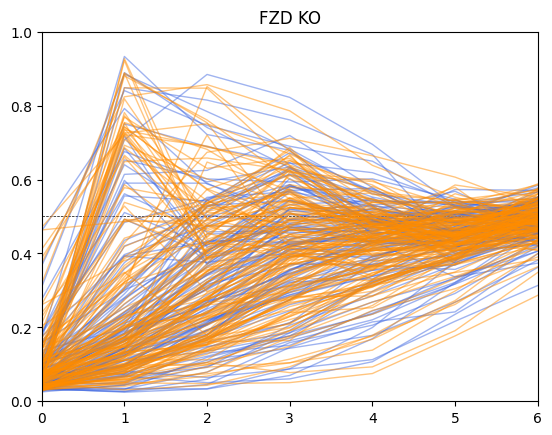

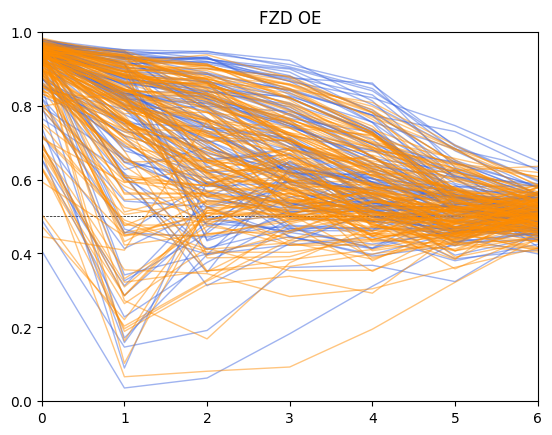

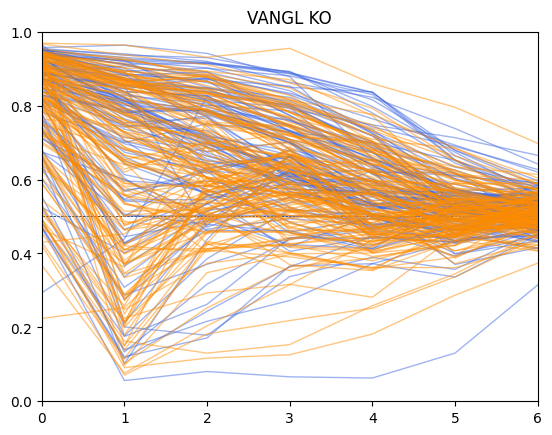

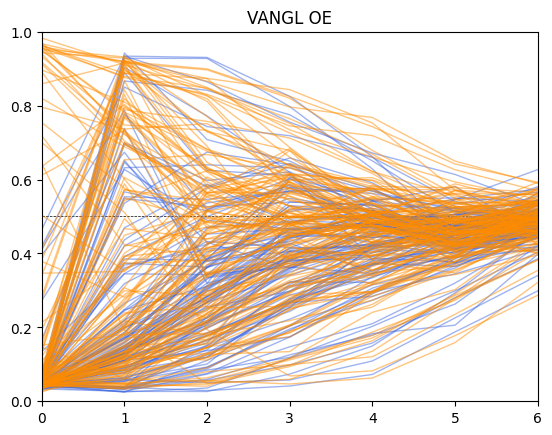

In [5]:
# SCORE AND FILTER
null_fko_scores = null_fko_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)
test_fko_scores = test_fko_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)

null_foe_scores = null_foe_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)
test_foe_scores = test_foe_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)

null_vko_scores = null_vko_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)
test_vko_scores = test_vko_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)

null_voe_scores = null_voe_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)
test_voe_scores = test_voe_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)


# FZD KO
plt.figure(dpi=100)
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=0.5)
plt.plot(null_fko_scores[2:,null_gradient_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot(test_fko_scores[2:,test_gradient_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.title('FZD KO')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()


# FZD OE
plt.figure(dpi=100)
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=0.5)
plt.plot(null_foe_scores[2:,null_gradient_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot(test_foe_scores[2:,test_gradient_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.title('FZD OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()


# VANGL KO
plt.figure(dpi=100)
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=0.5)
plt.plot(null_vko_scores[2:,null_gradient_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot(test_vko_scores[2:,test_gradient_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.title('VANGL KO')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

# VANGL KO
plt.figure(dpi=100)
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=0.5)
plt.plot(null_voe_scores[2:,null_gradient_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot(test_voe_scores[2:,test_gradient_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.title('VANGL OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

# Fig 5C,E,G - Domina Ring Scoring

## FZD KO

51
72


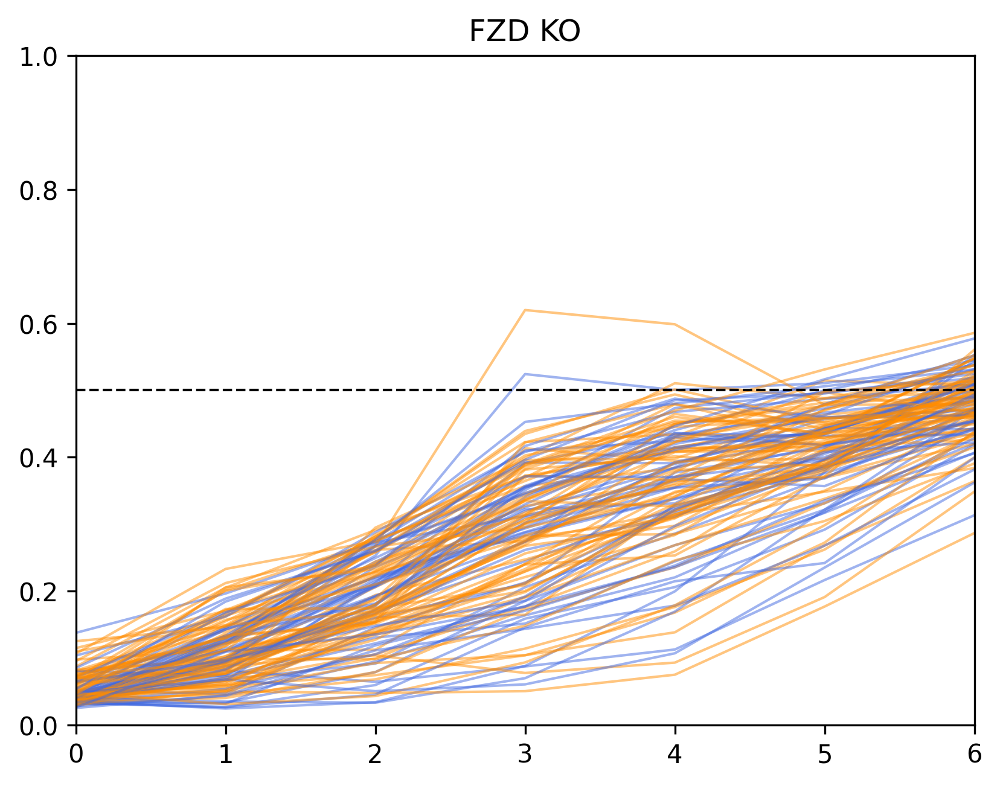

In [14]:
null_fko_bool = (null_gradient_bool) & (((null_fko_scores[2:5]>0.7).all(axis=0)) | ((null_fko_scores[2:5]<0.3).all(axis=0)))
test_fko_bool = (test_gradient_bool) & (((test_fko_scores[2:5]>0.7).all(axis=0)) | ((test_fko_scores[2:5]<0.3).all(axis=0)))

print(null_fko_bool.sum())
print(test_fko_bool.sum())


order = np.random.default_rng(4573648).permutation(null_fko_bool.sum()+test_fko_bool.sum())
color_array = np.concatenate([np.full(null_fko_bool.sum(), 'royalblue'), np.full(test_fko_bool.sum(), 'darkorange')])[order]
data_array = np.concatenate([null_fko_scores[2:,null_fko_bool], test_fko_scores[2:,test_fko_bool]], axis=-1)[:,order]

plt.figure(dpi=300)
for i in range(len(color_array)):
    plt.plot(data_array[:,i], linewidth=1, alpha=0.5, color=color_array[i])
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('FZD KO')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

## FZD OE

64
72


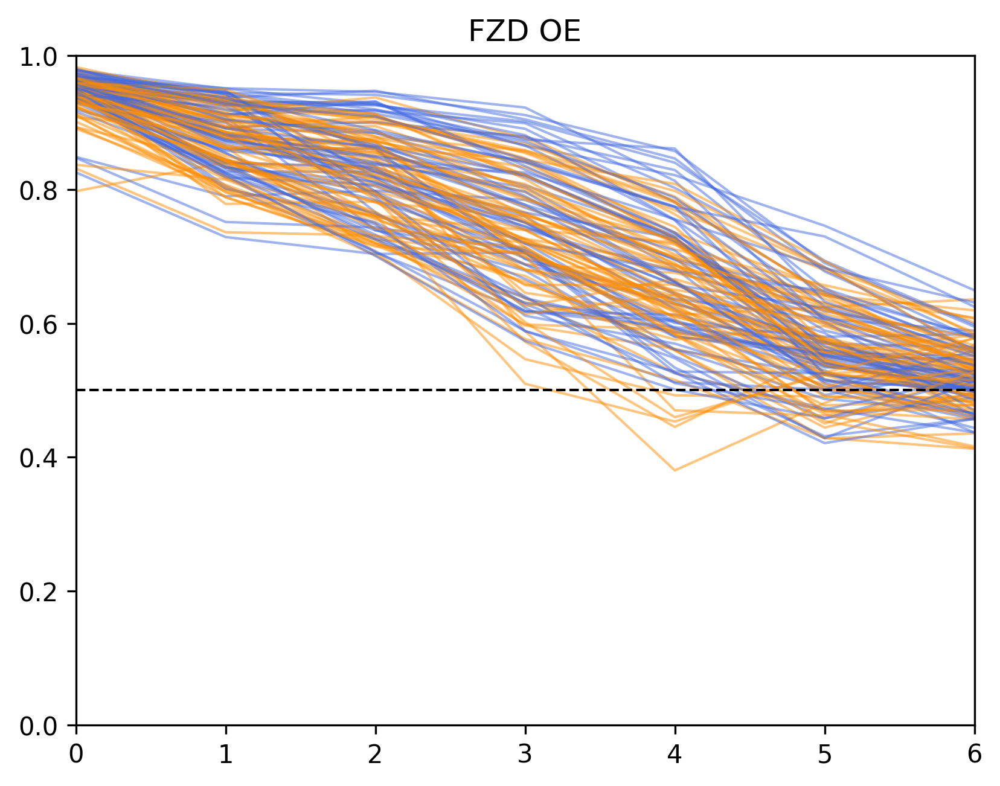

In [17]:
null_foe_bool = (null_gradient_bool) & (((null_foe_scores[2:5]>0.7).all(axis=0)) | ((null_foe_scores[2:5]<0.3).all(axis=0)))
test_foe_bool = (test_gradient_bool) & (((test_foe_scores[2:5]>0.7).all(axis=0)) | ((test_foe_scores[2:5]<0.3).all(axis=0)))

print(null_foe_bool.sum())
print(test_foe_bool.sum())


order = np.random.default_rng(4573648).permutation(null_foe_bool.sum()+test_foe_bool.sum())
color_array = np.concatenate([np.full(null_foe_bool.sum(), 'royalblue'), np.full(test_foe_bool.sum(), 'darkorange')])[order]
data_array = np.concatenate([null_foe_scores[2:,null_foe_bool], test_foe_scores[2:,test_foe_bool]], axis=-1)[:,order]

plt.figure(dpi=300)
for i in range(len(color_array)):
    plt.plot(data_array[:,i], linewidth=1, alpha=0.5, color=color_array[i])
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('FZD OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

## VANGL KO

59
56


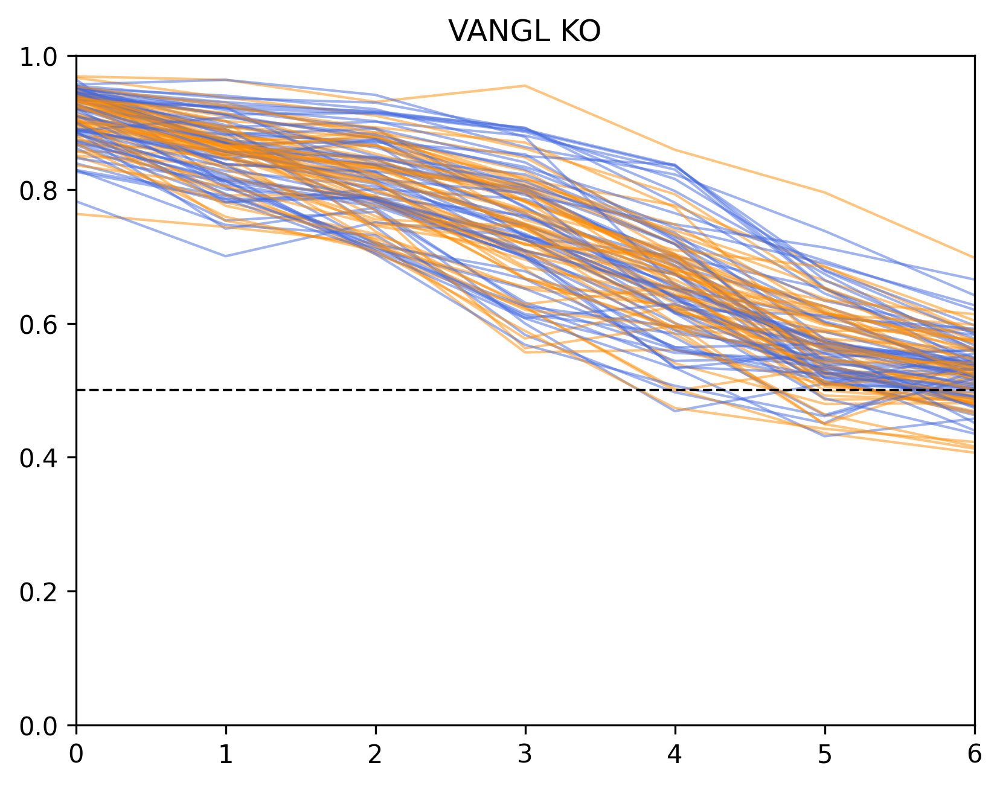

In [20]:
null_vko_bool = (null_gradient_bool) & (((null_vko_scores[2:5]>0.7).all(axis=0)) | ((null_vko_scores[2:5]<0.3).all(axis=0)))
test_vko_bool = (test_gradient_bool) & (((test_vko_scores[2:5]>0.7).all(axis=0)) | ((test_vko_scores[2:5]<0.3).all(axis=0)))

print(null_vko_bool.sum())
print(test_vko_bool.sum())


order = np.random.default_rng(4573648).permutation(null_vko_bool.sum()+test_vko_bool.sum())
color_array = np.concatenate([np.full(null_vko_bool.sum(), 'royalblue'), np.full(test_vko_bool.sum(), 'darkorange')])[order]
data_array = np.concatenate([null_vko_scores[2:,null_vko_bool], test_vko_scores[2:,test_vko_bool]], axis=-1)[:,order]

plt.figure(dpi=300)
for i in range(len(color_array)):
    plt.plot(data_array[:,i], linewidth=1, alpha=0.5, color=color_array[i])
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('VANGL KO')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

## VANGL OE

56
68


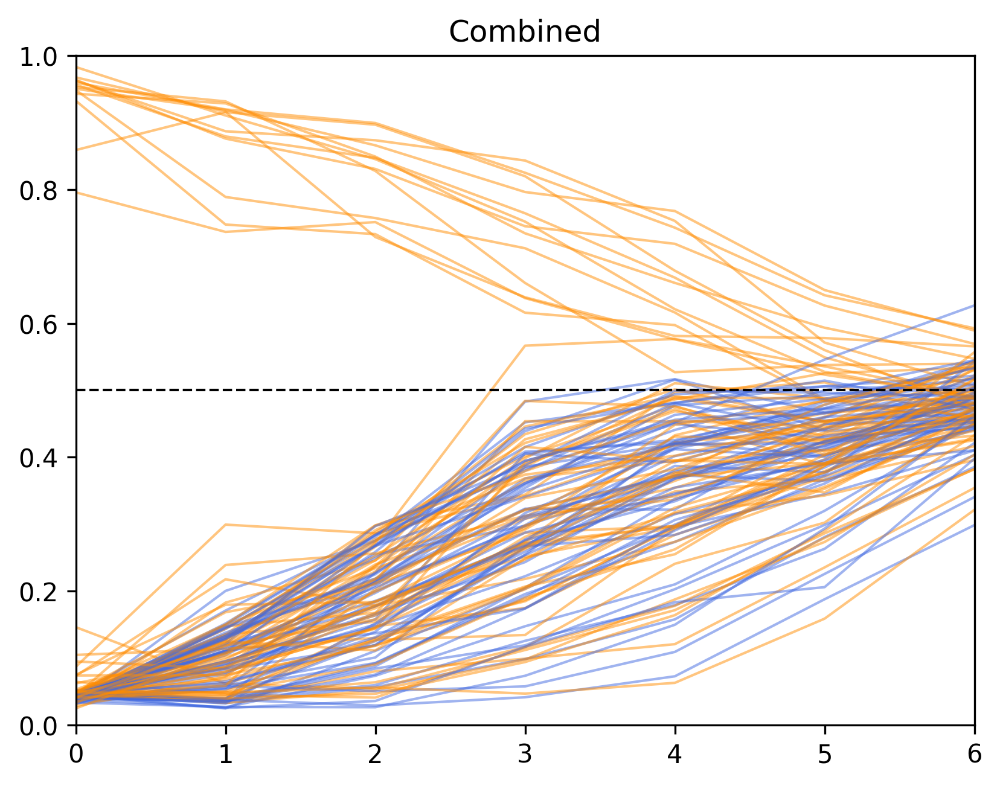

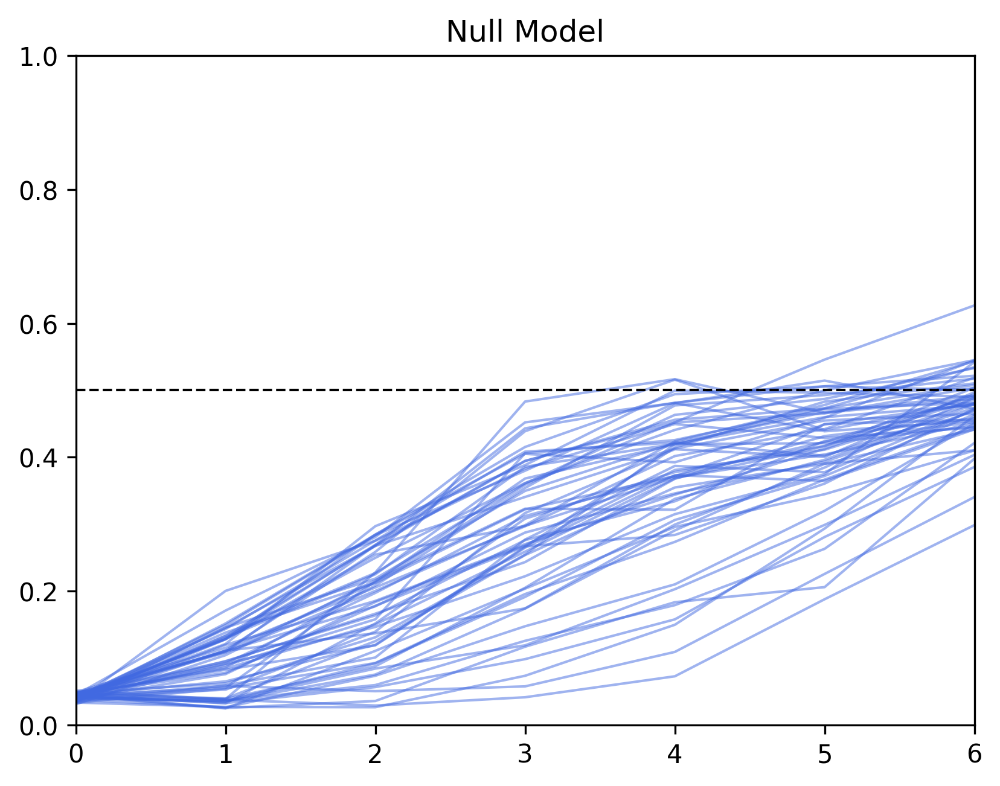

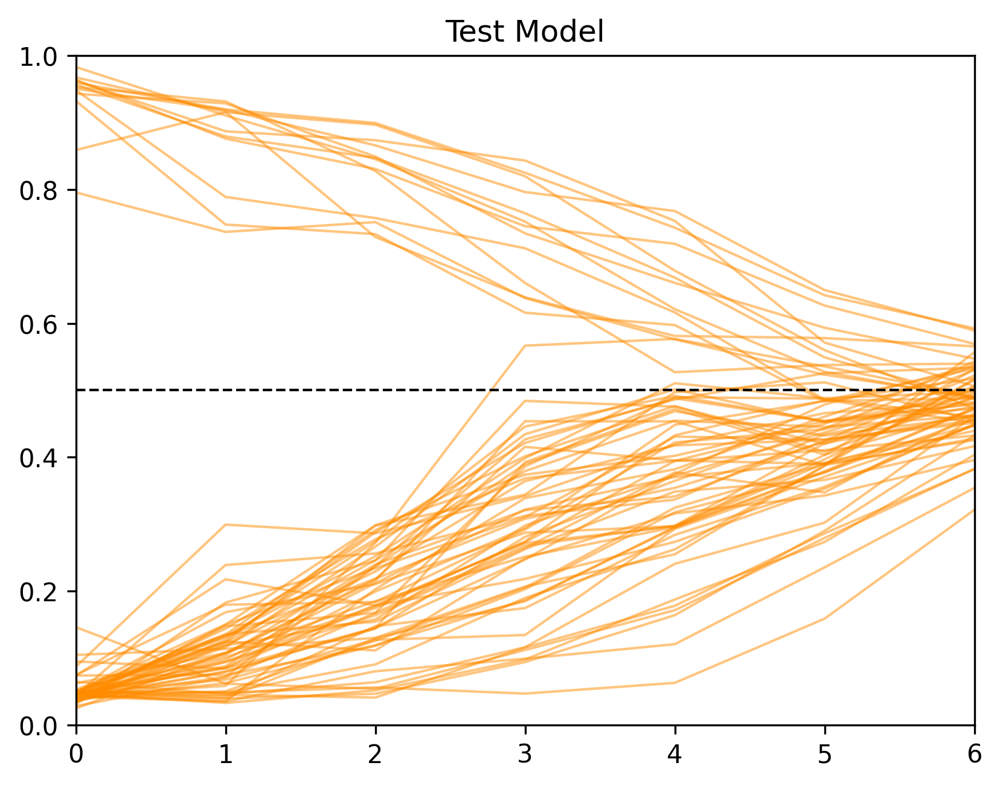

In [38]:
null_voe_bool = (null_gradient_bool) & (((null_voe_scores[2:5]>0.7).all(axis=0)) | ((null_voe_scores[2:5]<0.3).all(axis=0)))
test_voe_bool = (test_gradient_bool) & (((test_voe_scores[2:5]>0.7).all(axis=0)) | ((test_voe_scores[2:5]<0.3).all(axis=0)))

print(null_voe_bool.sum())
print(test_voe_bool.sum())


order = np.random.default_rng(4573648).permutation(null_voe_bool.sum()+test_voe_bool.sum())
color_array = np.concatenate([np.full(null_voe_bool.sum(), 'royalblue'), np.full(test_voe_bool.sum(), 'darkorange')])[order]
data_array = np.concatenate([null_voe_scores[2:,null_voe_bool], test_voe_scores[2:,test_voe_bool]], axis=-1)[:,order]

plt.figure(dpi=300)
for i in range(len(color_array)):
    plt.plot(data_array[:,i], linewidth=1, alpha=0.5, color=color_array[i])
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('Combined')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

plt.figure(dpi=300)
plt.plot(null_voe_scores[2:,null_voe_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('Null Model')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

plt.figure(dpi=300)
plt.plot(test_voe_scores[2:,test_voe_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('Test Model')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

# Fig 5D - Example Images

## FZD KO

  0%|          | 0/887 [00:00<?, ?it/s]

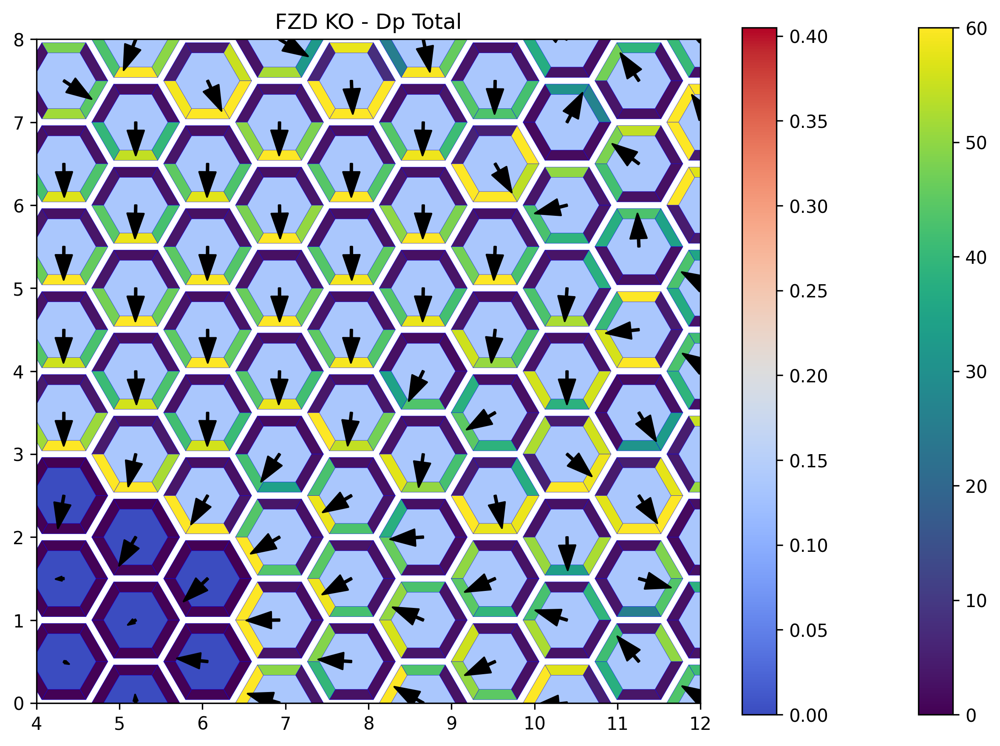

In [122]:
test_fko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\FZD_KO')
fko_params = test_fko_results.get_all_params()

fko_psets = np.where(test_fko_bool)[0]
pset_to_plot = 1
basal_value = fko_params[sF, fko_psets[pset_to_plot]]

test_fko_results.draw(species_dict['Dp_total'], model=fko_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sF', colorbar=True, cyto_colorbar=True, normalize=(0,60), cyto_normalize=(0,basal_value*3), dpi=300)
plt.title('FZD KO - Dp Total')
plt.show()

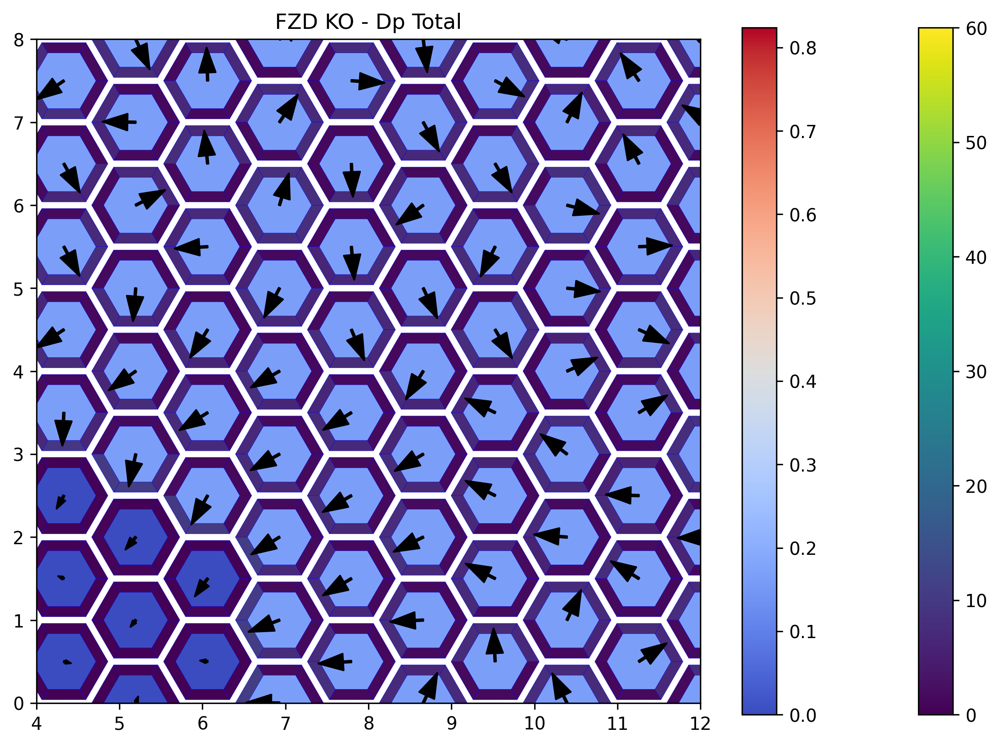

In [121]:
test_fko_results.draw(species_dict['Dp_total'], model=fko_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sF', colorbar=True, cyto_colorbar=True, normalize=(0,60), cyto_normalize=(0,basal_value*5), dpi=300)
plt.title('FZD KO - Dp Total')
plt.show()

## FZD OE

  0%|          | 0/887 [00:00<?, ?it/s]

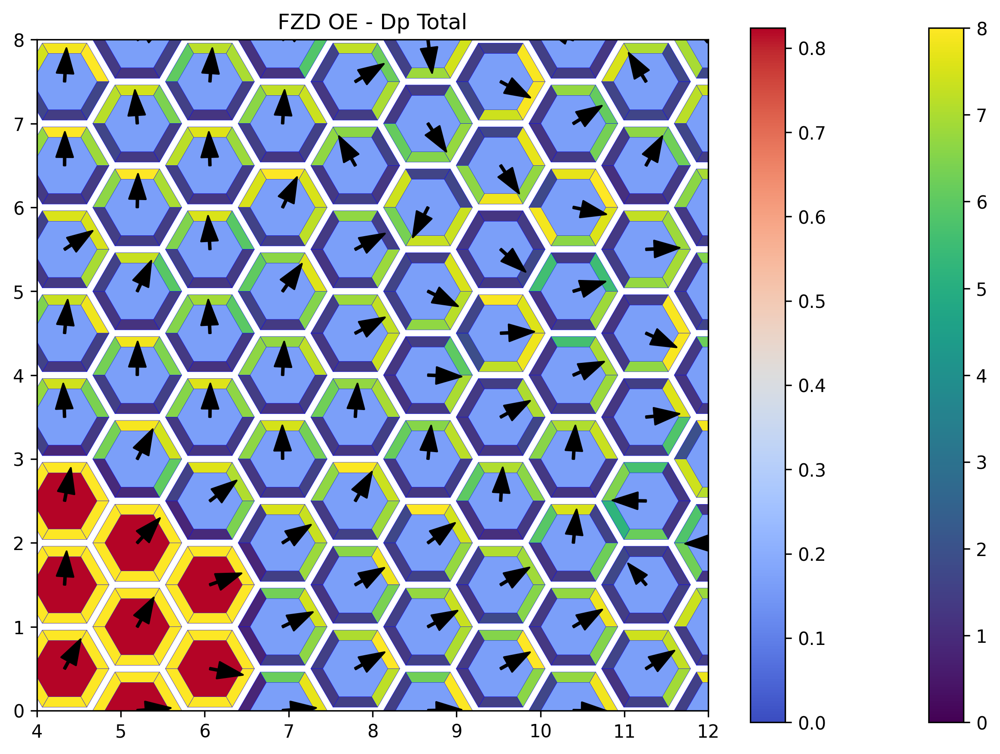

In [120]:
test_foe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\FZD_OE')
foe_params = test_foe_results.get_all_params()

foe_psets = np.where(test_foe_bool)[0]
pset_to_plot = 2
basal_value = foe_params[sF, foe_psets[pset_to_plot]]

test_foe_results.draw(species_dict['Dp_total'], model=foe_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sF', colorbar=True, cyto_colorbar=True, normalize=(0,8), cyto_normalize=(0,basal_value*5), dpi=300)
plt.title('FZD OE - Dp Total')
plt.show()

## VANGL KO

  0%|          | 0/887 [00:00<?, ?it/s]

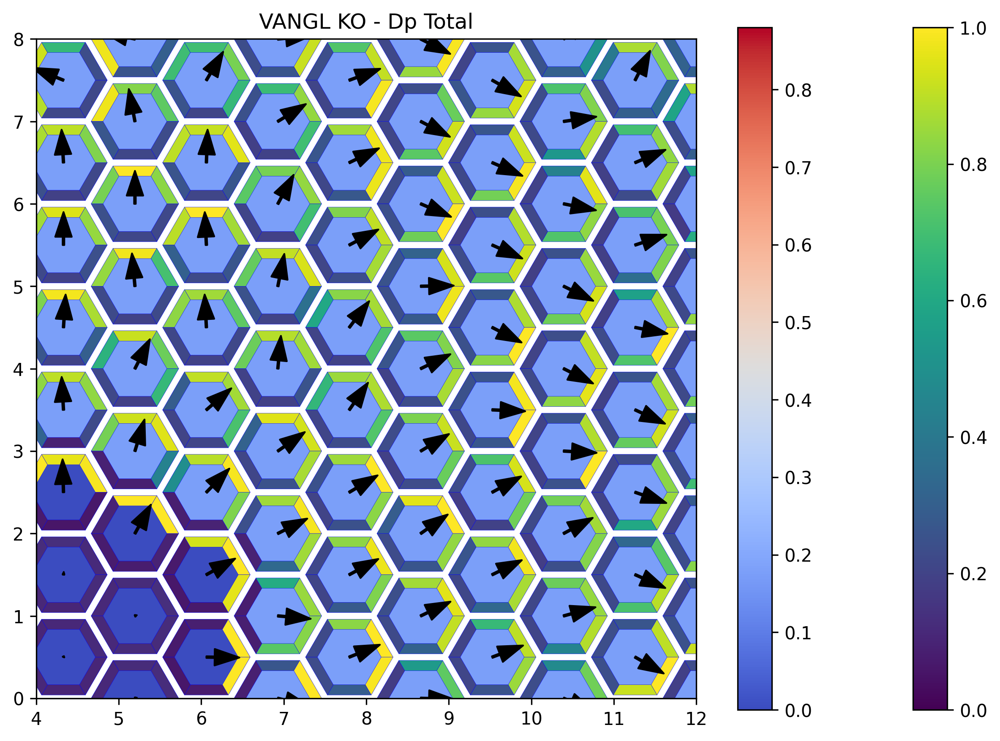

In [123]:
test_vko_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\VANGL_KO')
vko_params = test_vko_results.get_all_params()

vko_psets = np.where(test_vko_bool)[0]
pset_to_plot = 5
basal_value = vko_params[sV, vko_psets[pset_to_plot]]

test_vko_results.draw(species_dict['Dp_total'], model=vko_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sV', colorbar=True, cyto_colorbar=True, normalize=(0,1), cyto_normalize=(0,basal_value*5), dpi=300)
plt.title('VANGL KO - Dp Total')
plt.show()

# Fig 5F,H - VANGL OE Example images

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

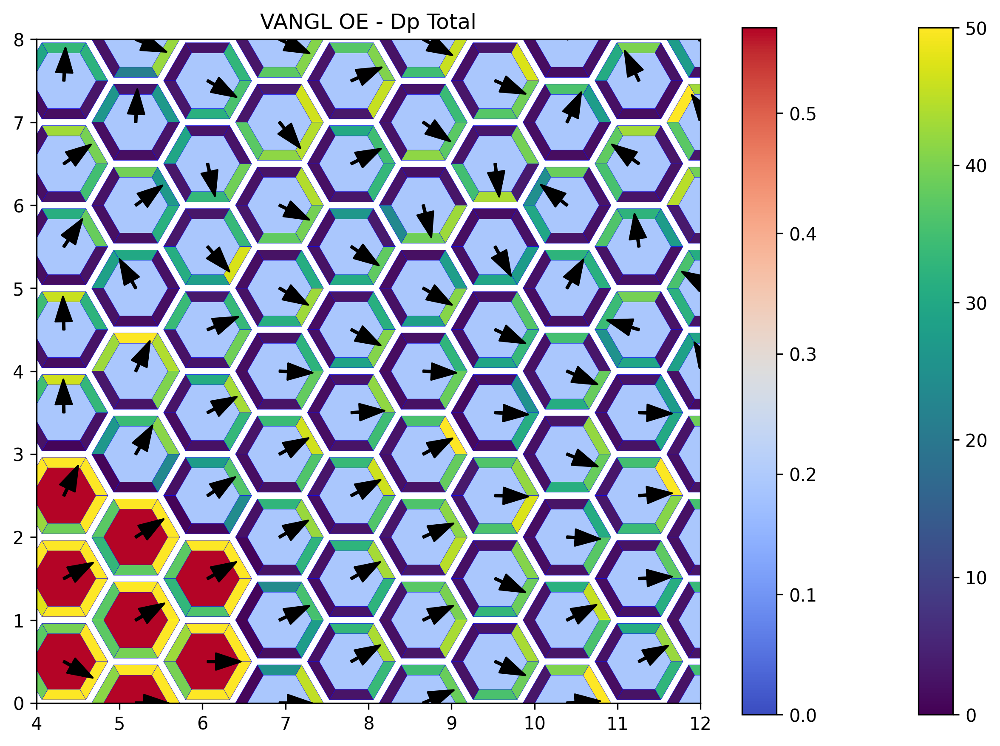

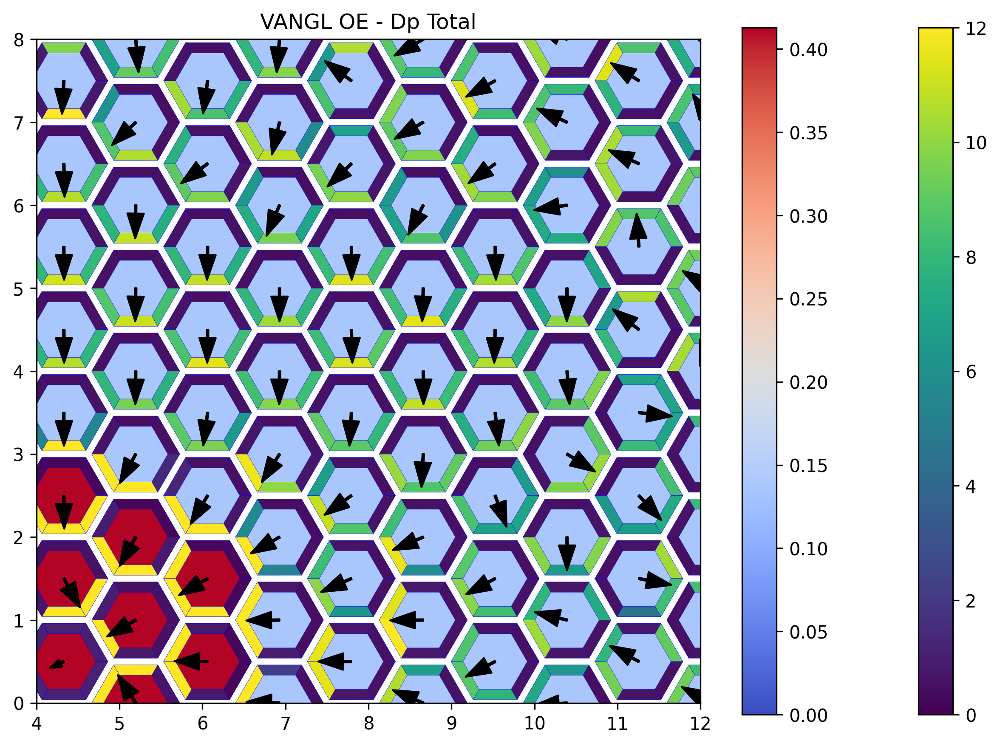

In [131]:
test_voe_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\VANGL_OE')
test_voe_scores = test_voe_results.ring_score(species_dict['F_complex'], ref_cell=5, rings=9)

voe_params = test_voe_results.get_all_params()
voe_psets = np.where(test_voe_bool)[0]

pset_to_plot = 1
basal_value = voe_params[sV, voe_psets[pset_to_plot]]
test_voe_results.draw(species_dict['Dp_total'], model=voe_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sV', 
                      colorbar=True, cyto_colorbar=True, normalize=(0,50), cyto_normalize=(0,basal_value*3), dpi=300)
plt.title('VANGL OE - Dp Total')
plt.show()

pset_to_plot = 8
basal_value = voe_params[sV, voe_psets[pset_to_plot]]
test_voe_results.draw(species_dict['Dp_total'], model=voe_psets[pset_to_plot], xlim=(4,12), ylim=(0,8), cyto_param='sV', 
                      colorbar=True, cyto_colorbar=True, normalize=(0,12), cyto_normalize=(0,basal_value*3), dpi=300)
plt.title('VANGL OE - Dp Total')
plt.show()

# Fig 5I - Plot significant VANGL-OE params

  0%|          | 0/887 [00:00<?, ?it/s]

(76, 13)
(76, 55)


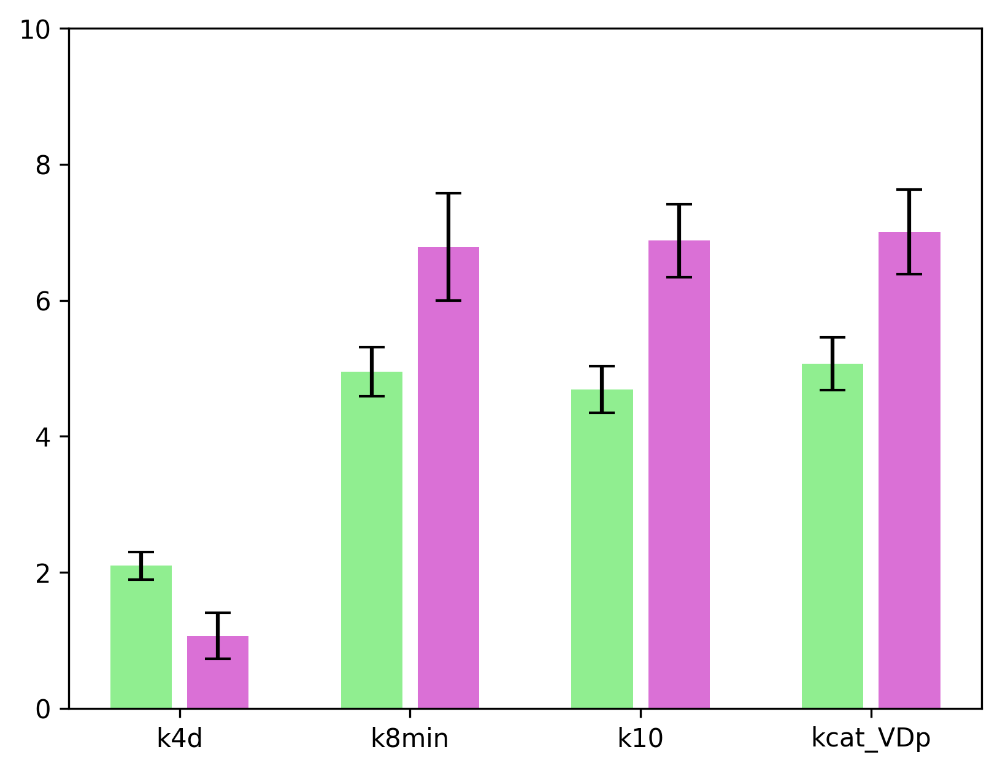

In [7]:
test_params = test_voe_results.get_all_params()

test_voe_distal_bool = (test_gradient_bool) & ((test_voe_scores[2:5]>0.7).all(axis=0))
test_voe_proximal_bool = (test_gradient_bool) & ((test_voe_scores[2:5]<0.3).all(axis=0))

test_voe_distal_params = test_params[:,test_voe_distal_bool]
test_voe_proximal_params = test_params[:,test_voe_proximal_bool]

print(test_voe_distal_params.shape)
print(test_voe_proximal_params.shape)


plt.figure(dpi=300)
heights, yerrs = [], []
for param in ['k4d','k8min','k10','kcat_VDp']:
    i = Xp_params.index(param)
    pval = ranksums(test_voe_distal_params[i], test_voe_proximal_params[i]).pvalue

    heights.append(test_voe_proximal_params[i].mean())
    heights.append(test_voe_distal_params[i].mean())
    
    yerrs.append(np.std(test_voe_proximal_params[i])/np.sqrt(len(test_voe_proximal_params[i])))
    yerrs.append(np.std(test_voe_distal_params[i])/np.sqrt(len(test_voe_distal_params[i])))
    
plt.bar([1,2,4,5,7,8,10,11], height=heights, yerr=yerrs, capsize=5, color=['lightgreen','orchid'])
plt.xticks([1.5,4.5,7.5,10.5], ['k4d','k8min','k10','kcat_VDp'])
plt.ylim(0,10)
plt.show()

# Try stuff

In [138]:
print(  )

13


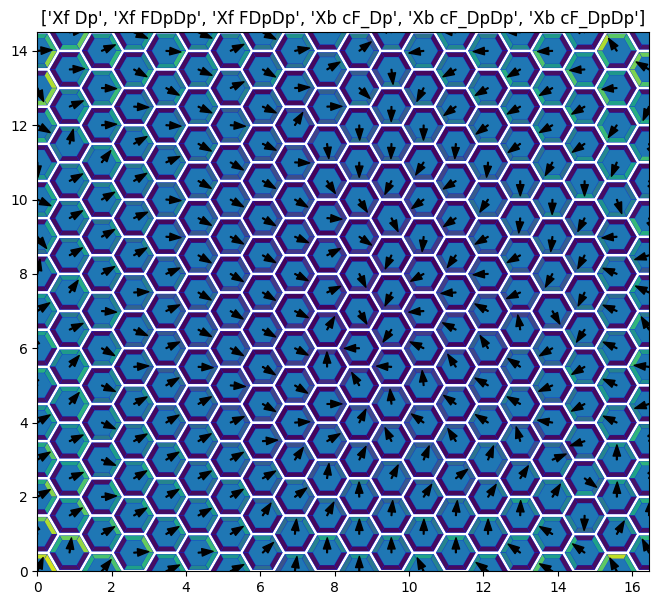

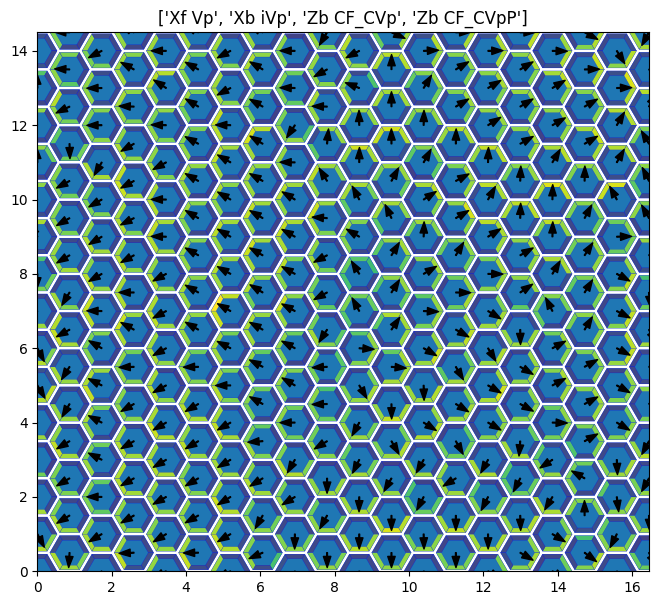

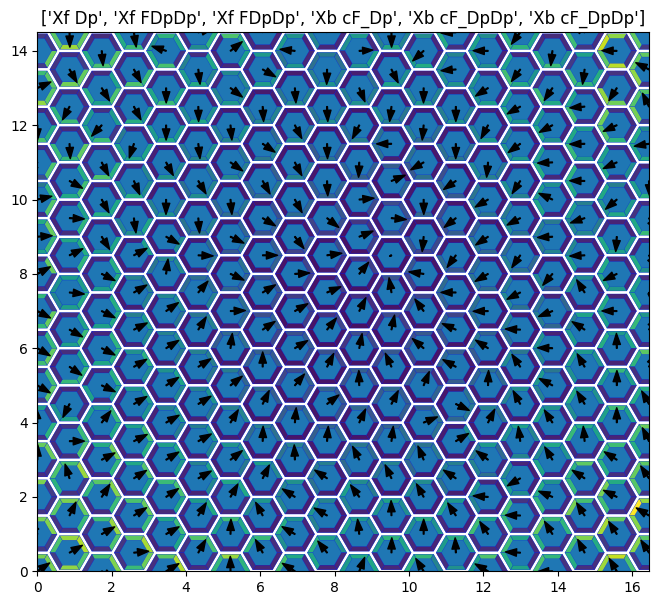

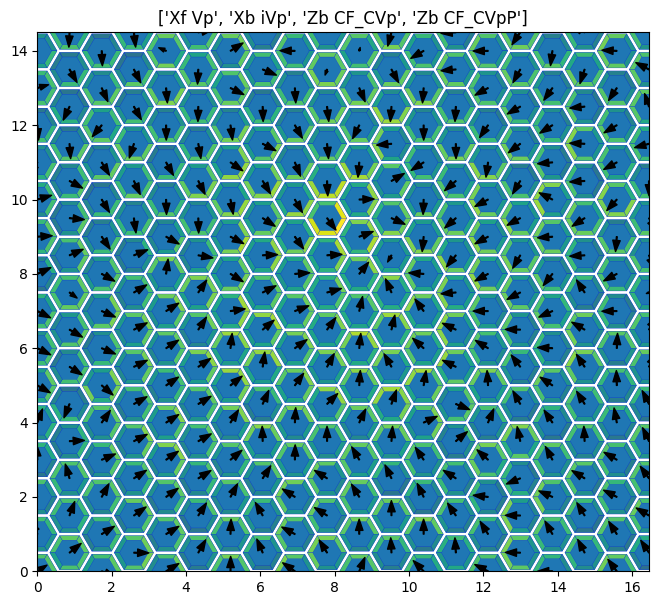

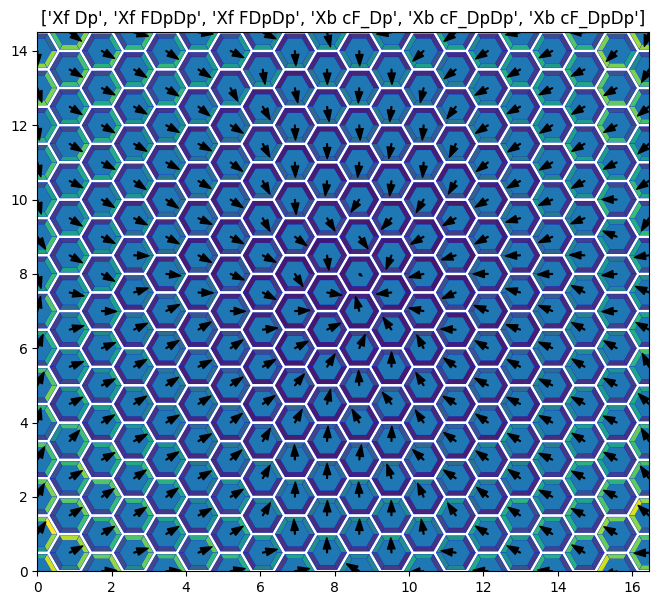

...

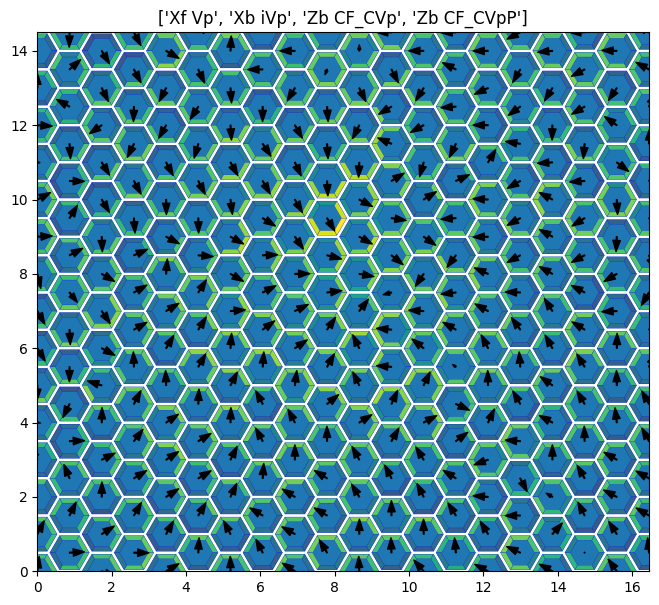

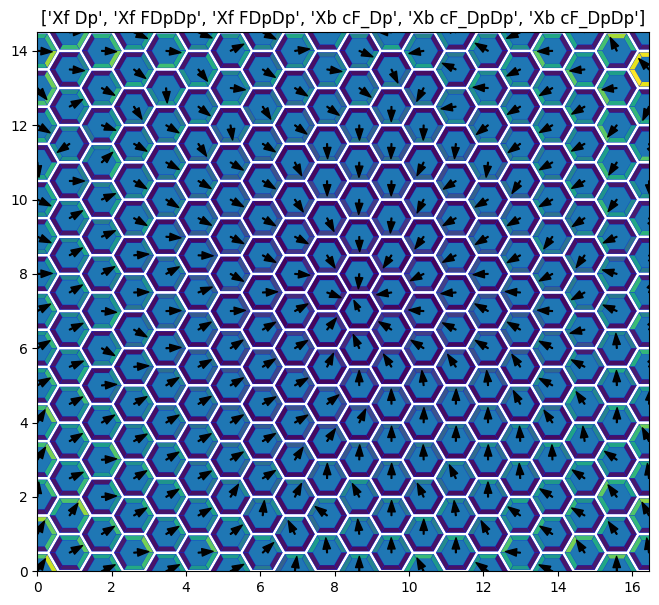

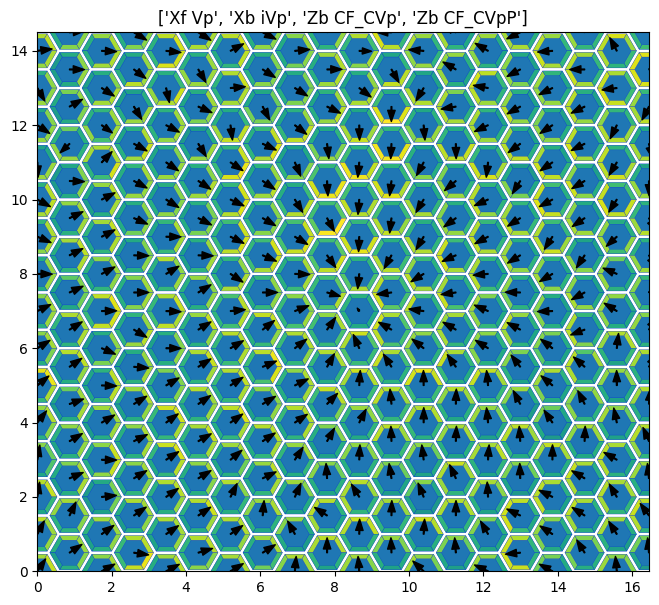

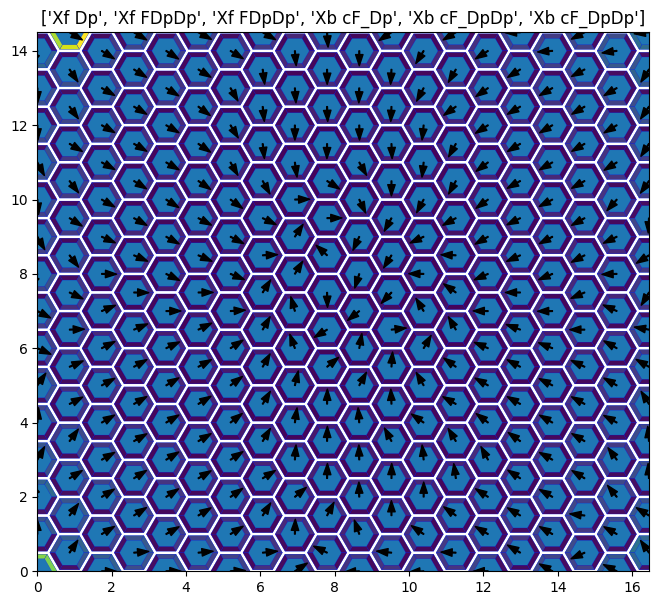

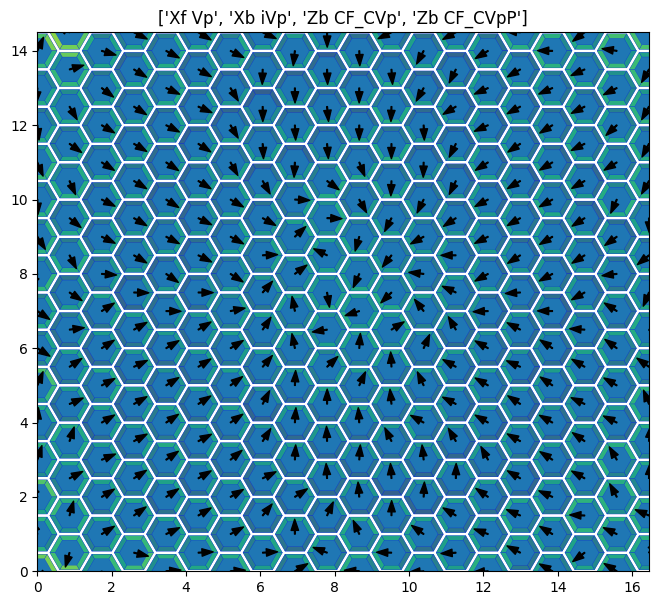

In [143]:
test_gradient_results = ChunkedResults_2d('D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina\\test_results\\Gradient')

foo_bool = ((test_voe_scores[2:5]>0.7).all(axis=0) & test_gradient_bool)
foo_psets = np.where(foo_bool)[0]

for pset in foo_psets:
    test_gradient_results.draw(species_dict['Dp_total'], model=pset)
    plt.show()
    test_gradient_results.draw(species_dict['Vp_total'], model=pset)
    plt.show()
    print('\n\n')

# Supp Fig X - Combined domina response

## Quantify num correct domina responses

In [34]:
null_combined = null_fko_bool.astype(int) + null_foe_bool.astype(int) + null_vko_bool.astype(int) + null_voe_bool.astype(int)
test_combined = test_fko_bool.astype(int) + test_foe_bool.astype(int) + test_vko_bool.astype(int) + test_voe_bool.astype(int)

vals_1, counts_1 = np.unique(null_combined, return_counts=True)
vals_2, counts_2 = np.unique(test_combined, return_counts=True)

for i in range(5):
    index_1 = np.where(vals_1==i)
    index_2 = np.where(vals_2==i)

    count_1 = counts_1[index_1]
    count_2 = counts_2[index_2]

    print(f'{i} correct:')
    print(f'Null - {count_1}')
    print(f'Test - {count_2}')
    print()

null_all_correct_bool = (null_combined==4)
test_all_correct_bool = (test_combined==4)

0 correct:
Null - [817]
Test - [792]

1 correct:
Null - [17]
Test - [19]

2 correct:
Null - [9]
Test - [15]

3 correct:
Null - [20]
Test - [25]

4 correct:
Null - [37]
Test - [36]



## Plot VANGL-OE response of psets that pass all tests

37
36


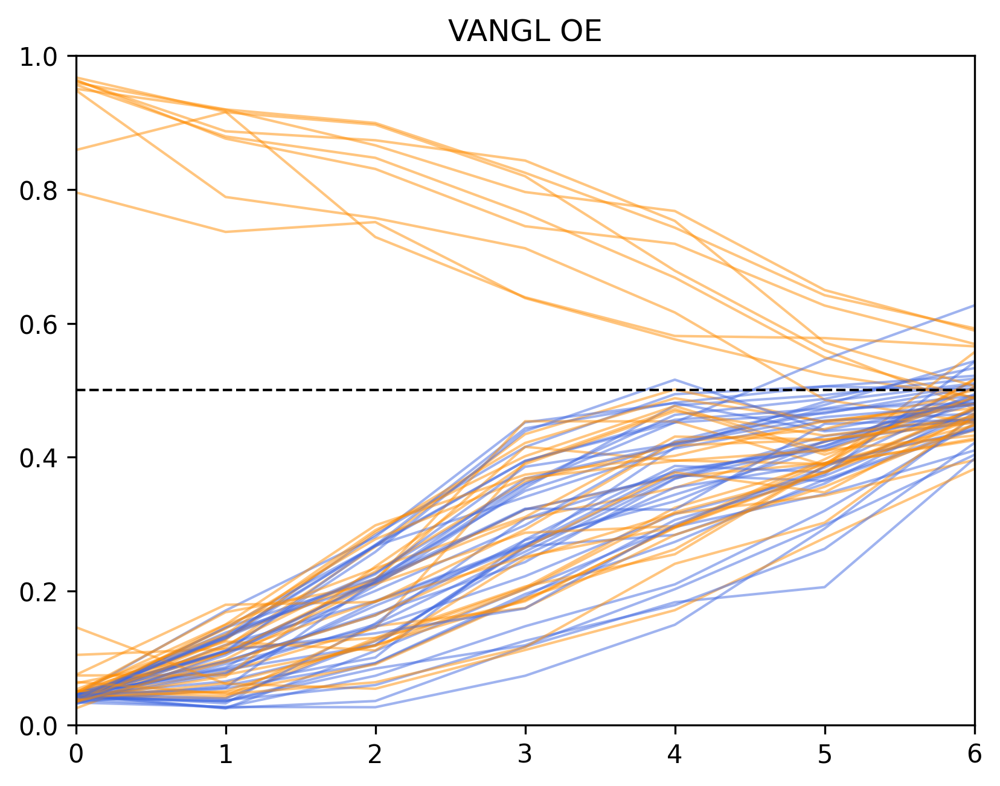

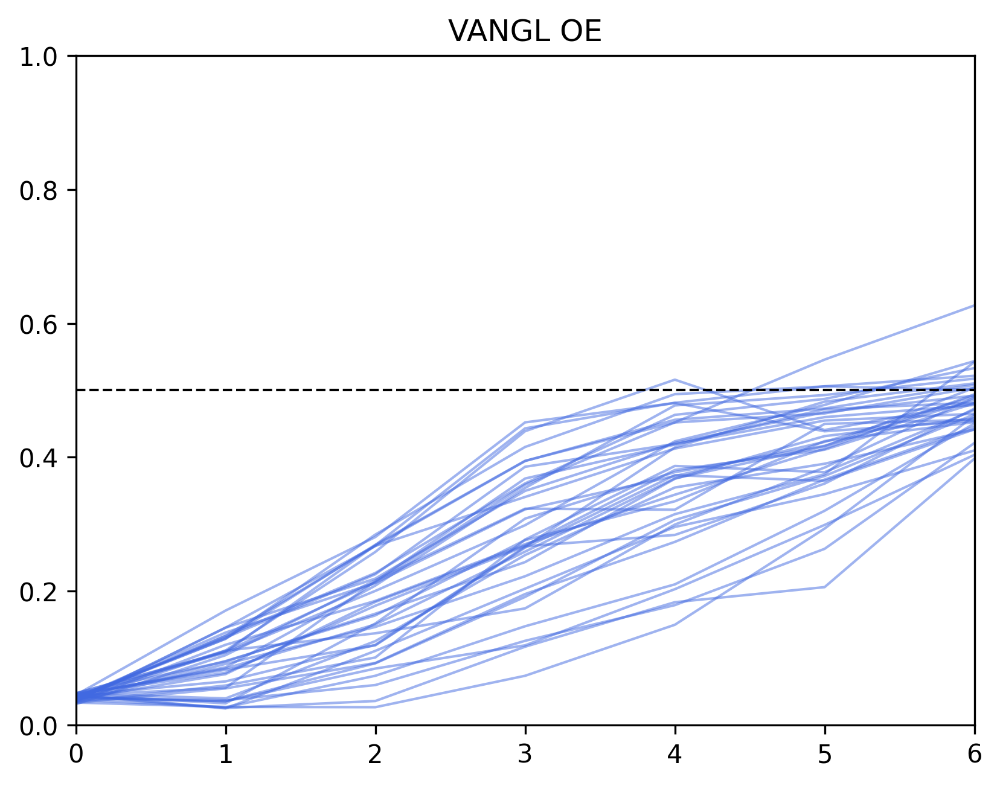

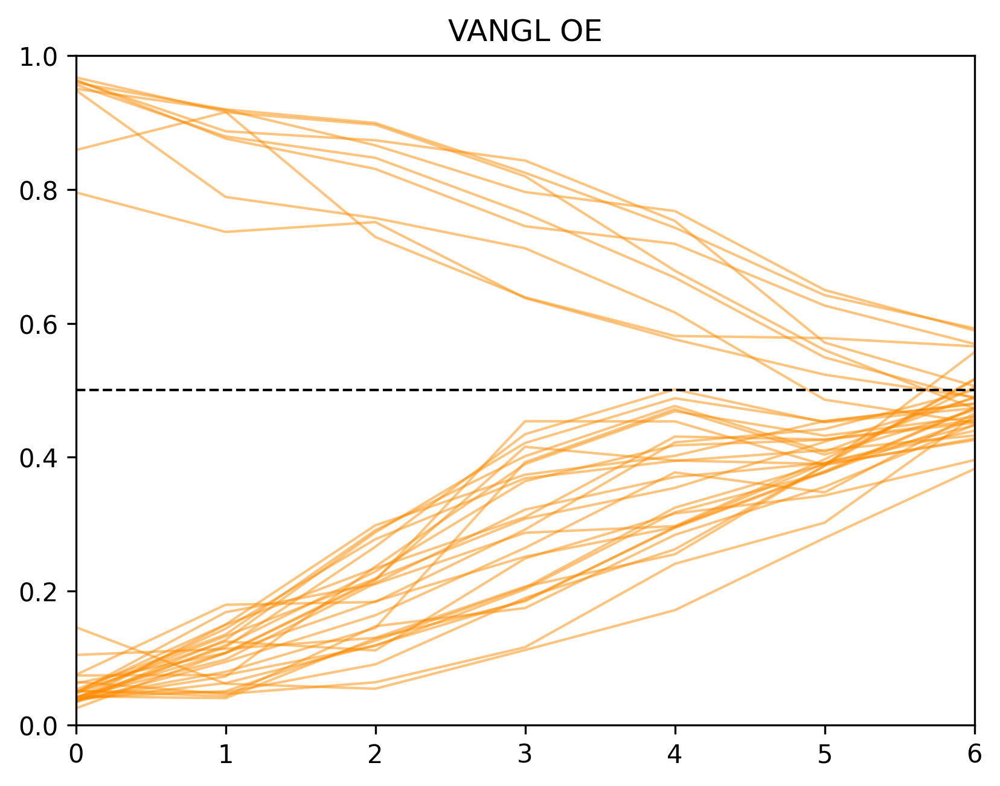

In [36]:
null_voe_bool = null_all_correct_bool
test_voe_bool = test_all_correct_bool

print(null_voe_bool.sum())
print(test_voe_bool.sum())


order = np.random.default_rng(4573648).permutation(null_voe_bool.sum()+test_voe_bool.sum())
color_array = np.concatenate([np.full(null_voe_bool.sum(), 'royalblue'), np.full(test_voe_bool.sum(), 'darkorange')])[order]
data_array = np.concatenate([null_voe_scores[2:,null_voe_bool], test_voe_scores[2:,test_voe_bool]], axis=-1)[:,order]

plt.figure(dpi=300)
for i in range(len(color_array)):
    plt.plot(data_array[:,i], linewidth=1, alpha=0.5, color=color_array[i])
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('VANGL OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

plt.figure(dpi=300)
plt.plot(null_voe_scores[2:,null_voe_bool], linewidth=1, alpha=0.5, color='royalblue')
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('VANGL OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

plt.figure(dpi=300)
plt.plot(test_voe_scores[2:,test_voe_bool], linewidth=1, alpha=0.5, color='darkorange')
plt.plot([0,7], [0.5,0.5], 'k--', linewidth=1)
plt.title('VANGL OE')
plt.xlim(0,6)
plt.ylim(0,1)
plt.show()

## Quantify num correct without excluding gradient

In [251]:
expt_path = 'D:\\Modeling\\2025-05-23_2d-Mixed-Gradient-Domina'
expts = ['VANGL_OE', 'VANGL_KO', 'FZD_OE', 'FZD_KO']

null_pass, test_pass = [], []
for expt in expts:
    null_results = ChunkedResults_2d(os.path.join(expt_path, 'null_results', expt))
    null_scores = null_results.score_domina(species_dict['F_complex'], ref_cell=5, rings=8)
    null_pass.append((null_scores[2:5]>0.7).all(axis=0) | (null_scores[2:5]<0.3).all(axis=0))
    
    test_results = ChunkedResults_2d(os.path.join(expt_path, 'test_results', expt))
    test_scores = test_results.score_domina(species_dict['F_complex'], ref_cell=5, rings=8)
    test_pass.append((test_scores[2:5]>0.7).all(axis=0) | (test_scores[2:5]<0.3).all(axis=0))
    print()

null_pass_counts = np.stack(null_pass).sum(axis=0)
test_pass_counts = np.stack(test_pass).sum(axis=0)

null_values, null_counts = np.unique(null_pass_counts, return_counts=True)
test_values, test_counts = np.unique(test_pass_counts, return_counts=True)

print('Null Model')
for i in range(len(null_values)):
    print(f'{null_values[i]} correct phenotypes - {null_counts[i]}')
print()

print('Test Model')
for i in range(len(test_values)):
    print(f'{test_values[i]} correct phenotypes - {test_counts[i]}')
print()

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

  0%|          | 0/887 [00:00<?, ?it/s]


Null Model
0 correct phenotypes - 321
1 correct phenotypes - 91
2 correct phenotypes - 196
3 correct phenotypes - 79
4 correct phenotypes - 213

Test Model
0 correct phenotypes - 300
1 correct phenotypes - 92
2 correct phenotypes - 188
3 correct phenotypes - 103
4 correct phenotypes - 204



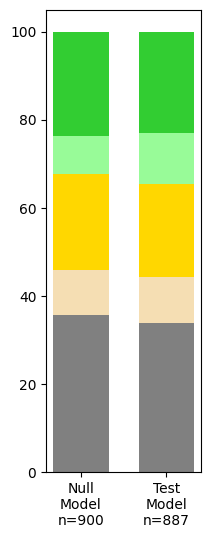

In [256]:
plt.figure(dpi=100, figsize=(2,6))

plt.bar([1,2], height=100, width=0.65, color='limegreen')
plt.bar([1,2], height=[76.3,77.0], width=0.65, color='palegreen')
plt.bar([1,2], height=[67.6,65.4], width=0.65, color='gold')
plt.bar([1,2], height=[45.8,44.2], width=0.65, color='wheat')
plt.bar([1,2], height=[35.7,33.8], width=0.65, color='grey')
plt.xticks([1,2],['Null\nModel\nn=900', 'Test\nModel\nn=887'])
plt.show()